# Multimodal Modeling Explorations

In [51]:
import csv, os, sys, re, string, json, glob, shutil, random, datetime, math
from tqdm import tqdm

import cv2
import pandas as pd
import numpy as np

from IPython.display import HTML as html_print
from IPython.display import Markdown
from IPython.display import clear_output

# from IPython.display import Image
from PIL import Image, ImageDraw, ImageFont
from ipywidgets import Video

import torch
from transformers import AutoTokenizer
import nltk
from nltk.tokenize import word_tokenize, sent_tokenize

import warnings
warnings.filterwarnings('ignore')

import seaborn as sns
sns.set()
from matplotlib import pyplot as plt
import matplotlib.patches as patches
%pylab inline

# for auto-reloading external modules
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2

%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib
The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
sys.path.insert(0, "../all_visualizations")
sys.path.insert(0, "../data_processing")

from visualization_utils import *
from sequencing_utils import show_one_sampled_data as show_one_sampled_data_wikihow
from sequencing_data_processors import WikiHowGeneralProcessor

## Declare Multimodal Modelings

In [3]:
from lavis.models import model_zoo
from lavis.models import load_model_and_preprocess

print(model_zoo)

Architectures                  Types
albef_classification           ve
albef_feature_extractor        base
albef_nlvr                     nlvr
albef_pretrain                 base
albef_retrieval                coco, flickr
albef_vqa                      vqav2
alpro_qa                       msrvtt, msvd
alpro_retrieval                msrvtt, didemo
blip_caption                   base_coco, large_coco
blip_classification            base
blip_feature_extractor         base
blip_image_text_matching       base, large
blip_nlvr                      nlvr
blip_pretrain                  base
blip_retrieval                 coco, flickr
blip_vqa                       vqav2, okvqa, aokvqa
blip2_opt                      pretrain_opt2.7b, pretrain_opt6.7b, caption_coco_opt2.7b, caption_coco_opt6.7b
blip2_t5                       pretrain_flant5xl, pretrain_flant5xxl, caption_coco_flant5xl
blip2                          pretrain, coco
pnp_vqa                        base, large, 3b
pnp_unifiedqav2_fid

### Captioning Model

In [4]:
# CPU device for the try-outs.
device = torch.device("cpu")

model, vis_processors, _ = load_model_and_preprocess(
    name="blip_caption",
    model_type="base_coco",
    is_eval=True,
    device=device
)

## Various Datasets

Below let us try some of our datasets in hand for the multimodal tools.

### WikiHow Datasets

In [4]:
# version text is the string in between "wikihow" and "train/test/dev.json"
# E.g., "wikihow-acl22_human_multiref_multimodal-test.json"'s version text is:
# "acl22_human_multiref_multimodal"
version_text_to_use = "acl22_human_multiref_multimodal"

data_root_dir = "/local1/telinwu/research/resources/wikihow/"

wikihow_processor = WikiHowGeneralProcessor(
    data_dir=data_root_dir,
    version_text=version_text_to_use,
    paired_with_image=True,
    images_dir=data_root_dir,
    min_story_length=5,
    max_story_length=5,
    save_missing_images_info=False,
)

# data_wikihow_train = wikihow_processor.get_train_examples()
data_wikihow_train = []

# data_wikihow_dev = wikihow_processor.get_dev_examples()
data_wikihow_dev = []

data_wikihow_test = wikihow_processor.get_test_examples()

data_wikihow = data_wikihow_train + data_wikihow_dev + data_wikihow_test
print("Total Valid Data Sequences: {}".format(len(data_wikihow)))

Using /local1/telinwu/research/resources/wikihow/wikihow-acl22_human_multiref_multimodal-test.json


100%|███████████████████████████████████████████████████████████████████████████████| 301/301 [00:00<00:00, 22002.19it/s]

[WARNING] Number of missing images in test: 0
There are 301 valid story sequences in /local1/telinwu/research/resources/wikihow/wikihow-acl22_human_multiref_multimodal-test.json
Total Valid Data Sequences: 301


Data Index: 51
GT Order References: [[1, 2, 3, 4, 5]]
Article URL: https://www.wikihow.com/Clean-Dentures-With-Vinegar


[0, 1, 2, 3, 4]

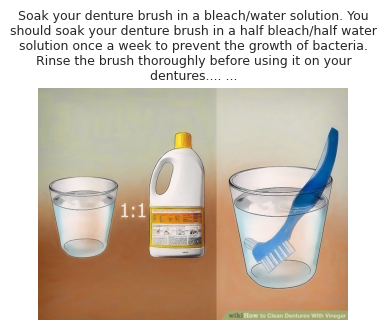

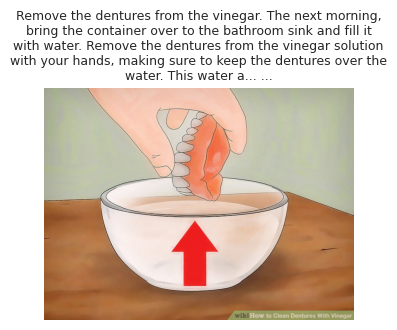

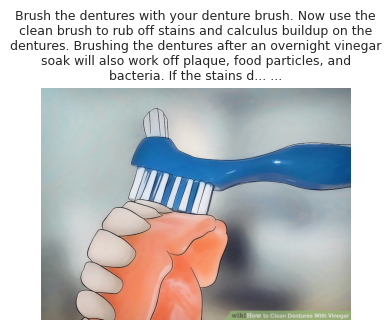

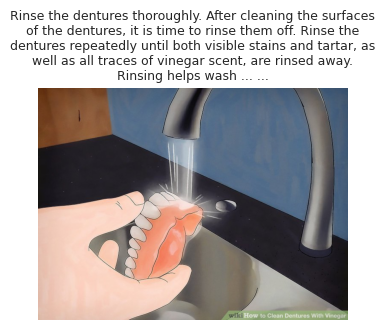

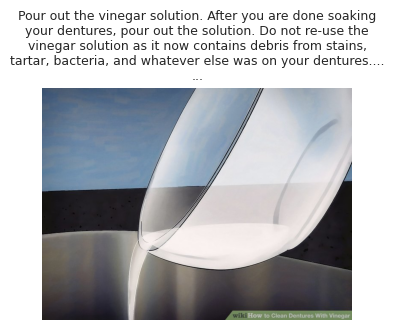

In [5]:
# Randomly select a data point.
rand_idx = np.random.randint(len(data_wikihow))

print("Data Index: {}".format(rand_idx))
print("GT Order References: {}".format(data_wikihow[rand_idx].multiref_gt))

show_one_sampled_data_wikihow(
    data_wikihow[rand_idx], 
    scrambled=False,
    title_max_len=250,
    show_url=True,
    img_size=4,
    font_size=9,
    # unimodal="text",
)

In [6]:
# print("-"*50)
for step_idx in range(len(data_wikihow[rand_idx].text_seq)):
    # print("Step: {}".format(step_idx+1))
    # print(data_wikihow[rand_idx].text_seq[step_idx])
    # print(data_wikihow[rand_idx].img_path_seq[step_idx])
    # print("-"*50)
    pass

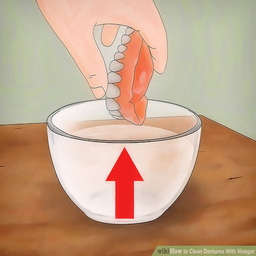

In [9]:
sampled_img_path = np.random.choice(data_wikihow[rand_idx].img_path_seq)
sampled_img = Image.open(sampled_img_path).convert("RGB").resize((256, 256), Image.Resampling.LANCZOS)
display(sampled_img)

In [11]:
image = vis_processors["eval"](sampled_img).unsqueeze(0).to(device)
lavis_caption = model.generate({"image": image})
print(lavis_caption)

['a drawing of a bowl of soup with a red arrow pointing to it']


## Instructables.com Datasets

In [ ]:
# ...

## Ego4D Datasets

In [5]:
# Use annotations to filter out the videos list we want.
annots_root = "/local1/hu528/ego4d_data_old/v1/annotations/"
curr_videos_root = "/local1/jrbronkar/ego4d_videos/v1/full_scale"
curr_videos_root = "/local1/hu528/ego4d_data/v1/full_scale"

all_narrations_file = os.path.join(annots_root, "narration.json")
all_narrations = json.load(open(all_narrations_file))

In [52]:
scod_train_file = "fho_scod_train.json"
scod_train_file = os.path.join(annots_root, scod_train_file)

scod_val_file = "fho_scod_val.json"
scod_val_file = os.path.join(annots_root, scod_val_file)

scod_test_file = "fho_scod_test_unannotated.json"
scod_test_file = os.path.join(annots_root, scod_test_file)

scod_train_data = json.load(open(scod_train_file))
scod_val_data = json.load(open(scod_val_file))
scod_test_data = json.load(open(scod_test_file))

scod_clips = scod_train_data["clips"] + scod_val_data["clips"]
scod_test_clips = scod_test_data["clips"]

downloaded_video_id_and_paths = {
    x.split(".mp4")[0]: os.path.join(curr_videos_root, x)
    for x in os.listdir(curr_videos_root) if ".mp4" in x
}
print("Currently we downloaded {} ego4d videos.".format(len(downloaded_video_id_and_paths)))

downloaded_scod_clips = []

for scod_clip in scod_clips:
    video_uid = scod_clip["video_uid"]
    if video_uid in downloaded_video_id_and_paths:
        downloaded_scod_clips.append(scod_clip)

print("And there are {} clips available for scod.".format(len(downloaded_scod_clips)))

Currently we downloaded 926 ego4d videos.
And there are 31872 clips available for scod.


#### Essential Functions

In [34]:
def get_ego4d_scod_clips_and_frames(
    sampled_scod_clip,
    curr_videos_root,
    show_name="show",
    get_frames=True,
):
    video_uid = sampled_scod_clip["video_uid"]
    ego4d_video_path = os.path.join(
        curr_videos_root,
        "{}.mp4".format(video_uid),
    )
    print("Mother video: {}".format(ego4d_video_path))

    cap = cv2.VideoCapture(ego4d_video_path)
    fps = int(cap.get(cv2.CAP_PROP_FPS))
    frame_cnt = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    duration = float(frame_cnt) / float(fps)
    cap.release()

    print("The fps of video `{}` is: {} of frame counts: {} and duration: {} sec.".format(ego4d_video_path, fps, frame_cnt, duration))

    pre_frame = sampled_scod_clip["pre_frame"]["frame_number"]
    pnr_frame = sampled_scod_clip["pnr_frame"]["frame_number"]
    pos_frame = sampled_scod_clip["post_frame"]["frame_number"]

    pre_secs = pre_frame / fps
    pnr_secs = pnr_frame / fps
    pos_secs = pos_frame / fps

    pre_timestamp = str(datetime.timedelta(seconds=pre_secs))
    pnr_timestamp = str(datetime.timedelta(seconds=pnr_secs))
    pos_timestamp = str(datetime.timedelta(seconds=pos_secs))

    print(pre_frame, pnr_frame, pos_frame)
    print(pre_timestamp, pnr_timestamp, pos_timestamp)

    pre_timestamp_secs = math.floor(float(pre_timestamp.split(":")[-1]))
    pos_timestamp_secs = math.ceil(float(pos_timestamp.split(":")[-1]))

    pre_timestamp = ":".join(pre_timestamp.split(":")[:-1]) + ":" + str(pre_timestamp_secs)
    pos_timestamp = ":".join(pos_timestamp.split(":")[:-1]) + ":" + str(pos_timestamp_secs)

    # show_name = "show"
    if os.path.exists("./media/{}.mp4".format(show_name)):
        os.remove("./media/{}.mp4".format(show_name))

    ffmpeg_video_cmd = (
        "/home/telinwu/ffmpeg-git-20220910-amd64-static/ffmpeg -ss {} -to {} "
        "-i {} -c copy -loglevel panic ./media/{}.mp4".format(
            pre_timestamp,
            pos_timestamp,
            ego4d_video_path,
            show_name,
        )
    )
    os.system(ffmpeg_video_cmd)
    print("Executed command: {}".format(ffmpeg_video_cmd))
    
    if get_frames:
        for frame_name in ["pre_frame", "pnr_frame", "post_frame"]:
            if os.path.exists("./media/{}.png".format(frame_name)):
                os.remove("./media/{}.png".format(frame_name))
            frame_cnt = sampled_scod_clip[frame_name]["frame_number"]
            ffmpeg_frame_cmd = (
                "/home/telinwu/ffmpeg-git-20220910-amd64-static/ffmpeg "
                "-i {} "
                "-vf select='between(n\,{}\,{})' -vsync 0 "
                "-loglevel panic ./media/{}.png".format(
                    ego4d_video_path,
                    frame_cnt,
                    frame_cnt,
                    frame_name,
                )
            )
            os.system(ffmpeg_frame_cmd)
            print("Executed command: {}".format(ffmpeg_frame_cmd))

    # pprint.pprint(sampled_scod_clip)
    return video_uid, {"pre_frame": pre_frame, "pnr_frame": pnr_frame, "post_frame": pos_frame}
    
    
def get_scod_clipped_narrations(
    scod_clip,
    all_narrations,
    curr_videos_root,
    narration_pass="narration_pass_1",
    anchor_frame="pre",
    top_k=5,
    verbose=False,
):    
    video_uid = scod_clip["video_uid"]
    ego4d_video_path = os.path.join(
        curr_videos_root,
        "{}.mp4".format(video_uid),
    )

    cap = cv2.VideoCapture(ego4d_video_path)
    fps = int(cap.get(cv2.CAP_PROP_FPS))
    frame_cnt = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    if verbose:
        print(ego4d_video_path, fps)
    duration = float(frame_cnt) / float(fps)
    cap.release()
    
    clip_uid = scod_clip["clip_uid"]
    pre_frame = scod_clip["pre_frame"]
    pnr_frame = scod_clip["pnr_frame"]
    pos_frame = scod_clip["post_frame"]
    if narration_pass not in all_narrations[video_uid]:
        return [], []
    curr_narrations = all_narrations[video_uid][narration_pass]["narrations"]
    
    obj_of_changes = []
    for frame in ["pre", "pnr", "post"]:
        obj_info = scod_clip["{}_frame".format(frame)]["bbox"]
        for o in obj_info:
            if o["object_type"] == "object_of_change":
                obj_of_changes.append(o["structured_noun"])
    obj_of_changes = sorted(list(set(obj_of_changes)))
    
    pre_frame_num = pre_frame["frame_number"]
    pnr_frame_num = pnr_frame["frame_number"]
    pos_frame_num = pos_frame["frame_number"]
    
    pre_frame_sec = round(pre_frame_num/fps, 2)
    pnr_frame_sec = round(pnr_frame_num/fps, 2)
    pos_frame_sec = round(pos_frame_num/fps, 2)
    
    clip_narrations = []
    closest_narrations = []
    for i in range(len(curr_narrations)-1):
        timestamp_sec = curr_narrations[i]["timestamp_sec"]
        timestamp_frame = curr_narrations[i]["timestamp_frame"]
        next_timestamp_sec = curr_narrations[i+1]["timestamp_sec"]
        next_timestamp_frame = curr_narrations[i+1]["timestamp_frame"]
        narration_text = curr_narrations[i]["narration_text"]
        if (
            timestamp_frame >= pre_frame_num
            and timestamp_frame <= pos_frame_num
        ):
            clip_narrations.append((
                timestamp_sec, timestamp_frame,
                next_timestamp_sec, next_timestamp_frame,
                narration_text,
            ))
            
        anchor_frame_num = scod_clip["{}_frame".format(anchor_frame)]["frame_number"]
        closest_narrations.append((
            abs(timestamp_frame-anchor_frame_num),
            timestamp_sec, timestamp_frame,
            next_timestamp_sec, next_timestamp_frame,
            narration_text,
        ))
        
    closest_narrations = sorted(closest_narrations)[:top_k]
    closest_narrations = [(a, b, c, d, e) for _, a, b, c, d, e in closest_narrations]
    
    if verbose:
        print("FPS: {}".format(fps))
        print("Object of change: {}".format(obj_of_changes))
        print("Pre/PNR/Post frame = {} / {} / {}".format(pre_frame_num, pnr_frame_num, pos_frame_num))
        print("Pre/PNR/Post sec   = {} / {} / {}".format(
            str(datetime.timedelta(seconds=pre_frame_sec))[:10],
            str(datetime.timedelta(seconds=pnr_frame_sec))[:10],
            str(datetime.timedelta(seconds=pos_frame_sec))[:10])
        )

    tagged_closest_narrations = []
    for a, b, c, d, e in closest_narrations:
        tag, tag_str = False, ""
        if (b > pre_frame_num and b < pos_frame_num) or (d > pre_frame_num and d < pos_frame_num):
            tag, tag_str = True, "(v)"
        if verbose:
            print(
                "[{}-{}]({}-{}) {} {}".format(
                    str(datetime.timedelta(seconds=a))[:10],
                    str(datetime.timedelta(seconds=c))[:10],
                    b, d, e, tag_str,
                )
            )
        tagged_closest_narrations.append((tag, a, b, c, d, e))
    
    return clip_narrations, tagged_closest_narrations


def draw_bbox_on_image(image, bbox_list, object_name=None, bbox_width=2, label_font_size=12, outline_color="white"):
    # Read images and draw rectangles.
    if type(image) is str:  # An image path.
        im = Image.open(image)
    else:
        im = image
    draw = ImageDraw.Draw(im)
    # Get a font.
    font = ImageFont.truetype("../all_visualizations/arial.ttf", size=label_font_size)
    offset = 2
    
    verts = bbox_list
    draw.rectangle(
        [(verts[0], verts[1]), (verts[0] + verts[2], verts[1] + verts[3])],
        width=bbox_width,
        outline=outline_color,
    )
    # Draw text with black background.
    text = object_name
    if text is None:
        text = "NULL"
    text_width, text_height = font.getsize(text)
    draw.rectangle(
        (
            verts[0] + offset,
            verts[1] + offset,
            verts[0] + 2 * offset + text_width,
            verts[1] + 2 * offset + text_height,
        ),
        fill="black",
    )
    draw.text(
        (verts[0] + offset, verts[1] + offset),
        text,
        fill=(255, 255, 255),
        font=font,
    )
    
    return im

#### Testing

In [8]:
curr_videos_root = "/local1/hu528/ego4d_data/v1/full_scale"
rand_idx = np.random.choice(np.arange(len(downloaded_scod_clips)))
rand_idx = 14980

print("Data Index: {}".format(rand_idx))
sampled_scod_clip = downloaded_scod_clips[rand_idx]

video_uid, frames_dict = get_ego4d_scod_clips_and_frames(
    sampled_scod_clip,
    curr_videos_root,
    show_name="scod",
    get_frames=False
)

print("-"*50)
clip_narrations, closest_narrations = get_scod_clipped_narrations(
    sampled_scod_clip,
    all_narrations,
    curr_videos_root,
    narration_pass="narration_pass_1",
    top_k=5,
    verbose=True,
)
print("Main Narration:", closest_narrations[0][-1])

show_videos_root = "."
video_uid = "scod"

ego4d_video_path = os.path.join(
    show_videos_root,
    "./media/{}.mp4".format(video_uid),
)

print("-"*50)
print("Showing:", ego4d_video_path)

Video.from_file(
    ego4d_video_path
)

Data Index: 14980
Mother video: /local1/hu528/ego4d_data/v1/full_scale/01db7c39-a512-4bac-b284-dff8c7360e80.mp4
The fps of video `/local1/hu528/ego4d_data/v1/full_scale/01db7c39-a512-4bac-b284-dff8c7360e80.mp4` is: 30 of frame counts: 20532 and duration: 684.4 sec.
18053 18076 18193
0:10:01.766667 0:10:02.533333 0:10:06.433333
Executed command: /home/telinwu/ffmpeg-git-20220910-amd64-static/ffmpeg -ss 0:10:1 -to 0:10:7 -i /local1/hu528/ego4d_data/v1/full_scale/01db7c39-a512-4bac-b284-dff8c7360e80.mp4 -c copy -loglevel panic ./media/scod.mp4
--------------------------------------------------
/local1/hu528/ego4d_data/v1/full_scale/01db7c39-a512-4bac-b284-dff8c7360e80.mp4 30
FPS: 30
Object of change: ['tree']
Pre/PNR/Post frame = 18053 / 18076 / 18193
Pre/PNR/Post sec   = 0:10:01.77 / 0:10:02.53 / 0:10:06.43
[0:10:02.51-0:10:13.38](18075-18401) #C C trims the tree with the shears (v)
[0:10:00.93-0:10:02.51](18028-18075) #C C holds the shears with both hands (v)
[0:10:00.48-0:10:03.51](180

Video(value=b'\x00\x00\x00\x1cftypisom\x00\x00\x02\x00isomiso2mp41\x00\x00\x00\x08free\x032S\xc5...')

In [ ]:
annots_root = "/local1/hu528/ego4d_data/v1/annotations/"
curr_videos_root = "/local1/jrbronkar/ego4d_videos/v1/full_scale"

rand_idx = np.random.choice(np.arange(len(downloaded_scod_clips)))
# rand_idx = 985
# rand_idx = 626
# rand_idx = 1703

print("Data Index: {}".format(rand_idx))
sampled_scod_clip = downloaded_scod_clips[rand_idx]

clip_narrations, closest_narrations = get_scod_clipped_narrations(
    sampled_scod_clip,
    curr_videos_root,
    all_narrations,
    narration_pass="narration_pass_1",
)

video_uid, frames_dict = get_ego4d_scod_clips_and_frames(
    sampled_scod_clip,
    curr_videos_root,
)

#### Show Video and Meta

In [424]:
curr_videos_root = "."
video_uid = "show"

ego4d_video_path = os.path.join(
    curr_videos_root,
    "./media/{}.mp4".format(video_uid),
)
print(ego4d_video_path)

Video.from_file(
    ego4d_video_path
)

././media/show.mp4


Video(value=b'\x00\x00\x00\x1cftypisom\x00\x00\x02\x00isomiso2mp41\x00\x00\x00\x08free\x00\x1c\x04\x01...')

In [367]:
video_read_in = cv2.VideoCapture(ego4d_video_path)
success, video_image = video_read_in.read()
video_frames = []

while success:
    video_frames.append(video_image)
    success, video_image = video_read_in.read()

print(len(video_frames))

240


In [ ]:
# API ref: https://github.com/salesforce/LAVIS/blob/480a9f382f0f4426fbb767b1803be924453fad0d/lavis/models/blip_models/blip_caption.py

ego4d_img = Image.fromarray(video_frames[0][:, :, ::-1], "RGB")
display(ego4d_img)

image = vis_processors["eval"](ego4d_img).unsqueeze(0).to(device)
lavis_caption = model.generate(
    {"image": image},
    num_beams=4,
    repetition_penalty=0.9,
    num_captions=5,
    use_nucleus_sampling=True,
)

pprint.pprint(lavis_caption)

Data Index: 9631
Frame: pre_frame


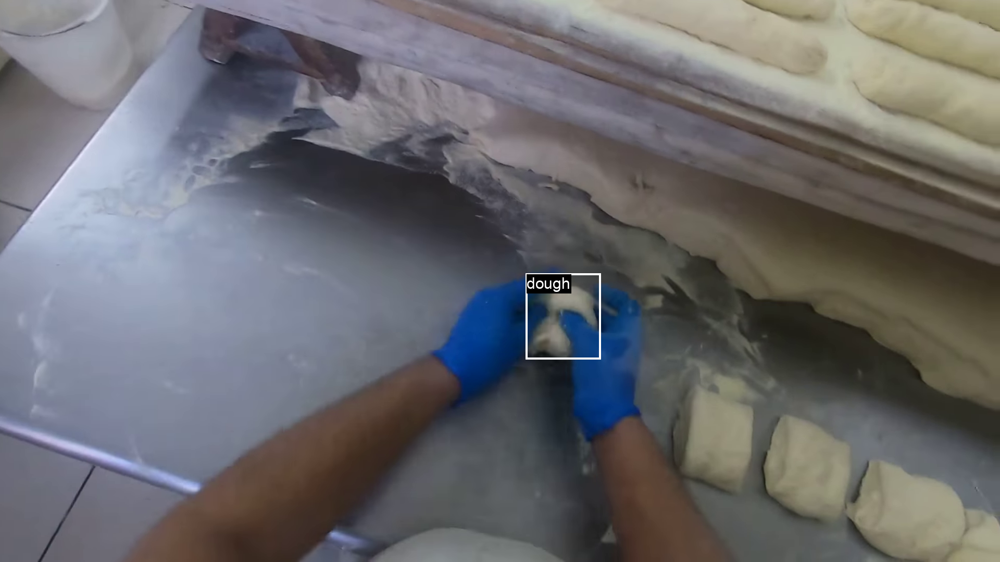

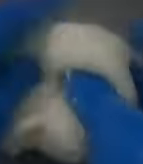

['blurry photograph of an odd shaped item inside blue material',
 'blurred image of an ice cream cone with a blue base',
 'blurry photograph of something white and blue']
Frame: pnr_frame


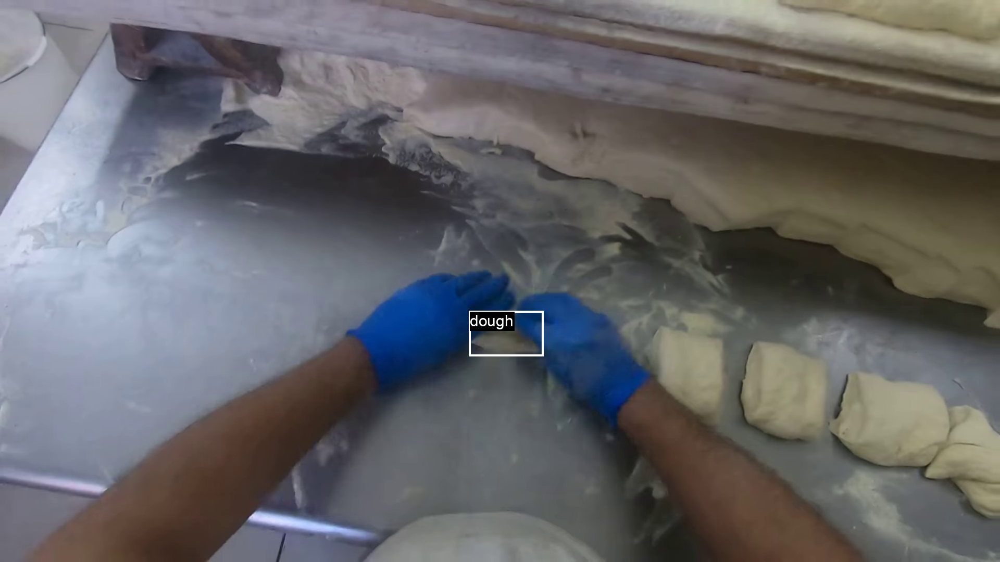

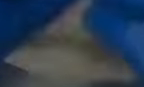

['blurry photograph of bird sitting on a branch',
 'blurred photograph of light from ceiling and blue sky',
 'blurry image of bird on white plate with red plate']
Frame: post_frame


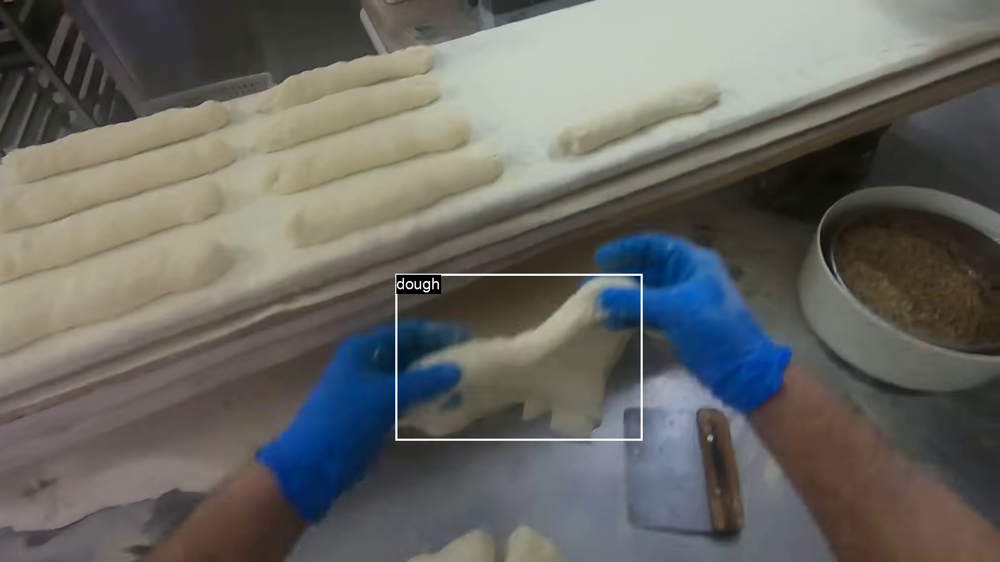

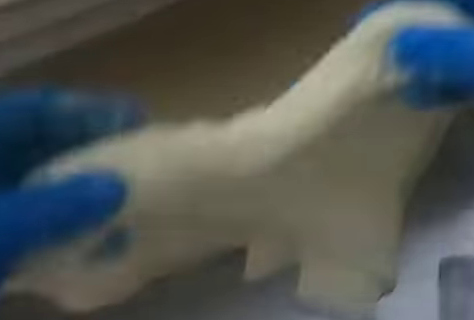

['an image of a stuffed bear near shelves',
 'a stuffed animal laying on top of an ottoman',
 'two blue and white stuffed animals are on the shelf']
Active objects:
['dough', 'dough', 'dough']


In [388]:
list_of_active_objects = []
curr_images_root = "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/pre_pnr_post_png_frames"

rand_idx = np.random.choice(np.arange(len(downloaded_scod_clips)))
print("Data Index: {}".format(rand_idx))
sampled_scod_clip = downloaded_scod_clips[rand_idx]

video_uid = sampled_scod_clip["video_uid"]
for frame in ["pre_frame", "pnr_frame", "post_frame"]:
    print("Frame: {}".format(frame))
    frame_num = sampled_scod_clip[frame]["frame_number"]
    frame_image = os.path.join(curr_images_root, video_uid, "{}.png".format(frame_num))
    for bbox_info in sampled_scod_clip[frame]["bbox"]:
        bbox = bbox_info["bbox"]
        if bbox_info["object_type"] == "object_of_change":
            list_of_active_objects.append(bbox_info["structured_noun"])
            bboxed_frame_image = draw_bbox_on_image(
                frame_image,
                [bbox["x"], bbox["y"], bbox["width"], bbox["height"]],
                bbox_info["structured_noun"],
                bbox_width=4,
                label_font_size=30,
            )
            # bboxed_frame_image = bboxed_frame_image.resize((512, 512), Image.Resampling.LANCZOS)
            display(bboxed_frame_image)
            cropped_bboxed_frame_image = Image.open(frame_image).crop((
                bbox["x"], bbox["y"], bbox["x"]+bbox["width"], bbox["y"]+bbox["height"]
            ))
            display(cropped_bboxed_frame_image)
            
            lavis_caption = model.generate(
                {"image": vis_processors["eval"](cropped_bboxed_frame_image).unsqueeze(0).to(device)},
                num_beams=4,
                repetition_penalty=0.9,
                num_captions=3,
                use_nucleus_sampling=True,
            )
            pprint.pprint(lavis_caption)
            
print("Active objects:")
pprint.pprint(list_of_active_objects)
# pprint.pprint(sampled_scod_clip)

In [41]:
# Indices: 
# ...

### For GLIP 

#### Essential Functions

In [8]:
def create_glip_config_file(
    narration,
    video_uid,
    frames_dict,
    glip_images_folder="../../GLIP/DATASET/ego4d/frames/test",
    glip_config_file_template="../../GLIP/configs/ego4d/ego4d_template.yaml",
    glip_config_file_output="../../GLIP/configs/ego4d/ego4d_test.yaml",
    move_images=True,
    processed_scod_image_folder=None,
):
    narration_tokens = word_tokenize(narration)
    is_noun = lambda pos: pos[:2] == 'NN'
    narration_nouns = sorted(list(set([word for (word, pos) in nltk.pos_tag(narration_tokens) if is_noun(pos)])))
    if "C " in narration:
        narration_nouns.pop(narration_nouns.index("C"))

    print(narration)
    print(narration_nouns)

    override_category = []
    override_category_mapping = {}
    caption_prompt = []
    override_category_id = 1
    for noun in narration_nouns:
        override_category.append({
            "id": override_category_id,
            "name": noun,
            "supercategory": "objects",
        })
        override_category_mapping[override_category_id] = noun
        override_category_id += 1

        prefix = []
        name = []
        suffix = []
        now_suffix = False
        for token in narration_tokens:
            if token == noun:
                name.append(noun)
                now_suffix = True
            elif now_suffix:
                suffix.append(token)
            else:
                prefix.append(token)
        prefix = " ".join(prefix)
        name = " ".join(name)
        suffix = " ".join(suffix)
        caption_prompt.append({
            "prefix": prefix,
            "name": name,
            "suffix": suffix,
        })

    num_classes = len(narration_nouns)

    to_revise = {
        "CAPTION_PROMPT": str(caption_prompt),
        "OVERRIDE_CATEGORY": str(override_category),
        "NUM_CLASSES": str(num_classes+1),
        "img_dir": "ego4d/frames/test",
        "ann_file": "ego4d_test_tmp.json",
    }
    
    if processed_scod_image_folder is not None:
        to_revise["img_dir"] = processed_scod_image_folder

    pprint.pprint(to_revise)
    # print(video_uid, pre_frame, pnr_frame, post_frame)

    # Copy frames to GLIP folder
    if move_images:
        for frame in ["pre_frame", "pnr_frame", "post_frame"]:
            src_img = "./media/{}.png".format(frame)
            dst_img = os.path.join(
                glip_images_folder,
                "{}_{}.png".format(video_uid, frames_dict[frame])
            )
            print("Moving image from {} to {}".format(src_img, dst_img))
            shutil.copy(src_img, dst_img)

    glip_config_file_output = open(glip_config_file_output, "w")

    for line in open(glip_config_file_template):
        line = line.rstrip()
        for key in to_revise:
            if key in line and key == "ann_file":
                line = line.replace("ego4d_test", "ego4d_test_tmp")
            elif key in line and key != "NUM_CLASSES":
                line = line.replace("TODO", to_revise[key].replace("\'", "\""))
            elif key in line:
                line = "    NUM_CLASSES: {}".format(to_revise[key])
        glip_config_file_output.write(line+"\n")
    glip_config_file_output.close()
    
    return override_category, override_category_mapping, caption_prompt, narration_tokens

In [9]:
def create_glip_dataset_file(
    override_category,
    video_uid,
    frames_dict,
    coco_annots_test_json="../../GLIP/DATASET/ego4d/annotations/image_info_test-dev2017.json",
    output_dataset_file="../../GLIP/DATASET/ego4d/annotations/ego4d_test.json",
    processed_scod_image_folder=None,
):
    coco_annots_test = json.load(open(coco_annots_test_json))
    print(coco_annots_test.keys())
    pprint.pprint(coco_annots_test["images"][0])

    new_d = {
        "info": coco_annots_test["info"],
        "images": [],
        "licenses": coco_annots_test["licenses"],
        "categories": override_category,
    }

    for frame in ["pre_frame", "pnr_frame", "post_frame"]:
        
        if frame not in frames_dict:
            continue
        
        if processed_scod_image_folder is not None:
            file_name = "{}/{}.png".format(video_uid, frames_dict[frame])
            file_path = os.path.join(processed_scod_image_folder, file_name)
        else:
            file_name = "{}_{}.png".format(video_uid, frames_dict[frame])
            file_path = os.path.join(glip_images_folder,
                "{}_{}.png".format(video_uid, frames_dict[frame]))
        assert os.path.exists(file_path), "Image {} does not exist!".format(file_path)
        
        img = Image.open(file_path)
        width = img.width
        height = img.height
        image_d = {
            "coco_url": "",
            "date_captured": "",
            "file_name": file_name,
            "height": height,
            "width": width,
            "license": 6,
            "id": "{}_{}".format(video_uid, frames_dict[frame]),
        }
        new_d["images"].append(image_d)

    json.dump(
        new_d,
        open(output_dataset_file, "w"),
        indent=4,
    )
    
    return output_dataset_file

In [10]:
def plot_glip_bboxes(
    video_uid,
    frames_dict,
    narration_tokens,
    override_category_mapping,
    top_k_bboxes=3,
    pred_bboxes_file ="../../GLIP/test_ego4d_eval_outputs_tmp/eval/glip_tiny_model_o365_goldg_cc_sbu/inference/test/bbox.json",
    glip_images_folder="../../GLIP/DATASET/ego4d/frames/test",
    resize_image_width=None,
    processed_scod_image_folder=None,
):
    pred_bboxes = json.load(open(pred_bboxes_file))
    pred_bboxes_on_images = {}
    for bbox in pred_bboxes:
        image_id = bbox["image_id"]
        if processed_scod_image_folder is not None:
            curr_video_uid, curr_frame_cnt = image_id.split("_")
            img_path = os.path.join(
                processed_scod_image_folder,
                "{}/{}.png".format(curr_video_uid, curr_frame_cnt)
            )
        else:
            img_path = os.path.join(
                glip_images_folder,
                "{}.png".format(image_id)
            )
        assert os.path.exists(img_path)
        if image_id not in pred_bboxes_on_images:
            pred_bboxes_on_images[image_id] = {
                "img_path": img_path,
                "bboxes": []
            }
        pred_bboxes_on_images[image_id]["bboxes"].append({
            "score": bbox["score"],
            "bbox": bbox["bbox"],
            "label": override_category_mapping[bbox["category_id"]]
        })

    for image_id in pred_bboxes_on_images:
        pred_bboxes_on_images[image_id]["bboxes"] = sorted(
            pred_bboxes_on_images[image_id]["bboxes"],
            key=lambda x: x["score"],
            reverse=True
        )

    # pprint.pprint(pred_bboxes_on_images)
    frame_images = {}
    for frame in ["pre_frame", "pnr_frame", "post_frame"]:
        if frame not in frames_dict:
            continue
        if processed_scod_image_folder is not None:
            _img = os.path.join(
                processed_scod_image_folder,
                "{}/{}.png".format(video_uid, frames_dict[frame])
            )
        else:
            _img = os.path.join(
                glip_images_folder,
                "{}_{}.png".format(video_uid, frames_dict[frame])
            )
        frame_images[frame] = _img

    for frame in ["pre_frame", "pnr_frame", "post_frame"]:
        print("Frame: {}".format(frame))
        print("Narrations: {}".format(narration_tokens))
        if frame not in frame_images:
            continue
        frame_image = Image.open(frame_images[frame])
        frame_image_id = "{}_{}".format(video_uid, frames_dict[frame])
        bboxed_frame_image = frame_image
        if frame_image_id in pred_bboxes_on_images:
            bboxes = pred_bboxes_on_images[frame_image_id]["bboxes"]
            for bbox_info in bboxes[:top_k_bboxes]:
                bbox = bbox_info["bbox"]
                bboxed_frame_image = draw_bbox_on_image(
                    bboxed_frame_image,
                    [bbox[0], bbox[1], bbox[2], bbox[3]],
                    bbox_info["label"]+": {:.4f}".format(bbox_info["score"]),
                    bbox_width=4,
                    label_font_size=30,
                )
        if (
            resize_image_width is not None
            and (type(resize_image_width) is int or
                 type(resize_image_width) is float)
        ):
            wpercent = (resize_image_width / float(bboxed_frame_image.size[0]))
            hsize = int((float(bboxed_frame_image.size[1]) * float(wpercent)))
            bboxed_frame_image = bboxed_frame_image.resize((resize_image_width, hsize), Image.Resampling.LANCZOS)
        display(bboxed_frame_image)

In [11]:
def glip_inference_for_bboxes(
    narration,
    video_uid,
    frames_dict,
    glip_images_folder="../../GLIP/DATASET/ego4d/frames/test",
    glip_config_file_template="../../GLIP/configs/ego4d/ego4d_template.yaml",
    glip_config_file_output="../../GLIP/configs/ego4d/ego4d_test.yaml",
    coco_annots_test_json="../../GLIP/DATASET/ego4d/annotations/image_info_test-dev2017.json",
    output_dataset_file="../../GLIP/DATASET/ego4d/annotations/ego4d_test.json",
    run_glip_commands=[
        "sh scripts/run_glip_tmp.sh",
    ],
    pred_bboxes_file="../../GLIP/test_ego4d_eval_outputs_tmp/eval/glip_tiny_model_o365_goldg_cc_sbu/inference/test/bbox.json",
    top_k_bboxes=3,
    resize_image_width=None,
    processed_scod_image_folder=None,
):
    (override_category,
     override_category_mapping,
     caption_prompt,
     narration_tokens) = create_glip_config_file(
        narration,
        video_uid,
        frames_dict,
        glip_images_folder=glip_images_folder,
        glip_config_file_template=glip_config_file_template,
        glip_config_file_output=glip_config_file_output,
        move_images=processed_scod_image_folder is None,
        processed_scod_image_folder=processed_scod_image_folder,
    )

    create_glip_dataset_file(
        override_category,
        video_uid,
        frames_dict,
        coco_annots_test_json=coco_annots_test_json,
        output_dataset_file=output_dataset_file,
        processed_scod_image_folder=processed_scod_image_folder,
    )

    for cmd in run_glip_commands:
        os.system(cmd)
    clear_output()

    plot_glip_bboxes(
        video_uid,
        frames_dict,
        narration_tokens,
        override_category_mapping,
        top_k_bboxes=top_k_bboxes,
        pred_bboxes_file=pred_bboxes_file,
        glip_images_folder=glip_images_folder,
        resize_image_width=resize_image_width,
        processed_scod_image_folder=processed_scod_image_folder,
    )

#### Testing

In [24]:
curr_videos_root = "/local1/hu528/ego4d_data/v1/full_scale"
rand_idx = np.random.choice(np.arange(len(downloaded_scod_clips)))
# rand_idx = 14980

print("Data Index: {}".format(rand_idx))
sampled_scod_clip = downloaded_scod_clips[rand_idx]

video_uid, frames_dict = get_ego4d_scod_clips_and_frames(
    sampled_scod_clip,
    curr_videos_root,
    show_name="scod",
    get_frames=False
)

print("-"*50)
clip_narrations, closest_narrations = get_scod_clipped_narrations(
    sampled_scod_clip,
    all_narrations,
    curr_videos_root,
    narration_pass="narration_pass_1",
    top_k=5,
    verbose=True,
)
print("Main Narration:", closest_narrations[0][-1])

Data Index: 20131
Mother video: /local1/hu528/ego4d_data/v1/full_scale/23ecfb5c-6d29-40a6-b070-5be19ba3e86f.mp4
The fps of video `/local1/hu528/ego4d_data/v1/full_scale/23ecfb5c-6d29-40a6-b070-5be19ba3e86f.mp4` is: 30 of frame counts: 132349 and duration: 4411.633333333333 sec.
105996 106004 106019
0:58:53.200000 0:58:53.466667 0:58:53.966667
Executed command: /home/telinwu/ffmpeg-git-20220910-amd64-static/ffmpeg -ss 0:58:53 -to 0:58:54 -i /local1/hu528/ego4d_data/v1/full_scale/23ecfb5c-6d29-40a6-b070-5be19ba3e86f.mp4 -c copy -loglevel panic ./media/scod.mp4
--------------------------------------------------
/local1/hu528/ego4d_data/v1/full_scale/23ecfb5c-6d29-40a6-b070-5be19ba3e86f.mp4 30
FPS: 30
Object of change: ['mold_(mold,_molder,_mould)']
Pre/PNR/Post frame = 105996 / 106004 / 106019
Pre/PNR/Post sec   = 0:58:53.20 / 0:58:53.47 / 0:58:53.97
[0:58:53.52-0:58:53.58](106005-106007) #C C drops the brick mould on the ground. (v)
[0:58:53.58-0:58:54.69](106007-106040) #C C puts left h

In [48]:
glip_images_folder = "../../GLIP/DATASET/ego4d/frames/test"
glip_config_file_template = "../../GLIP/configs/ego4d/ego4d_template.yaml"
glip_config_file_output = "../../GLIP/configs/ego4d/ego4d_test_tmp.yaml"
# Write some narrations.
narration = closest_narrations[0][-1].split("#C ")[-1].strip()
# narration = "The carabiner is now in the possession of the person who removed it from the hook."
processed_scod_image_folder = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge"
    "/pre_pnr_post_png_frames"
)

(override_category,
 override_category_mapping,
 caption_prompt,
 narration_tokens) = create_glip_config_file(
    narration,
    video_uid,
    frames_dict,
    glip_images_folder=glip_images_folder,
    glip_config_file_template=glip_config_file_template,
    glip_config_file_output=glip_config_file_output,
    move_images=processed_scod_image_folder is None,
    processed_scod_image_folder=processed_scod_image_folder,
)

C drops the brick mould on the ground.
['brick', 'ground', 'mould']
{'CAPTION_PROMPT': "[{'prefix': 'C drops the', 'name': 'brick', 'suffix': "
                   "'mould on the ground .'}, {'prefix': 'C drops the brick "
                   "mould on the', 'name': 'ground', 'suffix': '.'}, "
                   "{'prefix': 'C drops the brick', 'name': 'mould', 'suffix': "
                   "'on the ground .'}]",
 'NUM_CLASSES': '4',
 'OVERRIDE_CATEGORY': "[{'id': 1, 'name': 'brick', 'supercategory': "
                      "'objects'}, {'id': 2, 'name': 'ground', "
                      "'supercategory': 'objects'}, {'id': 3, 'name': 'mould', "
                      "'supercategory': 'objects'}]",
 'ann_file': 'ego4d_test_tmp.json',
 'img_dir': '/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/pre_pnr_post_png_frames'}


In [57]:
coco_annots_test_json = "../../GLIP/DATASET/ego4d/annotations/image_info_test-dev2017.json"
output_dataset_file = "../../GLIP/DATASET/ego4d/annotations/ego4d_test_tmp.json"
run_glip_commands=[
    "sh scripts/run_glip_tmp.sh",
]
processed_scod_image_folder = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge"
    "/pre_pnr_post_png_frames"
)

glip_dataset_file = create_glip_dataset_file(
    override_category,
    video_uid,
    frames_dict,
    coco_annots_test_json=coco_annots_test_json,
    output_dataset_file=output_dataset_file,
    processed_scod_image_folder=processed_scod_image_folder,
)

for cmd in run_glip_commands:
    os.system(cmd)
clear_output()

print(glip_dataset_file)

../../GLIP/DATASET/ego4d/annotations/ego4d_test_tmp.json


23ecfb5c-6d29-40a6-b070-5be19ba3e86f
{'pre_frame': 105996, 'pnr_frame': 106004, 'post_frame': 106019}
Frame: pre_frame
Narrations: ['C', 'drops', 'the', 'brick', 'mould', 'on', 'the', 'ground', '.']


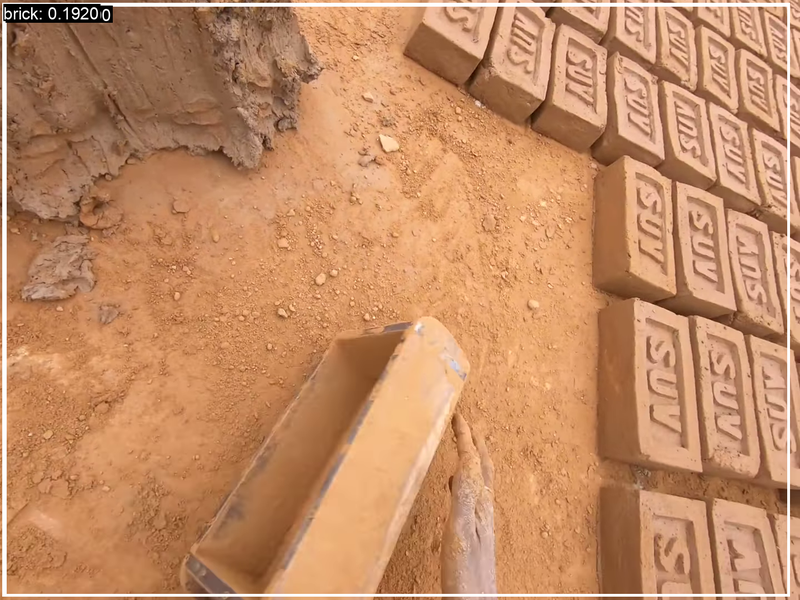

Frame: pnr_frame
Narrations: ['C', 'drops', 'the', 'brick', 'mould', 'on', 'the', 'ground', '.']


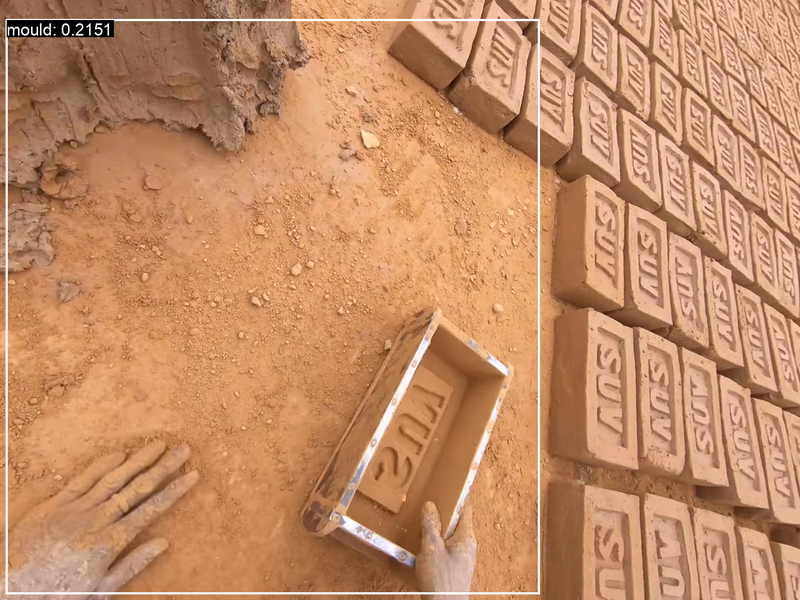

Frame: post_frame
Narrations: ['C', 'drops', 'the', 'brick', 'mould', 'on', 'the', 'ground', '.']


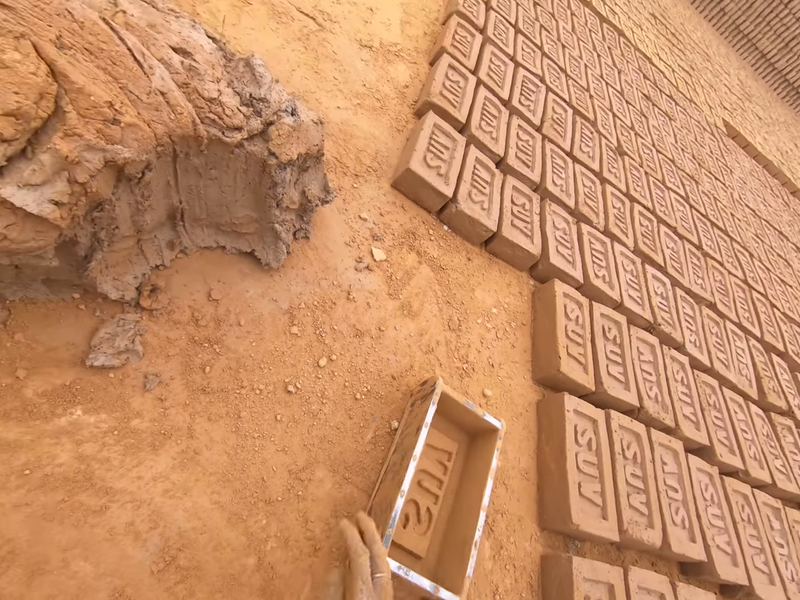

In [63]:
processed_scod_image_folder = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge"
    "/pre_pnr_post_png_frames"
)

pred_bboxes_file = "../../GLIP/test_ego4d_eval_outputs_tmp/eval/glip_tiny_model_o365_goldg_cc_sbu/inference/test/bbox.json"
top_k_bboxes = 3

print(video_uid)
print(frames_dict)

plot_glip_bboxes(
    video_uid,
    frames_dict,
    narration_tokens,
    override_category_mapping,
    top_k_bboxes=top_k_bboxes,
    pred_bboxes_file=pred_bboxes_file,
    glip_images_folder=glip_images_folder,
    resize_image_width=800,
    processed_scod_image_folder=processed_scod_image_folder,
)

Frame: pre_frame
Narrations: ['C', 'drops', 'the', 'brick', 'mould', 'on', 'the', 'ground', '.']


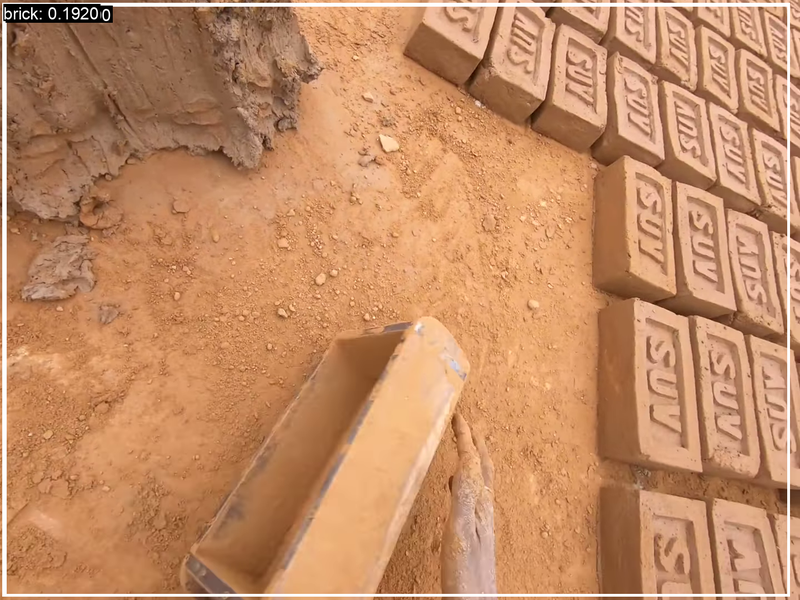

Frame: pnr_frame
Narrations: ['C', 'drops', 'the', 'brick', 'mould', 'on', 'the', 'ground', '.']


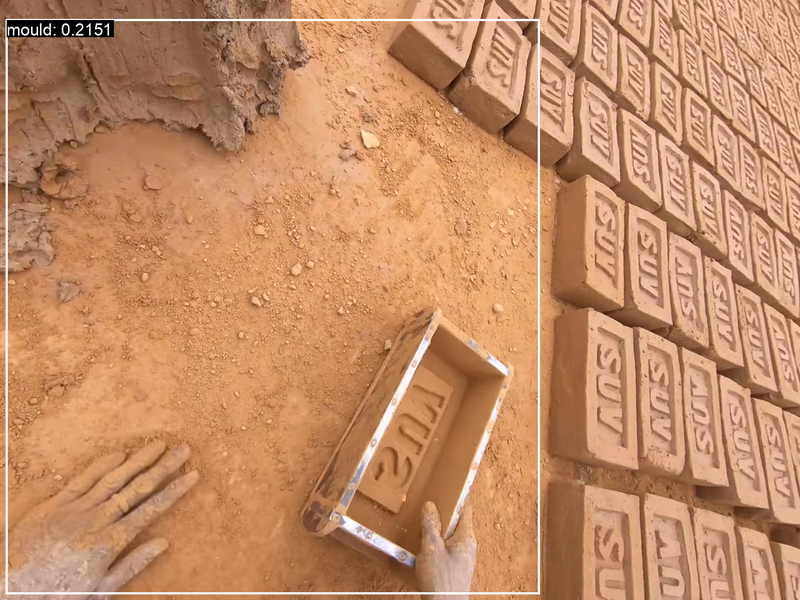

Frame: post_frame
Narrations: ['C', 'drops', 'the', 'brick', 'mould', 'on', 'the', 'ground', '.']


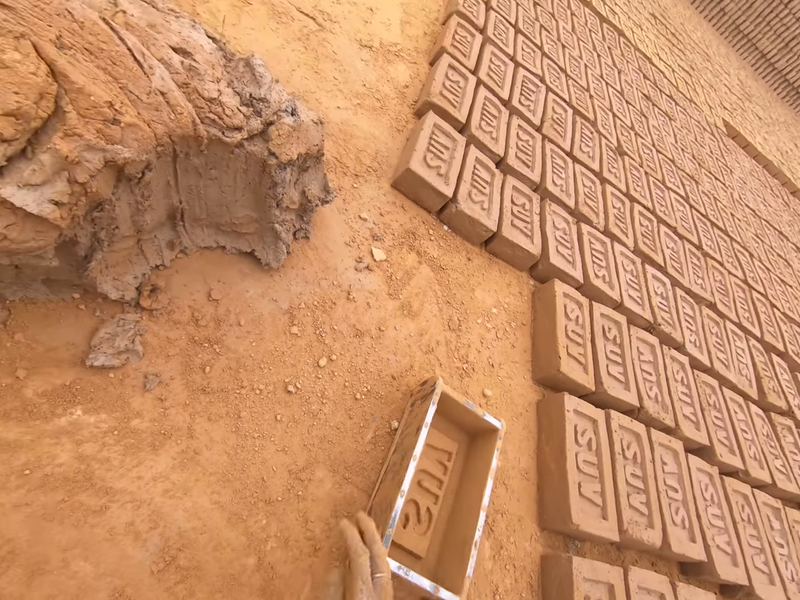

In [69]:
glip_images_folder = "../../GLIP/DATASET/ego4d/frames/test"
glip_config_file_template = "../../GLIP/configs/ego4d/ego4d_template.yaml"
glip_config_file_output = "../../GLIP/configs/ego4d/ego4d_test_tmp.yaml"
coco_annots_test_json = "../../GLIP/DATASET/ego4d/annotations/image_info_test-dev2017.json"
output_dataset_file = "../../GLIP/DATASET/ego4d/annotations/ego4d_test_tmp.json"
run_glip_commands=[
    "sh scripts/run_glip_tmp.sh",
]
pred_bboxes_file = "../../GLIP/test_ego4d_eval_outputs_tmp/eval/glip_tiny_model_o365_goldg_cc_sbu/inference/test/bbox.json"
top_k_bboxes = 3
processed_scod_image_folder = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge"
    "/pre_pnr_post_png_frames"
)
# Write some narrations.
narration = closest_narrations[0][-1].split("#C ")[-1].strip()

glip_inference_for_bboxes(
    narration,
    video_uid,
    frames_dict,
    glip_images_folder=glip_images_folder,
    glip_config_file_template=glip_config_file_template,
    glip_config_file_output=glip_config_file_output,
    coco_annots_test_json=coco_annots_test_json,
    output_dataset_file=output_dataset_file,
    run_glip_commands=run_glip_commands,
    pred_bboxes_file=pred_bboxes_file,
    top_k_bboxes=top_k_bboxes,
    resize_image_width=800,
    processed_scod_image_folder=processed_scod_image_folder,
)

Frame: pre_frame
Narrations: ['The', 'carabiner', 'is', 'now', 'in', 'the', 'possession', 'of', 'the', 'person', 'who', 'removed', 'it', 'from', 'the', 'hook', '.']


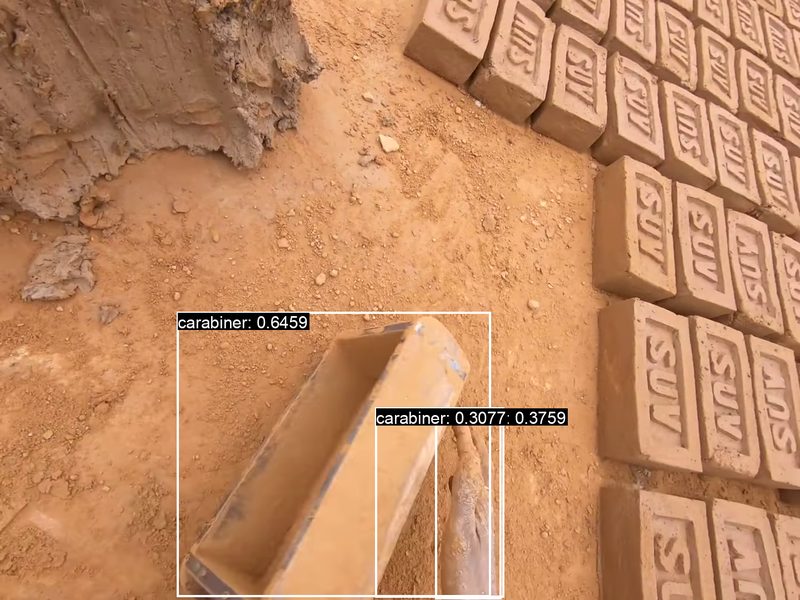

Frame: pnr_frame
Narrations: ['The', 'carabiner', 'is', 'now', 'in', 'the', 'possession', 'of', 'the', 'person', 'who', 'removed', 'it', 'from', 'the', 'hook', '.']


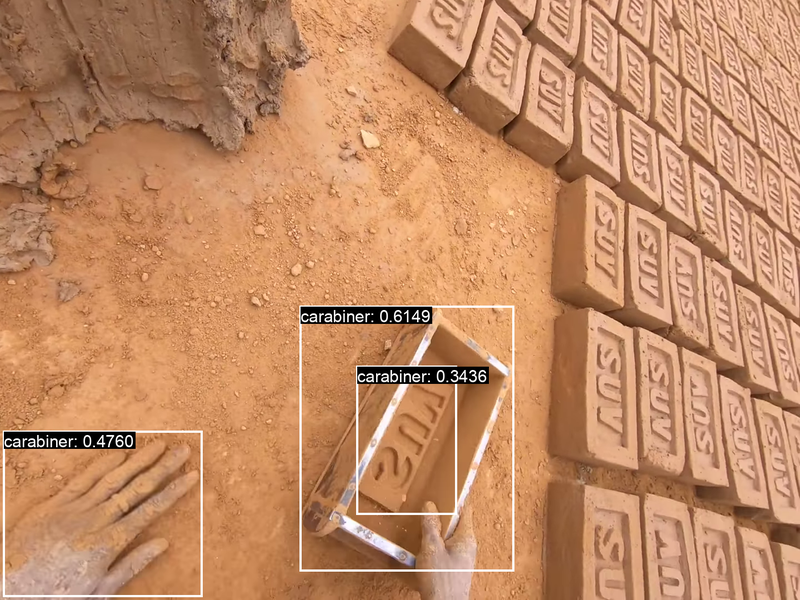

Frame: post_frame
Narrations: ['The', 'carabiner', 'is', 'now', 'in', 'the', 'possession', 'of', 'the', 'person', 'who', 'removed', 'it', 'from', 'the', 'hook', '.']


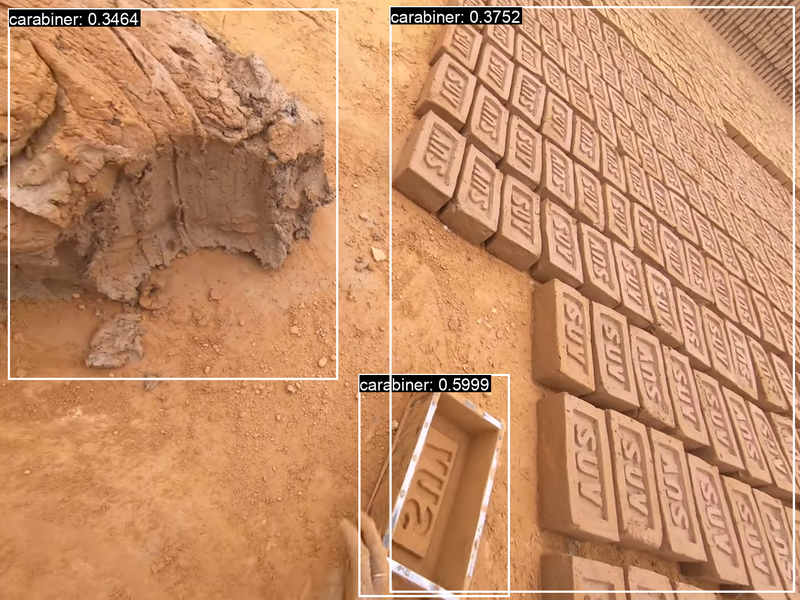

In [70]:
processed_scod_image_folder = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge"
    "/pre_pnr_post_png_frames"
)

narration = "The carabiner is now in the possession of the person who removed it from the hook."


glip_inference_for_bboxes(
    narration,
    video_uid,
    frames_dict,
    glip_images_folder=glip_images_folder,
    glip_config_file_template=glip_config_file_template,
    glip_config_file_output=glip_config_file_output,
    coco_annots_test_json=coco_annots_test_json,
    output_dataset_file=output_dataset_file,
    run_glip_commands=run_glip_commands,
    pred_bboxes_file=pred_bboxes_file,
    top_k_bboxes=top_k_bboxes,
    resize_image_width=800,
    processed_scod_image_folder=processed_scod_image_folder,
)

## STA

In [12]:
sta_annots_test = "fho_sta_val.json"
sta_annots_test = os.path.join(annots_root, sta_annots_test)
sta_annots = json.load(open(sta_annots_test))

print(len(sta_annots["annotations"]))

17217


In [13]:
print(sta_annots.keys())

annot_idx = np.random.choice(len(sta_annots["annotations"]))
pprint.pprint(sta_annots["info"].keys())
noun_cats = {}
verb_cats = {}
for cat in sta_annots["noun_categories"]:
    noun_cats[cat["id"]] = cat["name"]
for cat in sta_annots["verb_categories"]:
    verb_cats[cat["id"]] = cat["name"]
pprint.pprint(sta_annots["info"]["video_metadata"][sta_annots["annotations"][annot_idx]["video_id"]])
for bbox_idx in range(len(sta_annots["annotations"][annot_idx]["objects"])):
    sta_annots["annotations"][annot_idx]["objects"][bbox_idx]["verb"] = \
        verb_cats[sta_annots["annotations"][annot_idx]["objects"][bbox_idx]["verb_category_id"]]
    sta_annots["annotations"][annot_idx]["objects"][bbox_idx]["noun"] = \
        noun_cats[sta_annots["annotations"][annot_idx]["objects"][bbox_idx]["noun_category_id"]]
pprint.pprint(sta_annots["annotations"][annot_idx])
pprint.pprint(sta_annots["annotations"][annot_idx+1])
sta_frame_number = sta_annots["annotations"][annot_idx]["frame"]
video_uid = sta_annots["annotations"][annot_idx]["video_id"]
print(video_uid, sta_frame_number)

dict_keys(['info', 'annotations', 'noun_categories', 'verb_categories'])
dict_keys(['description', 'version', 'split', 'include_annotations', 'video_metadata', 'year', 'date_created'])
{'fps': 30.0, 'frame_height': 1080, 'frame_width': 1440}
{'clip_frame': 3266,
 'clip_id': 1217,
 'clip_uid': '4921fa23-9b0a-4bed-b6d0-2255e9615132',
 'frame': 57025,
 'objects': [{'box': [1039.86, 489.5, 1089.07, 536.12],
              'noun': 'dough',
              'noun_category_id': 21,
              'time_to_contact': 1.4333333333333333,
              'verb': 'cut_(trim,_slice,_chop)',
              'verb_category_id': 8}],
 'uid': '826e419a-8788-484f-9543-550964666762_0057025',
 'video_id': '826e419a-8788-484f-9543-550964666762'}
{'clip_frame': 3281,
 'clip_id': 1217,
 'clip_uid': '4921fa23-9b0a-4bed-b6d0-2255e9615132',
 'frame': 57040,
 'objects': [{'box': [1130.5, 580.14, 1184.89, 618.99],
              'noun_category_id': 21,
              'time_to_contact': 0.9333333333333333,
              'ver

In [14]:
downloaded_video_id_and_paths = {
    x.split(".mp4")[0]: os.path.join(curr_videos_root, x)
    for x in os.listdir(curr_videos_root) if ".mp4" in x
}
print("Currently we downloaded {} ego4d videos.".format(len(downloaded_video_id_and_paths)))

downloaded_sta_annots = []
for idx in range(len(sta_annots["annotations"])):
    video_uid = sta_annots["annotations"][idx]["video_id"]
    if video_uid in downloaded_video_id_and_paths:
        downloaded_sta_annots.append(sta_annots["annotations"][idx])
print(len(downloaded_sta_annots))

Currently we downloaded 716 ego4d videos.
17211


In [15]:
sta_rand_idx = np.random.choice(len(downloaded_sta_annots))
# sta_rand_idx = 874
sta_rand_idx = 465
print(sta_rand_idx)

curr_downloaded_sta_annots = downloaded_sta_annots[sta_rand_idx]
pprint.pprint(curr_downloaded_sta_annots)

video_uid = curr_downloaded_sta_annots["video_id"]
sta_frame_number = curr_downloaded_sta_annots["frame"]

curr_videos_root = "/local1/hu528/ego4d_data/v1/full_scale"
ego4d_video_path = os.path.join(
    curr_videos_root,
    "{}.mp4".format(video_uid),
)
print("Mother video: {}".format(ego4d_video_path))
assert os.path.exists(ego4d_video_path)
frame_name = "sta_demo"
narration_pass = "narration_pass_1"
fps = 30

ffmpeg_frame_cmd = (
    "/home/telinwu/ffmpeg-git-20220910-amd64-static/ffmpeg "
    "-i {} "
    "-vf select='between(n\,{}\,{})' -vsync 0 "
    "-loglevel panic ./media/{}.png".format(
        ego4d_video_path,
        sta_frame_number,
        sta_frame_number,
        frame_name,
    )
)

curr_narrations = all_narrations[video_uid][narration_pass]["narrations"]
min_future_frame = 1e12
curr_frame = curr_downloaded_sta_annots["frame"]
for obj in curr_downloaded_sta_annots["objects"]:
    min_future_frame = min(min_future_frame, int(obj["time_to_contact"]*fps))
min_future_frame += curr_frame

closest_before_sta_narrations = []
closest_after_sta_narrations = []
for i in range(len(curr_narrations)-1):
    narration_text = curr_narrations[i]["narration_text"]
    timestamp_sec = curr_narrations[i]["timestamp_sec"]
    timestamp_frame = curr_narrations[i]["timestamp_frame"]
    next_timestamp_frame = curr_narrations[i+1]["timestamp_frame"]
    if (
        next_timestamp_frame <= curr_frame
    ):
        closest_before_sta_narrations.append((
            timestamp_sec, timestamp_frame, narration_text
        ))
    elif (
        timestamp_frame >= min_future_frame
    ):
        closest_after_sta_narrations.append((
            timestamp_sec, timestamp_frame, narration_text,
        ))

closest_before_sta_narrations = sorted(closest_before_sta_narrations, reverse=True)[:5]
closest_before_sta_narrations = [(a, b, c) for a, b, c in closest_before_sta_narrations]
closest_after_sta_narrations = sorted(closest_after_sta_narrations, reverse=False)[:5]
closest_after_sta_narrations = [(a, b, c) for a, b, c in closest_after_sta_narrations]

# raise

if os.path.exists("./media/sta_demo.png"):
    os.remove("./media/sta_demo.png")
print("Executed command: {}".format(ffmpeg_frame_cmd))
os.system(ffmpeg_frame_cmd)

465
{'clip_frame': 5396,
 'clip_id': 457,
 'clip_uid': 'f43e2a97-b81b-4271-befd-569552d8129c',
 'frame': 5396,
 'objects': [{'box': [-0.56, 0.74, 1919.6100000000001, 1404.44],
              'noun_category_id': 43,
              'time_to_contact': 0.23333333333333334,
              'verb_category_id': 45}],
 'uid': '763509f4-203d-4e4b-bb42-67eb9839874b_0005396',
 'video_id': '763509f4-203d-4e4b-bb42-67eb9839874b'}
Mother video: /local1/hu528/ego4d_data/v1/full_scale/763509f4-203d-4e4b-bb42-67eb9839874b.mp4


KeyError: 'narration_pass_1'

In [16]:
noun_id = curr_downloaded_sta_annots["objects"][0]["noun_category_id"]
verb_id = curr_downloaded_sta_annots["objects"][0]["verb_category_id"]
noun = noun_cats[noun_id]
verb = verb_cats[verb_id]

print("-"*50)
print("Before STA Frame")
for a, b, c in sorted(closest_before_sta_narrations, key=lambda x: int(x[1])):
    print("[{}]({}) {}".format(str(datetime.timedelta(seconds=a))[:10], b, c))
print("STA frame: {}".format(curr_frame))
print("After STA Frame")
for a, b, c in sorted(closest_after_sta_narrations, key=lambda x: int(x[1])):
    print("[{}]({}) {}".format(str(datetime.timedelta(seconds=a))[:10], b, c))
print("-"*50)

bboxed_frame_image = Image.open("./media/sta_demo.png")
for bbox_info in curr_downloaded_sta_annots["objects"]:
    bbox = bbox_info["box"]
    bboxed_frame_image = draw_bbox_on_image(
        bboxed_frame_image,
        bbox,
        "{} {}".format(verb, noun),
        bbox_width=4,
        label_font_size=30,
    )
# bboxed_frame_image = bboxed_frame_image.resize((512, 512), Image.Resampling.LANCZOS)
display(bboxed_frame_image)

--------------------------------------------------
Before STA Frame


NameError: name 'closest_before_sta_narrations' is not defined

### Large-Scale GLIP

In [17]:
import pandas as pd
pd.set_option('display.expand_frame_repr', False)
from run_glip_baseline_on_ego4d import coco_eval_results
from coco_eval import get_avg_precision_at_iou
from coco_eval import get_single_image_results
from coco_eval import calc_precision_recall
from PIL import Image, ImageDraw, ImageFont
from transformers import CLIPProcessor, CLIPModel

curr_videos_root = "/local1/hu528/ego4d_data/v1/full_scale"

In [18]:
# Use the {video_uid}_{pnr_frame} as key to organize the scod clip annotation

keyed_scod_clips = {}
for scod_clip in downloaded_scod_clips:
    video_uid = scod_clip["video_uid"]
    pnr_frame = scod_clip["pnr_frame"]["frame_number"]
    key = "{}_{}".format(video_uid, pnr_frame)
    keyed_scod_clips[key] = scod_clip

#### Essential Functions

In [19]:
def compare_glip_results(files, frame_keys, top_k, best_k=None, first_k=None):
    res = {}
    all_keyed_results = {}
    for file in files:
        res[file] = {
            "Metrics": None
        }
        file_for_coco = file
        if type(files) is dict:
            file_for_coco = {file: files[file]}
        all_metrics, avg_metrics, keyed_results = coco_eval_results(
            file_for_coco,
            top_k=top_k,
            verbose=False,
            first_k=first_k,
            best_k=best_k,
            frame_keys=frame_keys,
        )
        res[file]["Metrics"] = avg_metrics
        all_keyed_results[file] = keyed_results
    
    for file in res:
        print("---- {} ----".format(file))
        columns = ["Frame", "AP", "AP50", "AP75"]
        if best_k is not None:
            for ap in ["AP", "AP50", "AP75"]:
                columns.append("Best-{}-{}".format(best_k, ap))
        lst = []
        for fr in ["pre", "pnr", "post"]:
            curr_lst = []
            curr_fr = "{}_frame".format(fr)
            curr_lst.append(curr_fr)
            if curr_fr in res[file]["Metrics"]:
                for ap in ["AP", "AP50", "AP75"]:
                    prec = res[file]["Metrics"][curr_fr][ap]["precision"]
                    recall = res[file]["Metrics"][curr_fr][ap]["recall"]
                    curr_lst.append(prec)
                if best_k is not None:
                    for ap in ["AP", "AP50", "AP75"]:
                        ap = "Best-{}-{}".format(best_k, ap)
                        prec = res[file]["Metrics"][curr_fr][ap]["precision"]
                        recall = res[file]["Metrics"][curr_fr][ap]["recall"]
                        curr_lst.append(prec)
            lst.append(curr_lst)
        df = pd.DataFrame(lst, columns=columns)
        print(df)
        
    return all_keyed_results


def make_keyed_glip_results(
    output_results_json_file,
    frame_keys=["pre", "pnr", "post"],
):
    output_results = json.load(open(output_results_json_file))
    res_dict = {}
    for res in output_results:
        video_uid = None
        keys = []
        for fr in frame_keys:
            if "{}_frame".format(fr) not in res:
                continue
            curr = res["{}_frame".format(fr)]
            if video_uid is None:
                video_uid = curr["video_uid"]
                keys.append(video_uid)
            frame_cnt = curr["frame_cnt"]
            keys.append(str(frame_cnt))
        if video_uid is None:
            continue
        key = "_".join(keys)
        res_dict[key] = res
    return res_dict


def visualize_glip_results_comparisons(
    named_result_tuple_list,
    top_k_bboxes=3,
    resize_image_width=None,
    frame_keys=["pre", "pnr", "post"],
    bbox_width=4,
    label_font_size=30,
    scod_clip=None,
    image_folder="/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/pre_pnr_post_png_frames",
    region_proposal_probings={
        "caption_func": None,
        "clip_func": None,
    },
    narration=None,
    additional_description=None,
    draw_tool=False,
    print_performance=False,
):
    if scod_clip is not None:
        video_uid = scod_clip["video_uid"]
    for frame_prefix in frame_keys:
        print("-"*50)
        frame = "{}_frame".format(frame_prefix)
        print("{} {}".format(bold_text(red_text("Frame:")), red_text(frame)))
        for name, res in named_result_tuple_list:
            image_path = None
            if frame not in res:
                if scod_clip is not None:
                    scod_frame_number = scod_clip[frame]["frame_number"]
                    image_path = os.path.join(image_folder, video_uid, "{}.png".format(scod_frame_number))
                    gt_bboxes = []
                    for bbox in scod_clip[frame]["bbox"]:
                        if bbox["object_type"] == "object_of_change":
                            gt_bboxes.append(bbox)
                        elif bbox["object_type"] == "tool" and draw_tool:
                            gt_bboxes.append(bbox)
            else:
                frame_res = res[frame]
                narration_tokens = frame_res["narration_tokens"]
                print("{} {}".format(bold_text(blue_text("Method:")), blue_text(name)))
                print("{} {}".format(bold_text(magenta_text("Used Narrations (if any):")),
                                     magenta_text(str(narration_tokens))))
                image_path = os.path.join(frame_res["image_folder"], frame_res["image_name"])
                assert os.path.exists(image_path)
                gt_bboxes = frame_res["gt_bboxes"]
                if draw_tool:
                    for bbox in scod_clip[frame]["bbox"]:
                        if bbox["object_type"] == "tool" and "pred_bboxes_tool" not in frame_res:
                            gt_bboxes.append(bbox)
                if len(gt_bboxes) == 0:
                    print(red_text("No GT Bboxs for this frame!"))
            
            if image_path is None:
                continue
            frame_image = Image.open(image_path)
            bboxed_frame_image = frame_image
            
            for bbox_info in gt_bboxes:
                bbox = bbox_info["bbox"]
                bboxed_frame_image = draw_bbox_on_image(
                    bboxed_frame_image,
                    [bbox["x"], bbox["y"], bbox["width"], bbox["height"]],
                    bbox_info["structured_noun"],
                    bbox_width=bbox_width,
                    label_font_size=label_font_size,
                    outline_color="red"
                )
                
            rpn_captions = []
            bbox_performance = []

            if frame in res:
                bboxes = frame_res["pred_bboxes"]
                
                ap_gt_bboxes = [
                    [b["bbox"]["x"],
                     b["bbox"]["y"],
                     b["bbox"]["x"]+b["bbox"]["width"], 
                     b["bbox"]["y"]+b["bbox"]["height"]]
                    for b in gt_bboxes
                ]
                
                for bbox_info in bboxes[:top_k_bboxes]:
                    bbox = bbox_info["bbox"]
                    if "label" not in bbox_info:
                        continue

                    ap_pred_bboxes = [
                        [bbox[0], bbox[1], bbox[0]+bbox[2], bbox[1]+bbox[3]]
                    ]
                    ap_res = {"AP50": None, "AP75": None}
                    for iou_thr in [0.5, 0.75]:
                        res = get_single_image_results(ap_gt_bboxes, ap_pred_bboxes,
                                                       iou_thr=iou_thr)
                        res = calc_precision_recall({"obj": res})
                        prec, rec = res
                        ap_res["AP{}".format(int(iou_thr*100))] = prec

                    bboxed_frame_image = draw_bbox_on_image(
                        bboxed_frame_image,
                        [bbox[0], bbox[1], bbox[2], bbox[3]],
                        bbox_info["label"]+": {:.4f}".format(bbox_info["score"]),
                        bbox_width=bbox_width,
                        label_font_size=label_font_size,
                    )
                    
                    ap_res_copy = ap_res.copy()
                    ap_res_copy["bbox_score"] = bbox_info["score"]
                    bbox_performance.append(ap_res_copy)
                    
                    # Cropping captions.
                    if region_proposal_probings is not None:
                        cropped_bboxed_frame_image = Image.open(image_path).crop((
                            bbox[0], bbox[1], bbox[0]+bbox[2], bbox[1]+bbox[3]
                        ))
                        # display(cropped_bboxed_frame_image)
                        
                        if region_proposal_probings["caption_func"] is not None:
                            lavis_caption = region_proposal_probings["caption_func"].generate(
                                {"image": vis_processors["eval"](
                                    cropped_bboxed_frame_image).unsqueeze(0).to(device)},
                                num_beams=4,
                                repetition_penalty=0.9,
                                num_captions=3,
                                use_nucleus_sampling=True,
                            )
                            # pprint.pprint(lavis_caption)
                            rpn_captions.append(
                                (cropped_bboxed_frame_image, bbox_info["score"], lavis_caption, ap_res)
                            )
                        else:
                            rpn_captions.append(
                                (cropped_bboxed_frame_image, bbox_info["score"], "NULL", ap_res)
                            )

                if (
                    resize_image_width is not None
                    and (type(resize_image_width) is int or
                         type(resize_image_width) is float)
                ):
                    wpercent = (resize_image_width / float(bboxed_frame_image.size[0]))
                    hsize = int((float(bboxed_frame_image.size[1]) * float(wpercent)))
                    bboxed_frame_image = bboxed_frame_image.resize(
                        (resize_image_width, hsize), Image.Resampling.LANCZOS)

            display(bboxed_frame_image)
            
            ###########################################################################
            if draw_tool and "pred_bboxes_tool" in frame_res:
                frame_image = Image.open(image_path)
                bboxed_frame_image_tool = frame_image

                for bbox_info in frame_res["gt_bboxes_tool"]:
                    bbox = bbox_info["bbox"]
                    bboxed_frame_image = draw_bbox_on_image(
                        bboxed_frame_image_tool,
                        [bbox["x"], bbox["y"], bbox["width"], bbox["height"]],
                        bbox_info["structured_noun"],
                        bbox_width=bbox_width,
                        label_font_size=label_font_size,
                        outline_color="red"
                    )
                
                bboxes = frame_res["pred_bboxes_tool"]
                ap_gt_bboxes = [
                    [b["bbox"]["x"],
                     b["bbox"]["y"],
                     b["bbox"]["x"]+b["bbox"]["width"], 
                     b["bbox"]["y"]+b["bbox"]["height"]]
                    for b in gt_bboxes
                ]
                
                for bbox_info in bboxes[:top_k_bboxes]:
                    bbox = bbox_info["bbox"]
                    if "label" not in bbox_info:
                        continue

                    ap_pred_bboxes = [
                        [bbox[0], bbox[1], bbox[0]+bbox[2], bbox[1]+bbox[3]]
                    ]
                    ap_res = {"AP50": None, "AP75": None}
                    for iou_thr in [0.5, 0.75]:
                        res = get_single_image_results(ap_gt_bboxes, ap_pred_bboxes,
                                                       iou_thr=iou_thr)
                        res = calc_precision_recall({"obj": res})
                        prec, rec = res
                        ap_res["AP{}".format(int(iou_thr*100))] = prec

                    bboxed_frame_image_tool = draw_bbox_on_image(
                        bboxed_frame_image_tool,
                        [bbox[0], bbox[1], bbox[2], bbox[3]],
                        bbox_info["label"]+": {:.4f}".format(bbox_info["score"]),
                        bbox_width=bbox_width,
                        label_font_size=label_font_size,
                    )

                if (
                    resize_image_width is not None
                    and (type(resize_image_width) is int or
                         type(resize_image_width) is float)
                ):
                    wpercent = (resize_image_width / float(bboxed_frame_image.size[0]))
                    hsize = int((float(bboxed_frame_image_tool.size[1]) * float(wpercent)))
                    bboxed_frame_image_tool = bboxed_frame_image_tool.resize(
                        (resize_image_width, hsize), Image.Resampling.LANCZOS)   
                    
                display(bboxed_frame_image_tool)
            ###########################################################################
            
            if len(rpn_captions) > 0:
                if region_proposal_probings["clip_func"] is not None:
                    clip_images = []
                ap_tuples_list = []
                scores = []
                for rpn_caption_idx in range(len(rpn_captions)):
                    rpn_caption = rpn_captions[rpn_caption_idx]
                    if region_proposal_probings["clip_func"] is not None:
                        clip_images.append(rpn_caption[0])
                    display(rpn_caption[0])
                    ap_res = rpn_caption[3]
                    ap_res_str = "AP50 = {}  AP75 = {}".format(ap_res["AP50"], ap_res["AP75"])
                    print("Score: {}  {}".format(rpn_caption[1], ap_res_str))
                    pprint.pprint(rpn_caption[2])
                    ap_tuples_list.append((ap_res["AP50"], ap_res["AP75"], rpn_caption_idx))
                    scores.append(rpn_caption[1])
                ap_tuples_list = sorted(ap_tuples_list, reverse=True)
                scores = np.asarray(scores)
                
                if region_proposal_probings["clip_func"] is not None:
                    assert narration is not None
            
            if len(rpn_captions) > 0:
                if region_proposal_probings["clip_func"] is not None:
                    clip_images = []
                ap_tuples_list = []
                scores = []
                for rpn_caption_idx in range(len(rpn_captions)):
                    rpn_caption = rpn_captions[rpn_caption_idx]
                    if region_proposal_probings["clip_func"] is not None:
                        clip_images.append(rpn_caption[0])
                    display(rpn_caption[0])
                    ap_res = rpn_caption[3]
                    ap_res_str = "AP50 = {}  AP75 = {}".format(ap_res["AP50"], ap_res["AP75"])
                    print("Score: {}  {}".format(rpn_caption[1], ap_res_str))
                    pprint.pprint(rpn_caption[2])
                    ap_tuples_list.append((ap_res["AP50"], ap_res["AP75"], rpn_caption_idx))
                    scores.append(rpn_caption[1])
                ap_tuples_list = sorted(ap_tuples_list, reverse=True)
                scores = np.asarray(scores)
                
                if region_proposal_probings["clip_func"] is not None:
                    assert narration is not None
                    
                    use_nouns = True
                    use_nouns = False
                    # prefix = "A  "
                    # prefix = ""
                    # prefix = "There is "
                    texts2 = None
                    
                    trimmed_narration = narration.split("#C ")[-1]
                    trimmed_narration = trimmed_narration.strip()
                    # trimmed_narration = trimmed_narration.replace("C ", "Someone ")
                    trimmed_narration = trimmed_narration.replace("C ", "")
                    if additional_description is not None:
                        trimmed_narration += " {}".format(additional_description)
                    texts = [trimmed_narration]
                    if "srl_func" in region_proposal_probings:
                        srl_model = region_proposal_probings["srl_func"]
                        srl_res = srl_model.predict(sentence=trimmed_narration)

                        parsed_args_list = extract_SRL_args(srl_res)
                        used_srl = None
                        srl_tag_to_use = None
                        text2 = []
                        # pprint.pprint(parsed_args_list)
                        for parsed_args, srl in parsed_args_list:
                            # for _arg in ["ARG2", "ARG1"]:
                            for _arg in ["V", "ARG1"]:
                                if _arg in parsed_args:
                                    use_nouns = False
                                    used_srl = srl
                                    if srl_tag_to_use is None:
                                        srl_tag_to_use = []
                                    srl_tag_to_use.append(_arg)
                                    text2.append(parsed_args[_arg])
                                    # break
                                pass
                            # if used_srl is not None:
                            #     break
                            pass
                        text2 = " ".join(text2)
                        texts2 = [text2]
                        # print(texts2)
                        print("Using tag {} for SRL parse:".format(srl_tag_to_use))
                        # raise
                        pprint.pprint(used_srl)
                        
                        if used_srl is None:
                            srl_tags = []
                        else:
                            srl_tags = used_srl["tags"]
                        
                        used_srl_nouns = []
                        if "dp_func" in region_proposal_probings:
                            dp_model = region_proposal_probings["dp_func"]
                            dp_res = dp_model.predict(sentence=trimmed_narration)
                            words = dp_res["words"]
                            pos_tags = dp_res["pos"]
                            print(words)
                            print(pos_tags)
                            
                            if len(srl_tags) == len(words) and srl_tag_to_use is not None:
                                for idx in range(len(srl_tags)):
                                    srl_tag, pos_tag = srl_tags[idx], pos_tags[idx]
                                    if (
                                        srl_tag_to_use in srl_tag
                                        and ("NOUN" in pos_tag or "DET" in pos_tag)
                                    ):
                                        used_srl_nouns.append(words[idx])
                                        
                        if len(used_srl_nouns) > 0:
                            text = prefix + " ".join(used_srl_nouns) + ""
                            texts2 = [text]
                            
                            if additional_description is not None:
                                trimmed_narration += " {}".format(additional_description)
                            
                            # texts = [trimmed_narration]
                        pass
                    
                    if use_nouns:
                        is_noun = lambda pos: pos[:2] == "NN"
                        narration_tokens = word_tokenize(narration)
                        all_nouns_narration = [w for (w, p)
                            in nltk.pos_tag(narration_tokens) if is_noun(p)]
                        while "C" in all_nouns_narration:
                            all_nouns_narration.pop(all_nouns_narration.index("C"))
                        while "hand" in all_nouns_narration:
                            all_nouns_narration.pop(all_nouns_narration.index("hand"))
                        prefix = "A picture of "
                        texts = []
                        for n in all_nouns_narration:
                            t = prefix + n + " being used."
                            texts.append(t)
                    
                    pprint.pprint(texts)
                    
                    print("Input texts: {}".format(texts))
                    clip_processor, clip_model = region_proposal_probings["clip_func"]
                    clip_inputs = clip_processor(
                        text=texts, images=clip_images, return_tensors="pt", padding=True)
                    clip_outputs = clip_model(**clip_inputs)
                    logits_per_text = clip_outputs.logits_per_text
                    probs = logits_per_text.softmax(dim=1)
                    probs = probs.detach().cpu().numpy()
                    summed_probs = np.sum(probs, axis=0)

                    if texts2 is not None:
                        print("Input texts: {}".format(texts2))
                        clip_inputs = clip_processor(
                            text=texts2, images=clip_images, return_tensors="pt", padding=True)
                        clip_outputs2 = clip_model(**clip_inputs)
                        logits_per_text2 = clip_outputs2.logits_per_text
                        probs2 = logits_per_text2.softmax(dim=1)
                        probs2 = probs2.detach().cpu().numpy()
                        summed_probs2 = np.sum(probs2, axis=0)
                    
                    # summed_probs_all = summed_probs + summed_probs2
                    # summed_probs_all = summed_probs2
                    summed_probs_all = summed_probs + scores
                    
                    # print("Text probs:\n{}".format(probs))
                    print("Summed probs:\n{}".format(summed_probs))
                    if texts2 is not None:
                        print("Summed probs2:\n{}".format(summed_probs2))
                    print("Bbox scores:\n{}".format(scores))
                    argmax = np.argmax(summed_probs_all)
                    print("Choose: {}-th Bbox".format(argmax+1))
                    print(image_path)
                
                best_bboxes = [i+1 for a, b, i in ap_tuples_list if a >= 1]
                print("Best bboxes: {}".format(best_bboxes))
                
            if print_performance:
                pprint.pprint(bbox_performance)
            
            ####
            print("-"*50)
        pass
    return None

#### Visualizations

In [16]:
# Show the overall performance.
# Currently only showing AP50.
# TODO(telinwu): add AP and AP75.

# Top k bbox to be considered for peformance evaluation.
# TODO(telinwu): make top-k and objectness score thresholding together.
top_k = 1
best_k = 4

# Frames to be used as keys, a list, can include "pre", "post".
frame_keys = ["pnr"]

# Define the inference files here.
output_results_json_file_1 = "./glip_result_json_files/ego4d_scod_val_using_narrations.json"
output_results_json_file_2 = "./glip_result_json_files/ego4d_scod_val_using_narrations_and_chatgpt.json"
output_results_json_file_3 = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge"
    "/baselines/DETR"
    "/ego4dv1_pnr_objects/inference/coco_instances_results_with_gt.json"
)
output_results_json_file_4 = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge"
    "/baselines/VideoIntern"
    "/ego4dv1_pnr_objects/inference/test_with_gt.json"
)
output_results_json_file_5 = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge"
    "/baselines/DETR"
    "/ego4dv2_pre_pnr_post_objects/inference/coco_instances_results_with_gt.json"
)

# Compute overall performance.
all_keyed_results = compare_glip_results(
    [
        # output_results_json_file_1,
        # output_results_json_file_2,
        output_results_json_file_3,
        output_results_json_file_4,
        # output_results_json_file_5,
    ],
    frame_keys,
    top_k=top_k,
    first_k=None,
    best_k=best_k,
)

Total results: 12801 of /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/DETR/ego4dv1_pnr_objects/inference/coco_instances_results_with_gt.json


Results...: 100%|███████████████████████████████████████████████████████████████████████████████████████| 12801/12801 [00:25<00:00, 502.15it/s]


Total results: 12801 of /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/VideoIntern/ego4dv1_pnr_objects/inference/test_with_gt.json


Results...: 100%|███████████████████████████████████████████████████████████████████████████████████████| 12801/12801 [00:26<00:00, 482.18it/s]


---- /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/DETR/ego4dv1_pnr_objects/inference/coco_instances_results_with_gt.json ----
        Frame        AP      AP50      AP75  Best-4-AP  Best-4-AP50  Best-4-AP75
0   pre_frame  0.222034  0.423729  0.220339   0.308475     0.576271     0.322034
1   pnr_frame  0.189800  0.367568  0.170730   0.246123     0.487732     0.214533
2  post_frame  0.275000  0.500000  0.250000   0.300000     0.625000     0.250000
---- /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/VideoIntern/ego4dv1_pnr_objects/inference/test_with_gt.json ----
        Frame        AP      AP50      AP75  Best-4-AP  Best-4-AP50  Best-4-AP75
0   pre_frame  0.308475  0.423729  0.338983   0.498305     0.711864     0.508475
1   pnr_frame  0.322719  0.484586  0.334303   0.470030     0.698569     0.489462
2  post_frame  0.375000  0.625000  0.375000   0.462500     0.750000     0.375000


In [17]:
# Here we can compute a key-aligned results.
# Since certain inference files may sometime be incomplete, it
# would be more fair to compare only head-to-head those same data points finished
# for all the inference files, keyed by the above defined `frame_keys`.

# TODO: The file keys `output_results_X` can be changed to others.
top_k = 1
frame_keys = ["pnr"]
output_results_file_names = {
    # "output_results_1": output_results_json_file_1,
    # "output_results_2": output_results_json_file_2,
    # "output_results_3": output_results_json_file_3,
    # "output_results_4": output_results_json_file_4,
    # "output_results_9": output_results_json_file_9,
    # "output_results_10": output_results_json_file_10,
    "output_results_12": output_results_json_file_12,
}
output_results = {}
for file_key in output_results_file_names:
    output_results[file_key] = make_keyed_glip_results(
        output_results_file_names[file_key], frame_keys=frame_keys
    )

# Store the joint keys from all the used inference files.
keys = None
for res_key in sorted(output_results):
    if keys is None:
        keys = sorted(list(output_results[res_key].keys()))
    else:
        keys = set(keys).intersection(set(output_results[res_key].keys()))
keys = sorted(list(keys))
print("Joint keys num: {}".format(len(keys)))

# Compute performance solely on these jointly finished data (keyed).
output_results_as_list = {}
for res_key in sorted(output_results):
    output_results_as_list[output_results_file_names[res_key]] = [
        output_results[res_key][_key] for _key in keys
    ]

print(bold_text("Partial results aligned:"))
all_keyed_results = compare_glip_results(
    output_results_as_list,
    frame_keys,
    top_k=top_k,
    first_k=None,
    best_k=4,
)

Joint keys num: 12667
Partial results aligned:
Total results: 12667 of /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/DETR/ego4dv2_pre_pnr_post_objects/inference/coco_instances_results_pnr2prepost_with_gt.json


Results...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12667/12667 [00:27<00:00, 453.34it/s]


---- /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/DETR/ego4dv2_pre_pnr_post_objects/inference/coco_instances_results_pnr2prepost_with_gt.json ----
        Frame       AP      AP50      AP75  Best-4-AP  Best-4-AP50  Best-4-AP75
0   pre_frame      NaN       NaN       NaN        NaN          NaN          NaN
1   pnr_frame  0.18744  0.364333  0.168864    0.26809     0.525539      0.23802
2  post_frame      NaN       NaN       NaN        NaN          NaN          NaN


In [17]:
from allennlp_models import pretrained
from allennlp.predictors.predictor import Predictor
from run_language_augmenting_bbox_preds import extract_SRL_args

%load_ext autoreload
%autoreload 2

predictor_srl = pretrained.load_predictor(
    "structured-prediction-srl-bert",
    # cuda_device=0,
)

predictor_dp = pretrained.load_predictor(
    "structured-prediction-biaffine-parser",
    # cuda_device=0,
)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [18]:
# CLIP Model.
clip_ver = "openai/clip-vit-large-patch14"
# clip_ver = "openai/clip-vit-base-patch32"
clip_path = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge"
    "/baselines/clip_scod_train_finetuned/checkpoint-2000"
)
clip_path = clip_ver

clip_model = CLIPModel.from_pretrained(clip_path)
clip_processor = CLIPProcessor.from_pretrained(clip_ver)

Valid results fulfilling the criteria: 4615

Sampled Key:: 5cc3a1f3-a94a-4389-b3a0-5b53c629e0e6_18820
/local1/hu528/ego4d_data/v1/full_scale/5cc3a1f3-a94a-4389-b3a0-5b53c629e0e6.mp4 30
FPS: 30
Object of change: ['haystack']
Pre/PNR/Post frame = 18801 / 18820 / 18836
Pre/PNR/Post sec   = 0:10:26.70 / 0:10:27.33 / 0:10:27.87
[0:10:27.74-0:10:31.52](18832-18945) #C C picks up the hay bale. (v)
[0:10:26.32-0:10:27.74](18789-18832) #O man X throws a hay bale on the pile of hay bale. (v)
[0:10:31.52-0:10:35.18](18945-19055) #C C unties the hay bale. 
[0:10:22.83-0:10:26.32](18685-18789) #C C looks around. 
[0:10:35.18-0:10:40.48](19055-19214) #C C spreads out the hay bale on the pile of hay bale. 
--------------------------------------------------
Frame: pnr_frame
Method: /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/DETR/ego4dv2_pre_pnr_post_objects/inference/coco_instances_results_pnr2prepost_with_gt.json
Used Narrations (if any): []


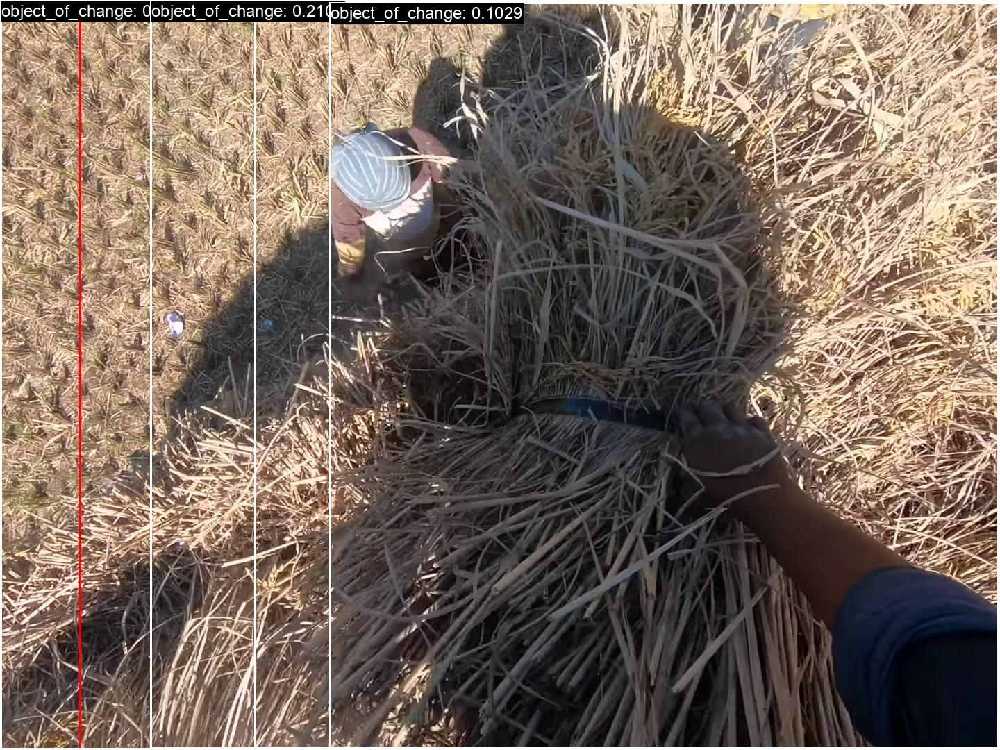

[{'AP50': 1.0, 'AP75': 1.0, 'bbox_score': 0.981526255607605},
 {'AP50': 1.0, 'AP75': 1.0, 'bbox_score': 0.41208314895629883},
 {'AP50': 1.0, 'AP75': 1.0, 'bbox_score': 0.21094785630702972},
 {'AP50': 1.0, 'AP75': 0.0, 'bbox_score': 0.10290542989969254}]
--------------------------------------------------


In [26]:
# To visualize one randomly sampled results, we can define certain criteria (can be none).
# individual precision score for AP50 is either 1 or 0 for each data point.
# So precision > 0 means correct, while <= 0 means wrong, for AP50 results.
# TODO(telinwu): when AP is incorporated, make the criteria more sophisticated.

# Current criteria is both result 3 and 4 should be wrong.
# TODO: can change the below criteria function.
best_k = 4
AP_KEY = "AP50" # From ["AP", "AP50", "AP75"], standard object detection average precision metrics.
BEST_AP_KEY = "Best-{}-{}".format(best_k, AP_KEY)
criteria = {
    # output_results_json_file_3: lambda x: (
    #     x["pnr_frame"][AP_KEY]["precision"] > 0 and
    #     # True
    #     x["pnr_frame"][BEST_AP_KEY]["precision"] > 0
    # ),
    # output_results_json_file_4: lambda x: (
    #     x["pnr_frame"][AP_KEY]["precision"] > 0 and
    #     x["pnr_frame"][BEST_AP_KEY]["precision"] > 0
    # ),
    output_results_json_file_12: lambda x: (
        x["pnr_frame"][AP_KEY]["precision"] > 0 and
        x["pnr_frame"][BEST_AP_KEY]["precision"] > 0
    ),
}
# criteria = None
keys_to_sample_from = keys

if criteria is not None:
    for file_name in criteria:
        fulfill_keys = []
        file_res = all_keyed_results[file_name]
        for data_key, data_res in file_res.items():
            if criteria[file_name](data_res):
                fulfill_keys.append(data_key)
        keys_to_sample_from = set(keys_to_sample_from).intersection(set(fulfill_keys))
    keys_to_sample_from = sorted(list(keys_to_sample_from))

print("Valid results fulfilling the criteria: {}".format(len(keys_to_sample_from)))
print()

# Randomly sample a key.
rand_key = np.random.choice(keys_to_sample_from)
# rand_key = "c431062e-857c-4e9f-ad5c-94f925acc822_5920"
# rand_key = "689848c0-6488-4a4e-871c-c19d986532a4_55167"
# rand_key = "23ecfb5c-6d29-40a6-b070-5be19ba3e86f_105378"
# rand_key = "aea0b0dd-5aa0-44b9-8740-a5be68062623_1450"
# rand_key = "7c0c0057-3bbc-40ef-a91e-4d6e1a637642_53652"
# rand_key = "3d3efb83-4b41-41e3-94db-50f0f22e67ef_150830"
# rand_key = "b493e8e3-4e18-4480-8e63-c21e25bf99f7_964"
# rand_key = "3d3efb83-4b41-41e3-94db-50f0f22e67ef_148338"
# rand_key = "90a0c76e-f62f-4f49-888f-5478b6ccab5b_5751"
# rand_key = "4066339d-b061-4550-a8fa-988fc4861714_19505"
print("{}: {}".format(bold_text("Sampled Key:"), rand_key))

additional_description = None # "The paintbrush."

# TODO: decide which inference file results should be shown.
named_result_tuple_list = [
    # (output_results_json_file_1, output_results["output_results_1"][rand_key]),
    # (output_results_json_file_2, output_results["output_results_2"][rand_key]),
    # (output_results_json_file_3, output_results["output_results_3"][rand_key]),
    # (output_results_json_file_4, output_results["output_results_4"][rand_key]),
    # (output_results_json_file_9, output_results["output_results_9"][rand_key]),
    # (output_results_json_file_10, output_results["output_results_10"][rand_key]),
    (output_results_json_file_12, output_results["output_results_12"][rand_key]),
]

# Gets the narration for reference.
clip_narrations, closest_narrations = get_scod_clipped_narrations(
    keyed_scod_clips[rand_key],
    all_narrations,
    curr_videos_root,
    narration_pass="narration_pass_1",
    anchor_frame="pnr",
    top_k=5,
    verbose=True,
)

# Show the results.
# `frame_keys` here define which frames to be shown.
# If the prediction results do not contain certain specified frames, the images
# will just show the GT bbox (in red).
# TODO: can change `bbox_width`, `label_font_size`, and `resize_image_width`,
# where the `resize_image_width` resizes image widht and height will follow the aspect ratio.

region_proposal_probings = {
    "caption_func": None,
    # "caption_func": model,
    # "clip_func": None,
    "clip_func": (clip_processor, clip_model),
    "srl_func": predictor_srl,
    # "dp_func": predictor_dp,
}
region_proposal_probings = None

visualize_glip_results_comparisons(
    named_result_tuple_list,
    #top_k_bboxes=top_k,
    top_k_bboxes=4,
    resize_image_width=None,
    # frame_keys=["pre", "pnr", "post"],
    # frame_keys=["pre", "pnr"],
    frame_keys=["pnr"],
    bbox_width=3,
    label_font_size=24,
    scod_clip=keyed_scod_clips[rand_key],
    image_folder="/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/pre_pnr_post_png_frames",
    region_proposal_probings=region_proposal_probings,
    narration=closest_narrations[0][-1],
    additional_description=additional_description,
    print_performance=True,
)

### GLIP Results Inspections

In [20]:
top_k = 1
best_k = 4

# Frames to be used as keys, a list, can include "pre", "post".
frame_keys = ["pnr"]

# Define the inference files here.
output_results_json_file_glip_large = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines"
    "/GLIP/narrated_scod_finetuning_large_v2/eval_ego4d_narrated_scod_val_finetuned_45K_gt_arg1"
    "/eval/model_0045000/inference/narrated_ego4d_test/bbox_with_gt.json"
)

# Compute overall performance.
all_keyed_results = compare_glip_results(
    [
        output_results_json_file_glip_large,
    ],
    frame_keys,
    top_k=top_k,
    first_k=None,
    best_k=best_k,
)

output_results_file_names = {
    "output_results_json_file_glip_large": output_results_json_file_glip_large,
}
output_results = {}
for file_key in output_results_file_names:
    output_results[file_key] = make_keyed_glip_results(
        output_results_file_names[file_key], frame_keys=frame_keys
    )

# Store the joint keys from all the used inference files.
keys = None
for res_key in sorted(output_results):
    if keys is None:
        keys = sorted(list(output_results[res_key].keys()))
    else:
        keys = set(keys).intersection(set(output_results[res_key].keys()))
keys = sorted(list(keys))
print("Joint keys num: {}".format(len(keys)))

Total results: 37592 of /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/narrated_scod_finetuning_large_v2/eval_ego4d_narrated_scod_val_finetuned_45K_gt_arg1/eval/model_0045000/inference/narrated_ego4d_test/bbox_with_gt.json


Results...: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 37592/37592 [01:05<00:00, 577.00it/s]


---- /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/narrated_scod_finetuning_large_v2/eval_ego4d_narrated_scod_val_finetuned_45K_gt_arg1/eval/model_0045000/inference/narrated_ego4d_test/bbox_with_gt.json ----
        Frame        AP      AP50      AP75  Best-4-AP  Best-4-AP50  Best-4-AP75
0   pre_frame  0.443879  0.590944  0.467754   0.590776     0.793185     0.625705
1   pnr_frame  0.450470  0.607081  0.468691   0.592084     0.804856     0.621815
2  post_frame  0.424712  0.563925  0.447517   0.575566     0.771871     0.609138
Joint keys num: 12733


In [21]:
# TODO: can change the below criteria function.
best_k = 4
AP_KEY = "AP50" # From ["AP", "AP50", "AP75"], standard object detection average precision metrics.
BEST_AP_KEY = "Best-{}-{}".format(best_k, AP_KEY)
criteria = {
    output_results_json_file_glip_large: lambda x: (
        x["pnr_frame"][AP_KEY]["precision"] <= 0 and
        x["pnr_frame"][BEST_AP_KEY]["precision"] > 0
    ),
}
# criteria = None
keys_to_sample_from = keys

if criteria is not None:
    for file_name in criteria:
        fulfill_keys = []
        file_res = all_keyed_results[file_name]
        for data_key, data_res in file_res.items():
            if criteria[file_name](data_res):
                fulfill_keys.append(data_key)
        keys_to_sample_from = set(keys_to_sample_from).intersection(set(fulfill_keys))
    keys_to_sample_from = sorted(list(keys_to_sample_from))

print("Valid results fulfilling the criteria: {}".format(len(keys_to_sample_from)))
print()

Valid results fulfilling the criteria: 2504



7dae465c-26d8-49a4-a9bb-b02d6524d542_1023
/local1/hu528/ego4d_data/v1/full_scale/7dae465c-26d8-49a4-a9bb-b02d6524d542.mp4 30
FPS: 30
Object of change: ['facemask']
Pre/PNR/Post frame = 1018 / 1023 / 1138
Pre/PNR/Post sec   = 0:00:33.93 / 0:00:34.10 / 0:00:37.93
[0:00:34.02-0:00:39.93](1020-1197) #C C Irons the face mask with the Iron on the Ironing board (v)
[0:00:32.97-0:00:34.02](989-1020) #C C picks up the Iron from the metal stand with her right hand (v)
[0:00:31.92-0:00:32.97](957-989) #C C drops the face mask on the Ironing board  
[0:00:39.93-0:00:43.13](1197-1293) #C C moves the face mask on the Ironing board with her left hand 
[0:00:27.88-0:00:31.92](836-957) #C C checks the face mask in her hands 
Tool: iron
--------------------------------------------------
Frame: pnr_frame
Method: /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/narrated_scod_finetuning_large_v2/eval_ego4d_narrated_scod_val_finetuned_45K_gt_arg1/eval/model_0045000/inference/narr

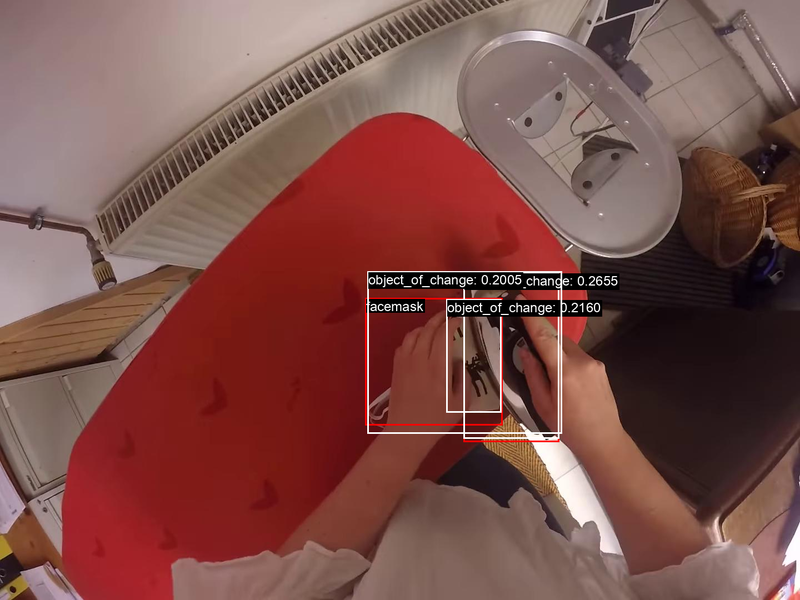

[{'AP50': 1.0, 'AP75': 1.0, 'bbox_score': 0.2654738426208496},
 {'AP50': 0.0, 'AP75': 0.0, 'bbox_score': 0.21596913039684296},
 {'AP50': 1.0, 'AP75': 0.0, 'bbox_score': 0.20054635405540466}]
--------------------------------------------------


In [22]:
# keys_to_sample_from = keys

# Randomly sample a key.
rand_key = np.random.choice(keys_to_sample_from)
# rand_key = "a850112c-68e3-45d7-9fc0-9ada21e970a4_17930"
# rand_key = "40eeac41-9ec3-4960-b0b3-77074a6ad5b3_4449"
# rand_key = "74d05939-ec8d-4da5-9a6f-35a0b97e22e2_906"  # Wrong annotations!
# rand_key = "d1f59fb1-5f81-4bd4-b3f1-81d69ab71ef6_10019"
# rand_key = "3906d25a-d0a4-4a7c-8906-a87cea106c66_61980" # Trowel
# rand_key = "ab5dc330-1bd2-40f2-87c1-dffd374e19a1_27533" # Crochet
rand_key = "7dae465c-26d8-49a4-a9bb-b02d6524d542_1023"
print(rand_key)

# TODO: decide which inference file results should be shown.
named_result_tuple_list = [
    (output_results_json_file_glip_large, output_results["output_results_json_file_glip_large"][rand_key]),
]

# Gets the narration for reference.
clip_narrations, closest_narrations = get_scod_clipped_narrations(
    keyed_scod_clips[rand_key],
    all_narrations,
    curr_videos_root,
    narration_pass="narration_pass_1",
    anchor_frame="pnr",
    top_k=5,
    verbose=True,
)
region_proposal_probings = None
object_types = [b["object_type"] for b in keyed_scod_clips[rand_key]["pnr_frame"]["bbox"]]
object_names = [b["structured_noun"] for b in keyed_scod_clips[rand_key]["pnr_frame"]["bbox"]]
if "tool" in object_types:
    print("{} {}".format(magenta_text(bold_text("Tool:")),
                         magenta_text(str(object_names[object_types.index("tool")]))))
else:
    print("{} {}".format(magenta_text(bold_text("Tool:")),
                         magenta_text("N/A")))

# Additional description to make.
additional_description = None # "The paintbrush."

visualize_glip_results_comparisons(
    named_result_tuple_list,
    top_k_bboxes=4,
    resize_image_width=800,
    # frame_keys=["pre", "pnr", "post"],
    frame_keys=["pnr"],
    bbox_width=3,
    label_font_size=24,
    scod_clip=keyed_scod_clips[rand_key],
    image_folder="/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/pre_pnr_post_png_frames",
    region_proposal_probings=region_proposal_probings,
    narration=closest_narrations[0][-1],
    additional_description=additional_description,
    draw_tool=True,
    print_performance=True,
)

In [23]:
top_k = 1
best_k = 4

# Frames to be used as keys, a list, can include "pre", "post".
frame_keys = ["pnr"]

# Define the inference files here.
output_results_json_file_inspect = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines"
    "/GLIP/narrated_scod_finetuning_large_v2/first_10_corrects/eval/model_0045000"
    "/inference/narrated_ego4d_test/bbox_with_gt.json"
)
output_results_json_file_inspect_new = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines"
    "/GLIP/narrated_scod_finetuning_large_v2/first_10_corrects_new/eval/model_0045000"
    "/inference/narrated_ego4d_test/bbox_with_gt.json"
)

# Compute overall performance.
inspect_keyed_results = compare_glip_results(
    [
        output_results_json_file_inspect,
        output_results_json_file_inspect_new,
    ],
    frame_keys,
    top_k=top_k,
    first_k=None,
    best_k=best_k,
)

inspect_results_file_names = {
    "output_results_json_file_inspect": output_results_json_file_inspect,
    "output_results_json_file_inspect_new": output_results_json_file_inspect_new,
}
inspect_results = {}
for file_key in inspect_results_file_names:
    inspect_results[file_key] = make_keyed_glip_results(
        inspect_results_file_names[file_key], frame_keys=frame_keys
    )

# Store the joint keys from all the used inference files.
inspect_keys = None
for res_key in sorted(inspect_results):
    if inspect_keys is None:
        inspect_keys = sorted(list(inspect_results[res_key].keys()))
    else:
        inspect_keys = set(inspect_keys).intersection(set(inspect_results[res_key].keys()))
inspect_keys = sorted(list(inspect_keys))
print("Joint keys num: {}".format(len(inspect_keys)))

# Compute performance solely on these jointly finished data (keyed).
inspect_results_as_list = {}
for res_key in sorted(inspect_results):
    inspect_results_as_list[inspect_results_file_names[res_key]] = [
        inspect_results[res_key][_key] for _key in inspect_keys
    ]

print(bold_text("Partial results aligned:"))
inspect_keyed_results = compare_glip_results(
    inspect_results_as_list,
    frame_keys,
    top_k=top_k,
    first_k=None,
    best_k=4,
)

Total results: 11 of /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/narrated_scod_finetuning_large_v2/first_10_corrects/eval/model_0045000/inference/narrated_ego4d_test/bbox_with_gt.json


Results...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████| 11/11 [00:00<00:00, 608.43it/s]


Total results: 11 of /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/narrated_scod_finetuning_large_v2/first_10_corrects_new/eval/model_0045000/inference/narrated_ego4d_test/bbox_with_gt.json


Results...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████| 11/11 [00:00<00:00, 609.17it/s]


---- /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/narrated_scod_finetuning_large_v2/first_10_corrects/eval/model_0045000/inference/narrated_ego4d_test/bbox_with_gt.json ----
        Frame        AP      AP50      AP75  Best-4-AP  Best-4-AP50  Best-4-AP75
0   pre_frame       NaN       NaN       NaN        NaN          NaN          NaN
1   pnr_frame  0.536364  0.636364  0.636364   0.709091     0.909091     0.818182
2  post_frame       NaN       NaN       NaN        NaN          NaN          NaN
---- /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/narrated_scod_finetuning_large_v2/first_10_corrects_new/eval/model_0045000/inference/narrated_ego4d_test/bbox_with_gt.json ----
        Frame        AP      AP50      AP75  Best-4-AP  Best-4-AP50  Best-4-AP75
0   pre_frame       NaN       NaN       NaN        NaN          NaN          NaN
1   pnr_frame  0.536364  0.636364  0.636364   0.709091     0.909091     0.818182
2  post_frame    

Results...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████| 11/11 [00:00<00:00, 609.94it/s]


Total results: 11 of /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/narrated_scod_finetuning_large_v2/first_10_corrects_new/eval/model_0045000/inference/narrated_ego4d_test/bbox_with_gt.json


Results...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████| 11/11 [00:00<00:00, 617.96it/s]

---- /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/narrated_scod_finetuning_large_v2/first_10_corrects/eval/model_0045000/inference/narrated_ego4d_test/bbox_with_gt.json ----
        Frame        AP      AP50      AP75  Best-4-AP  Best-4-AP50  Best-4-AP75
0   pre_frame       NaN       NaN       NaN        NaN          NaN          NaN
1   pnr_frame  0.536364  0.636364  0.636364   0.709091     0.909091     0.818182
2  post_frame       NaN       NaN       NaN        NaN          NaN          NaN
---- /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/narrated_scod_finetuning_large_v2/first_10_corrects_new/eval/model_0045000/inference/narrated_ego4d_test/bbox_with_gt.json ----
        Frame        AP      AP50      AP75  Best-4-AP  Best-4-AP50  Best-4-AP75
0   pre_frame       NaN       NaN       NaN        NaN          NaN          NaN
1   pnr_frame  0.536364  0.636364  0.636364   0.709091     0.909091     0.818182
2  post_frame    

8fb142f0-8eb4-4c90-8e3d-08d1bcc2314b_19920
/local1/hu528/ego4d_data/v1/full_scale/8fb142f0-8eb4-4c90-8e3d-08d1bcc2314b.mp4 30
FPS: 30
Object of change: ['wood_(fiber,_firewood,_floorboard,_log,_lumber,_plank,_plywood,_timber,_wood,_woodcraft,_woodwork)']
Pre/PNR/Post frame = 19845 / 19920 / 20026
Pre/PNR/Post sec   = 0:11:01.50 / 0:11:04 / 0:11:07.53
[0:11:03.89-0:12:31.34](19916-22540) #C C makes a hole in the wood frame with the marking knife and the mallet. (v)
[0:11:02.39-0:11:03.89](19871-19916) #C C holds the mallet with his right hand.  (v)
[0:10:58.78-0:10:58.78](19763-19763) #C C removes wood chaffs with the marking knife. .  
[0:10:58.78-0:11:02.39](19763-19871) #C C passes the marking knife from his right hand to his left hand.  (v)
[0:10:58.27-0:10:58.78](19748-19763) #C C holds the marking knife.  
--------------------------------------------------
Frame: pnr_frame
Method: /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/narrated_scod_finetuning

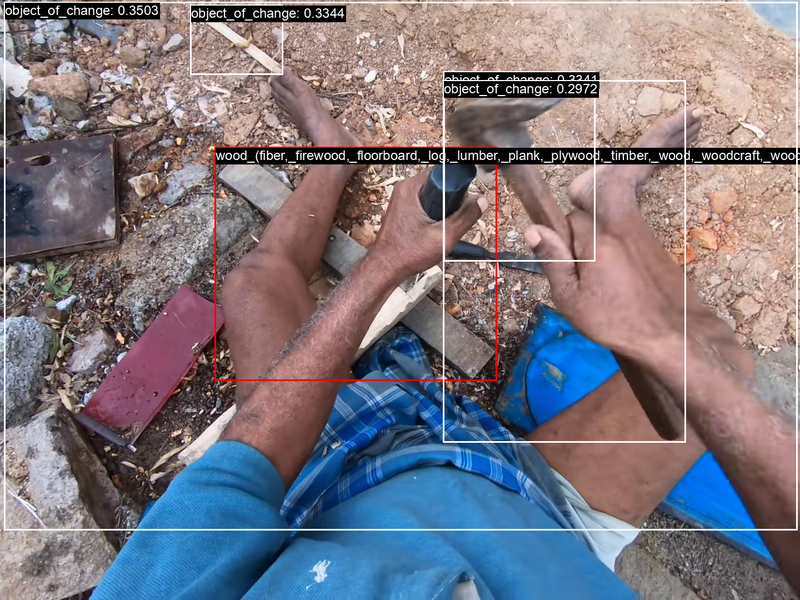

[{'AP50': 0.0, 'AP75': 0.0, 'bbox_score': 0.3502916395664215},
 {'AP50': 0.0, 'AP75': 0.0, 'bbox_score': 0.33438533544540405},
 {'AP50': 0.0, 'AP75': 0.0, 'bbox_score': 0.3340813219547272},
 {'AP50': 0.0, 'AP75': 0.0, 'bbox_score': 0.2972225546836853}]
--------------------------------------------------
Method: /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/narrated_scod_finetuning_large_v2/first_10_corrects_new/eval/model_0045000/inference/narrated_ego4d_test/bbox_with_gt.json
Used Narrations (if any): []


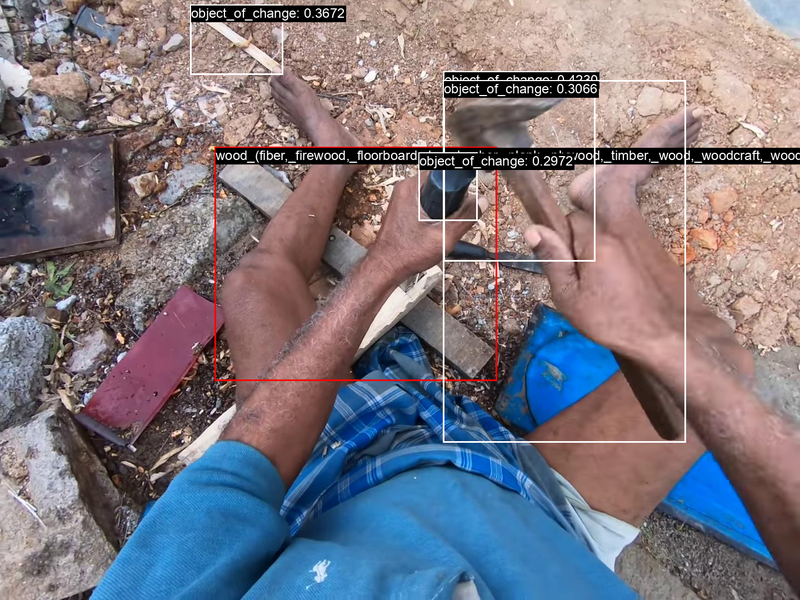

[{'AP50': 0.0, 'AP75': 0.0, 'bbox_score': 0.4230412542819977},
 {'AP50': 0.0, 'AP75': 0.0, 'bbox_score': 0.3672149181365967},
 {'AP50': 0.0, 'AP75': 0.0, 'bbox_score': 0.30658048391342163},
 {'AP50': 0.0, 'AP75': 0.0, 'bbox_score': 0.29724782705307007}]
--------------------------------------------------


In [24]:
inspect_keys_to_sample_from = inspect_keys

# Randomly sample a key.
# rand_key = "a850112c-68e3-45d7-9fc0-9ada21e970a4_17930"
# rand_key = "8bcd5b11-283d-41f9-9b34-8f70b75c2de9_879"  # Partial correct.
rand_key = "8fb142f0-8eb4-4c90-8e3d-08d1bcc2314b_19920"  # Wrong wood.
# rand_key = "40eeac41-9ec3-4960-b0b3-77074a6ad5b3_4449" # Bucket.
# rand_key = np.random.choice(inspect_keys_to_sample_from)
print(rand_key)

# TODO: decide which inference file results should be shown.
inspect_result_tuple_list = [
    (output_results_json_file_inspect, inspect_results["output_results_json_file_inspect"][rand_key]),
    (output_results_json_file_inspect_new, inspect_results["output_results_json_file_inspect_new"][rand_key]),
]

# Gets the narration for reference.
clip_narrations, closest_narrations = get_scod_clipped_narrations(
    keyed_scod_clips[rand_key],
    all_narrations,
    curr_videos_root,
    narration_pass="narration_pass_1",
    anchor_frame="pnr",
    top_k=5,
    verbose=True,
)
region_proposal_probings = None

visualize_glip_results_comparisons(
    inspect_result_tuple_list,
    top_k_bboxes=4,
    resize_image_width=800,
    # frame_keys=["pre", "pnr", "post"],
    frame_keys=["pnr"],
    bbox_width=3,
    label_font_size=24,
    scod_clip=keyed_scod_clips[rand_key],
    image_folder="/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/pre_pnr_post_png_frames",
    region_proposal_probings=region_proposal_probings,
    narration=closest_narrations[0][-1],
    additional_description=additional_description,
    print_performance=True,
)

#### Data with `Tools`

In [25]:
top_k = 1
best_k = 4

# Frames to be used as keys, a list, can include "pre", "post".
frame_keys = ["pnr"]

# Define the inference files here.
output_results_json_file_glip_large_tool_strict = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP"
    "/narrated_scod_finetuning_large_v2_gt_srl_arg1_with_tool"
    "/eval_ego4d_narrated_scod_val_finetuned_65K_with_tool_strict/eval/model_0065000"
    "/inference/narrated_ego4d_test/bbox_with_gt.json"
)

# Compute overall performance.
all_keyed_results = compare_glip_results(
    [
        output_results_json_file_glip_large_tool_strict,
    ],
    frame_keys,
    top_k=top_k,
    first_k=None,
    best_k=best_k,
)

output_results_file_names = {
    "output_results_json_file_glip_large_tool_strict": output_results_json_file_glip_large_tool_strict,
}
output_results = {}
for file_key in output_results_file_names:
    output_results[file_key] = make_keyed_glip_results(
        output_results_file_names[file_key], frame_keys=frame_keys
    )

# Store the joint keys from all the used inference files.
keys = None
for res_key in sorted(output_results):
    if keys is None:
        keys = sorted(list(output_results[res_key].keys()))
    else:
        keys = set(keys).intersection(set(output_results[res_key].keys()))
keys = sorted(list(keys))
print("Joint keys num: {}".format(len(keys)))

Total results: 5532 of /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/narrated_scod_finetuning_large_v2_gt_srl_arg1_with_tool/eval_ego4d_narrated_scod_val_finetuned_65K_with_tool_strict/eval/model_0065000/inference/narrated_ego4d_test/bbox_with_gt.json


Results...: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5532/5532 [00:10<00:00, 514.70it/s]


---- /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/narrated_scod_finetuning_large_v2_gt_srl_arg1_with_tool/eval_ego4d_narrated_scod_val_finetuned_65K_with_tool_strict/eval/model_0065000/inference/narrated_ego4d_test/bbox_with_gt.json ----
        Frame        AP      AP50      AP75  Best-4-AP  Best-4-AP50  Best-4-AP75
0   pre_frame  0.426173  0.535714  0.443367   0.581786     0.748980     0.607653
1   pnr_frame  0.436117  0.552766  0.451844   0.580328     0.751537     0.602459
2  post_frame  0.430868  0.536442  0.441050   0.600214     0.766881     0.616827
Joint keys num: 1874


In [26]:
# TODO: can change the below criteria function.
best_k = 4
AP_KEY = "AP50" # From ["AP", "AP50", "AP75"], standard object detection average precision metrics.
BEST_AP_KEY = "Best-{}-{}".format(best_k, AP_KEY)
criteria = {
    output_results_json_file_glip_large: lambda x: (
        x["pnr_frame"][AP_KEY]["precision"] <= 0 and
        x["pnr_frame"][BEST_AP_KEY]["precision"] > 0
    ),
}
criteria = None
keys_to_sample_from = keys

if criteria is not None:
    for file_name in criteria:
        fulfill_keys = []
        file_res = all_keyed_results[file_name]
        for data_key, data_res in file_res.items():
            if criteria[file_name](data_res):
                fulfill_keys.append(data_key)
        keys_to_sample_from = set(keys_to_sample_from).intersection(set(fulfill_keys))
    keys_to_sample_from = sorted(list(keys_to_sample_from))

print("Valid results fulfilling the criteria: {}".format(len(keys_to_sample_from)))
print()

Valid results fulfilling the criteria: 1874



a0d60a9f-380d-42d8-b73d-b652f639b060_8924
/local1/hu528/ego4d_data/v1/full_scale/a0d60a9f-380d-42d8-b73d-b652f639b060.mp4 30
FPS: 30
Object of change: ['engine_(assembly,_carburetor,_engine,_motor)']
Pre/PNR/Post frame = 8923 / 8924 / 8988
Pre/PNR/Post sec   = 0:04:57.43 / 0:04:57.47 / 0:04:59.60
[0:05:01.13-0:05:01.40](9034-9042) #C C drops the screwdriver in his left hand on the motorcycle. 
[0:05:01.40-0:05:03.01](9042-9090) #C C uses the plier in his right hand on the engine. 
[0:05:03.01-0:05:03.69](9090-9111) #C C holds the plier with his left hand. 
[0:05:03.69-0:05:08.44](9111-9253) #C C uses the plier in both hands on the engine. 
[0:04:48.43-0:05:01.13](8653-9034) #C C uses the screwdriver in his left hand and the plier in his right hand on the engine. 
Tool: plier
--------------------------------------------------
Frame: pnr_frame
Method: /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/narrated_scod_finetuning_large_v2_gt_srl_arg1_with_tool/eval_

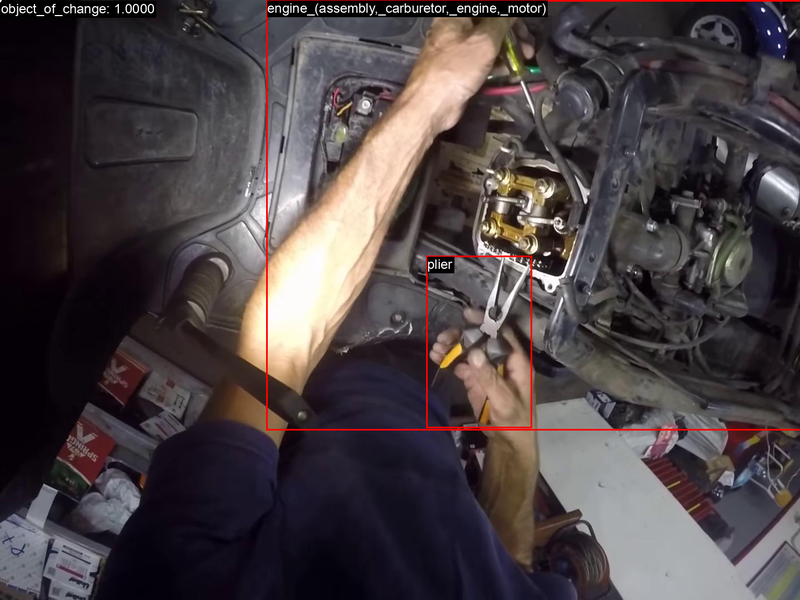

[{'AP50': 0.0, 'AP75': 0.0, 'bbox_score': 1.0}]
--------------------------------------------------


In [27]:
# Randomly sample a key.
rand_key = np.random.choice(keys_to_sample_from)
# rand_key = "817170ad-1f3b-44b1-9772-fe914fa17f30_91256"
# rand_key = "1321d3aa-dc41-4bee-94a7-559536885b88_13038"
print(rand_key)

# TODO: decide which inference file results should be shown.
named_result_tuple_list = [
    (output_results_json_file_glip_large_tool_strict,
     output_results["output_results_json_file_glip_large_tool_strict"][rand_key]),
]

# Gets the narration for reference.
clip_narrations, closest_narrations = get_scod_clipped_narrations(
    keyed_scod_clips[rand_key],
    all_narrations,
    curr_videos_root,
    narration_pass="narration_pass_1",
    anchor_frame="pnr",
    top_k=5,
    verbose=True,
)
region_proposal_probings = None
object_types = [b["object_type"] for b in keyed_scod_clips[rand_key]["pnr_frame"]["bbox"]]
object_names = [b["structured_noun"] for b in keyed_scod_clips[rand_key]["pnr_frame"]["bbox"]]
if "tool" in object_types:
    print("{} {}".format(magenta_text(bold_text("Tool:")),
                         magenta_text(str(object_names[object_types.index("tool")]))))
else:
    print("{} {}".format(magenta_text(bold_text("Tool:")),
                         magenta_text("N/A")))

# Additional description to make.
additional_description = None # "The paintbrush."

visualize_glip_results_comparisons(
    named_result_tuple_list,
    top_k_bboxes=4,
    resize_image_width=800,
    # frame_keys=["pre", "pnr", "post"],
    frame_keys=["pnr"],
    bbox_width=3,
    label_font_size=24,
    scod_clip=keyed_scod_clips[rand_key],
    image_folder="/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/pre_pnr_post_png_frames",
    region_proposal_probings=region_proposal_probings,
    narration=closest_narrations[0][-1],
    additional_description=additional_description,
    draw_tool=True,
    print_performance=True,
)

### Two-File Re-Ranking

In [197]:
from run_language_augmenting_bbox_preds import distractor_reranking

ooc_result_file = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP"
    # "/narrated_scod_finetuning_large_v2/first_10_corrects/eval/model_0045000"
    "/narrated_scod_finetuning_large_v2/tiny_exp_for_tools/eval/model_0045000"
    "/inference/narrated_ego4d_test/bbox.json"
)
dis_result_file = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP"
    # "/narrated_scod_finetuning_large_v2/first_10_corrects_new/eval/model_0045000"
    "/narrated_scod_finetuning_large_v2/tiny_exp_tool_only/eval/model_0065000"
    "/inference/narrated_ego4d_test/bbox.json"
)
output_file_name = "test.json"

print("Object-of-change file: {}".format(ooc_result_file))
print("Tool-of-action   file: {}".format(dis_result_file))

distractor_reranking(
    ooc_result_file=ooc_result_file,
    output_file_name=output_file_name,
    dis_result_file=dis_result_file,
    use_top_k_dis_bboxes=3,
    iou_thres=0.5,
)

Object-of-change file: /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/narrated_scod_finetuning_large_v2/tiny_exp_for_tools/eval/model_0045000/inference/narrated_ego4d_test/bbox.json
Tool-of-action   file: /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/narrated_scod_finetuning_large_v2/tiny_exp_tool_only/eval/model_0065000/inference/narrated_ego4d_test/bbox.json
Saving re-ranked file to: test.json


### Single-File Re-Ranking

In [280]:
from run_language_augmenting_bbox_preds import distractor_reranking

ooc_result_file = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP"
    "/narrated_scod_finetuning_large_v2_gt_srl_arg1_with_tool"
    "/eval_ego4d_narrated_scod_val_finetuned_65K_with_tool_strict"
    "/eval/model_0065000/inference/narrated_ego4d_test/bbox.json"
)
output_file_name = "test_new.json"

print("Object-of-change file: {}".format(ooc_result_file))

distractor_reranking(
    ooc_result_file=ooc_result_file,
    output_file_name=output_file_name,
    dis_result_file=None,
    use_top_k_dis_bboxes=1,
    iou_thres=0.3,
    ooc_category_id=1,
    dis_category_id=2,
)

Object-of-change file: /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/narrated_scod_finetuning_large_v2_gt_srl_arg1_with_tool/eval_ego4d_narrated_scod_val_finetuned_65K_with_tool_strict/eval/model_0065000/inference/narrated_ego4d_test/bbox.json
Saving re-ranked file to: test_new.json


# Off-The-Shelf Object Detectors

## GLIP Pure OD

In [28]:
def create_glip_config_file_for_od(
    object_clssses,
    ann_file="ego4d/annotations/ego4d_local_od.json",
    img_dir="/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/pre_pnr_post_frames",
    glip_config_file_template="../../GLIP/configs/ego4d/ego4d_template.yaml",
    glip_config_file_output="../../GLIP/configs/ego4d/new_od.yaml",
):
    override_category = []
    override_category_mapping = {}
    for i in range(len(object_clssses)):
        cat = {"id": i+1, "name": object_clssses[i], "supercategory": "object"}
        override_category.append(cat)
        override_category_mapping[i+1] = object_clssses[i]

    num_classes = len(object_clssses)
    to_revise = {
        "CAPTION_PROMPT": None,
        "OVERRIDE_CATEGORY": str(override_category),
        "NUM_CLASSES": str(num_classes+1),
        "img_dir": img_dir,
        "ann_file": ann_file,
    }
    
    glip_config_file = open(glip_config_file_output, "w")
    for line in open(glip_config_file_template):
        line = line.rstrip()
        for key in to_revise:
            if key in line and to_revise[key] is None:
                line = "  # {}".format(line.strip())
            elif key in line and key == "ann_file":
                line = line.replace("ego4d/annotations/ego4d_test.json", to_revise[key])
            elif key in line and key != "NUM_CLASSES":
                line = line.replace("TODO", to_revise[key].replace("\'", "\""))
            elif key in line:
                line = "    NUM_CLASSES: {}".format(to_revise[key])
        glip_config_file.write(line+"\n")
    glip_config_file.close()
    print("Config file saved at: {}".format(glip_config_file_output))
    return override_category, override_category_mapping, ann_file


def create_glip_dataset_file_for_od(
    image_file_names,
    override_category,
    img_dir="/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/pre_pnr_post_frames",
    coco_annots_test_json="../../GLIP/DATASET/ego4d/annotations/image_info_test-dev2017.json",
    output_dataset_file="../../GLIP/DATASET/ego4d/annotations/ego4d_local_od.json",
):
    coco_annots_test = json.load(open(coco_annots_test_json))
    new_d = {
        "info": coco_annots_test["info"],
        "images": [],
        "licenses": coco_annots_test["licenses"],
        "categories": override_category,
    }

    image_id = 0
    image_id_mapping = {}
    for image_file_name in image_file_names:
        img = Image.open(os.path.join(img_dir, image_file_name))
        width, height = img.width, img.height
        image_d = {
            "coco_url": "",
            "date_captured": "",
            "file_name": image_file_name,
            "height": height,
            "width": width,
            "license": 6,
            "id": image_id,
        }
        new_d["images"].append(image_d)
        image_id_mapping[image_id] = os.path.join(img_dir, image_file_name)
        image_id += 1

    json.dump(
        new_d,
        open(output_dataset_file, "w"),
        indent=4,
    )
    print("Saving dataset file at: {}".format(output_dataset_file))
    return image_id_mapping


def construct_local_od_results_dict(
    local_od_results_file,
    override_category_mapping,
):
    assert os.path.exists(local_od_results_file)
    local_od_results = json.load(open(local_od_results_file))
    local_od_results_dict = {}
    for local_od_result in local_od_results:
        image_id = local_od_result["image_id"]
        if image_id not in local_od_results_dict:
            local_od_results_dict[image_id] = []
        local_od_results_dict[image_id].append({
            "bbox": local_od_result["bbox"],
            "score": local_od_result["score"],
            "label": override_category_mapping[local_od_result["category_id"]],
        })
    for image_id in local_od_results_dict:
        local_od_results_dict[image_id] = sorted(
            local_od_results_dict[image_id],
            key=lambda x: x["score"],
            reverse=True
        )
    return local_od_results_dict


def plot_local_od_bboxes(
    image_id_mapping,
    local_od_results_dict,
    image_ids=0,
    top_k_bboxes=3,
    resize_image_width=None,
):
    if type(image_ids) is int:
        image_ids = [image_ids]
    assert type(image_ids) is list and type(image_ids[0]) is int
    
    for image_id in image_ids:
        image_path = image_id_mapping[image_id]
        curr_local_od_results = local_od_results_dict[image_id]
        assert os.path.exists(image_path)
        bboxed_frame_image = Image.open(image_path)
        image_name = "/".join(image_path.split("/")[-2:])
        print(image_name)
        for res in curr_local_od_results[:top_k_bboxes]:
            bbox = res["bbox"]
            score = res["score"]
            label = res["label"]
            # print(bbox)
            bboxed_frame_image = draw_bbox_on_image(
                bboxed_frame_image,
                [bbox[0], bbox[1], bbox[2], bbox[3]],
                label+": {:.4f}".format(score),
                bbox_width=4,
                label_font_size=30,
            )
        if (
            resize_image_width is not None
            and (type(resize_image_width) is int or
                 type(resize_image_width) is float)
        ):
            wpercent = (resize_image_width / float(bboxed_frame_image.size[0]))
            hsize = int((float(bboxed_frame_image.size[1]) * float(wpercent)))
            bboxed_frame_image = bboxed_frame_image.resize((resize_image_width, hsize), Image.Resampling.LANCZOS)
        display(bboxed_frame_image)
        pass ####
    pass ####


def create_glip_inference_script(
    script_file="../../GLIP/run_local_od_eval_large.sh",
    model_config=(
        "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines"
        "/GLIP/glip_model_zoo/glip_Swin_L.yaml"
    ),
    model_weight=(
        "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines"
        "/GLIP/glip_model_zoo/glip_large_model.pth"
    ),
    task_config="configs/ego4d/new_od.yaml",
    output_dir="local_od_results",
    gpu_id=0,
):
    assert os.path.exists(script_file), (
        "The template GLIP running script file {} does not exist!".format(script_file)
    )
    run_args = open(script_file)
    all_new_lines = []
    for line in run_args:
        line = line.rstrip()
        if "MODEL_CONFIG=" in line:
            new_line = "MODEL_CONFIG=\"{}\"".format(model_config)
        elif "MODEL_WEIGHT=" in line:
            new_line = "MODEL_WEIGHT=\"{}\"".format(model_weight)
        elif "TASK_CONFIG=" in line:
            new_line = "TASK_CONFIG=\"{}\"".format(task_config)
        elif "OUTPUT_DIR=" in line:
            new_line = "OUTPUT_DIR=\"{}\"".format(output_dir)
        elif "CUDA_VISIBLE_DEVICES=" in line:
            new_line = "CUDA_VISIBLE_DEVICES=\"{}\" \\".format(gpu_id)
        else:
            new_line = line
        all_new_lines.append(new_line)
    new_file = open(script_file, "w")
    for line in all_new_lines:
        new_file.write(line+"\n")
    new_file.close()
    pass

In [180]:
# Changes:
object_clssses = [
    # "knife",
    # "hammer",
    # "clip",
    # "sponge",
    "trowel",
    "stand",
    "crochet",
    "iron",
]
image_file_names = [
    # "8fb142f0-8eb4-4c90-8e3d-08d1bcc2314b/19920.jpg",
    # "d1f59fb1-5f81-4bd4-b3f1-81d69ab71ef6/10019.jpg",
    # "c396d137-e956-4a7f-ab2e-5a0b29c51afa/14054.jpg",
    "3906d25a-d0a4-4a7c-8906-a87cea106c66/61980.jpg",
    "c2b3e7ea-fbeb-4491-b5bc-d0dd723496f7/7096.jpg",
    "ab5dc330-1bd2-40f2-87c1-dffd374e19a1/27533.jpg",
    "7dae465c-26d8-49a4-a9bb-b02d6524d542/1023.jpg",
]
model_weight = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP"
    # "/glip_model_zoo/glip_large_model.pth"
    "/narrated_scod_finetuning_large_v2_gt_srl_arg1_with_tool/ft_task_1/model_0065000.pth"
)
gpu_id = 7

# Mostly unchange:
output_dir = "local_od_results"
glip_dataset_file = "ego4d/annotations/ego4d_local_od.json"
glip_config_file_output = "../../GLIP/configs/ego4d/new_od.yaml"
model_config = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines"
    "/GLIP/glip_model_zoo/glip_Swin_L.yaml"
)

# Get all the required files.
override_category, override_category_mapping, ann_file = create_glip_config_file_for_od(
    object_clssses,
    ann_file=glip_dataset_file,
    img_dir="/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/pre_pnr_post_frames",
    glip_config_file_template="../../GLIP/configs/ego4d/ego4d_template.yaml",
    glip_config_file_output=glip_config_file_output,
)
image_id_mapping = create_glip_dataset_file_for_od(
    image_file_names,
    override_category,
    img_dir="/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/pre_pnr_post_frames",
    coco_annots_test_json="../../GLIP/DATASET/ego4d/annotations/image_info_test-dev2017.json",
    output_dataset_file="../../GLIP/DATASET/{}".format(ann_file),
)
pprint.pprint(override_category)
pprint.pprint(override_category_mapping)
pprint.pprint(image_id_mapping)

create_glip_inference_script(
    script_file="../../GLIP/run_local_od_eval_large.sh",
    model_config=model_config,
    model_weight=model_weight,
    task_config=glip_config_file_output.split("../../GLIP/")[1],
    output_dir=output_dir,
    gpu_id=gpu_id,
)

Config file saved at: ../../GLIP/configs/ego4d/new_od.yaml
Saving dataset file at: ../../GLIP/DATASET/ego4d/annotations/ego4d_local_od.json
[{'id': 1, 'name': 'trowel', 'supercategory': 'object'},
 {'id': 2, 'name': 'stand', 'supercategory': 'object'},
 {'id': 3, 'name': 'crochet', 'supercategory': 'object'},
 {'id': 4, 'name': 'iron', 'supercategory': 'object'}]
{1: 'trowel', 2: 'stand', 3: 'crochet', 4: 'iron'}
{0: '/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/pre_pnr_post_frames/3906d25a-d0a4-4a7c-8906-a87cea106c66/61980.jpg',
 1: '/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/pre_pnr_post_frames/c2b3e7ea-fbeb-4491-b5bc-d0dd723496f7/7096.jpg',
 2: '/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/pre_pnr_post_frames/ab5dc330-1bd2-40f2-87c1-dffd374e19a1/27533.jpg',
 3: '/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/pre_pnr_post_frames/7dae465c-26d8-49a4-a9bb-b02d6524d542/1023.jpg'}


In [181]:
run_glip_commands=[
    "sh scripts/run_glip_local_od.sh",
]

for cmd in run_glip_commands:
    os.system(cmd)
clear_output()

3906d25a-d0a4-4a7c-8906-a87cea106c66/61980.jpg


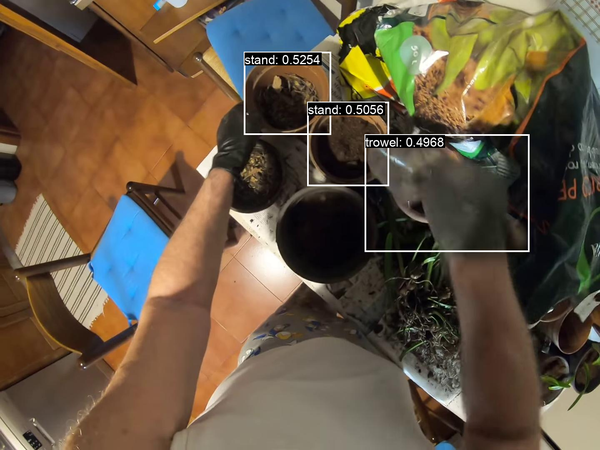

c2b3e7ea-fbeb-4491-b5bc-d0dd723496f7/7096.jpg


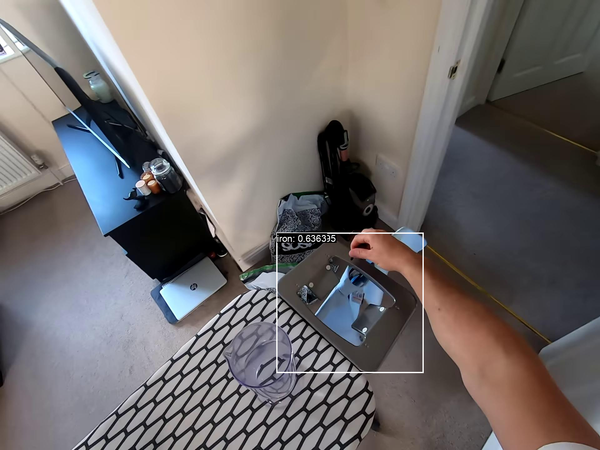

ab5dc330-1bd2-40f2-87c1-dffd374e19a1/27533.jpg


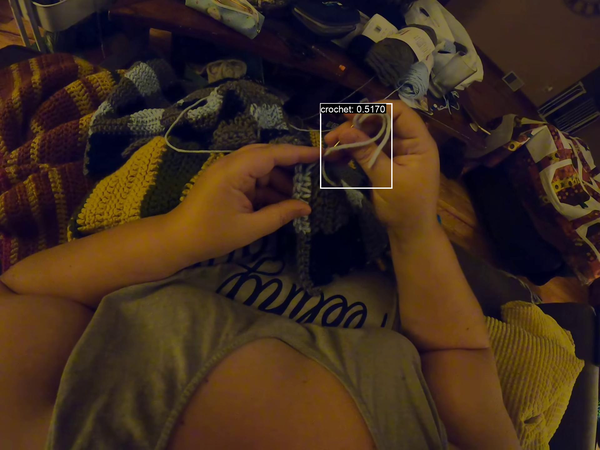

7dae465c-26d8-49a4-a9bb-b02d6524d542/1023.jpg


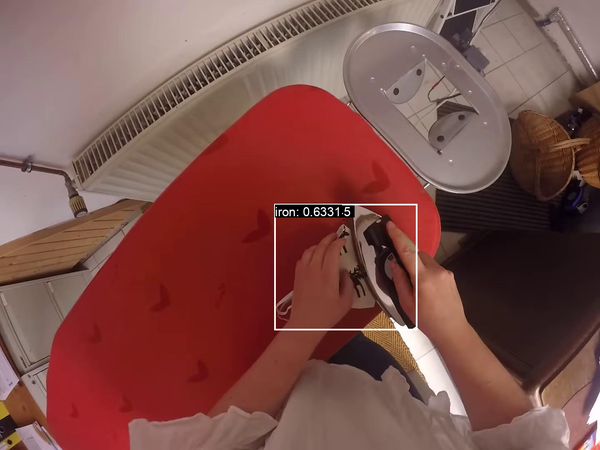

In [183]:
if "glip_model_zoo" in model_weight:
    local_od_results_file = "../../GLIP/local_od_results/eval/glip_large_model/inference/test/bbox.json"
else:
    ckpt_iter = model_weight.split("/")[-1].split(".pth")[0]
    local_od_results_file = "../../GLIP/local_od_results/eval/{}/inference/test/bbox.json".format(ckpt_iter)
local_od_results_dict = construct_local_od_results_dict(
    local_od_results_file,
    override_category_mapping,
)

image_ids = [
    0, 1, 2, 3
]

plot_local_od_bboxes(
    image_id_mapping,
    local_od_results_dict,
    image_ids=image_ids,
    top_k_bboxes=3,
    resize_image_width=600,
)

## Meta AI Detectron2

In [29]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [30]:
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
# CPU version
cfg.MODEL.DEVICE='cpu'
predictor = DefaultPredictor(cfg)

[05/18 18:36:09 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


In [39]:
im_path = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/pre_pnr_post_frames"
    # "/8fb142f0-8eb4-4c90-8e3d-08d1bcc2314b/19920.jpg"
    "/d1f59fb1-5f81-4bd4-b3f1-81d69ab71ef6/10019.jpg"
)
im = cv2.imread(im_path)
outputs = predictor(im)
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))

In [ ]:
pil_im = Image.fromarray(np.uint8(im[:, :, ::-1]))
pil_im_det = Image.fromarray(np.uint8(out.get_image()))
# display(pil_im)
display(pil_im_det)

# Re-Rank & Eval Functions

**Run once for the imports!**

In [31]:
# Use our own built-in customized COCO API.
sys.path.insert(0, "../cocoapi")

from PythonAPI.pycocotools.coco import COCO
from PythonAPI.pycocotools.cocoeval import COCOeval

import inspect
print("COCO API at:     {}".format(inspect.getfile(COCO)))
print("COCOeval API at: {}".format(inspect.getfile(COCOeval)))

# for auto-reloading external modules
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%reload_ext autoreload
%autoreload 2

COCO API at:     /home/telinwu/research/project_jarvis/modeling/../cocoapi/PythonAPI/pycocotools/coco.py
COCOeval API at: /home/telinwu/research/project_jarvis/modeling/../cocoapi/PythonAPI/pycocotools/cocoeval.py


In [32]:
def coco_results(
    coco_gt_data,
    coco_pred_data,
    top_k=None,
    ignore_summaries=None,
    verbose=False,
):
    coco_gt = COCO(annotation_file=coco_gt_data, verbose=verbose)
    coco_dt = coco_gt.loadRes(coco_pred_data)
    coco_eval = COCOeval(coco_gt, coco_dt, "bbox")
    coco_eval.params.verbose = verbose
    if top_k is not None:
        print("Using Top-{} Results!".format(top_k))
        coco_eval.params.maxDets = [top_k, top_k, top_k]
    coco_eval.evaluate()
    coco_eval.accumulate()
    coco_eval.summarize(ignore_summaries=ignore_summaries)
    return coco_eval

In [33]:
def compare_reranking_performance(
    results_dict=None,
    list_of_keys=None,
    rerank_func=None,
    narration_refine_func=None,
    curr_videos_root=None,
    all_narrations=None,
    keyed_scod_clips=None,
    frame_type="pnr",
    top_k=None,
):  
    images = []
    annotations = []
    predictions = []
    reranked_predictions = []
    
    # We only have `object_of_change` for now.
    categories = [
        {
            "id": 1,
            "name": "object_of_change",
            "supercategory": "object"
        }
    ]
    
    # IDs start with 1 for safer operations.
    # (As coco api uses logical not to define false positives.)
    _id = 1
    _annot_id = 1
    
    for key in list_of_keys:
        if "{}_frame".format(frame_type) not in results_dict[key]:
            continue
        result_to_use = results_dict[key]["{}_frame".format(frame_type)]
        gt_bboxes = result_to_use["gt_bboxes"]
        pred_bboxes = result_to_use["pred_bboxes"]
        image_folder = result_to_use["image_folder"]
        image_file_name = result_to_use["image_name"]
        image_path = os.path.join(image_folder, image_file_name)

        # Gets the narration for reference.
        clip_narrations, closest_narrations = get_scod_clipped_narrations(
            keyed_scod_clips[key],
            all_narrations,
            curr_videos_root,
            narration_pass="narration_pass_1",
            anchor_frame="pnr",
            top_k=5,
            verbose=False,
        )
        if len(closest_narrations) == 0:
            continue
        narration = narration_refine_func(closest_narrations[0][-1])
        
        _image = {
            "file_name": image_file_name,
            "width": 1920,
            "height": 1080,
            "id": _id,
        }
        images.append(_image)
        
        metadata = []
        for pred_bbox in pred_bboxes:
            bbox = pred_bbox["bbox"]
            cropped_bboxed_frame_image = Image.open(image_path).crop((
                bbox[0], bbox[1], bbox[0]+bbox[2], bbox[1]+bbox[3]
            ))
            _d = {
                "score": pred_bbox["score"],
                "narration": narration,
                "cropped_region": cropped_bboxed_frame_image,
                "bbox": pred_bbox["bbox"],
            }
            metadata.append(_d)
        
        scores_before = [round(x["score"], 3) for x in metadata]
        # Copy the metadata.
        reranked_metadata = copy.deepcopy(metadata)
        reranked_metadata = rerank_func(reranked_metadata)
        scores_after = [round(x["score"], 3) for x in reranked_metadata]
        print("Before Re-rank BBox Scores (cnt={}):\n{}".format(len(scores_before), scores_before))
        print("After  Re-rank BBox Scores (cnt={}):\n{}".format(len(scores_after), scores_after))
        
        for gt_bbox in gt_bboxes:
            for d in metadata:
                _pred = {
                    "image_id": _id,
                    "category_id": 1,
                    "bbox": d["bbox"],
                    "score": d["score"],
                }
                predictions.append(_pred)
            for reranked_d in reranked_metadata:
                _reranked_pred = {
                    "image_id": _id,
                    "category_id": 1,
                    "bbox": reranked_d["bbox"],
                    "score": reranked_d["score"],
                }
                reranked_predictions.append(_reranked_pred)
            bbox = [
                gt_bbox["bbox"]["x"],     gt_bbox["bbox"]["y"],
                gt_bbox["bbox"]["width"], gt_bbox["bbox"]["height"]
            ]
            _annotation = {
                "segmentation": [],
                "area": bbox[2]*bbox[3],
                "iscrowd": 0,
                "ignore": 0,
                "image_id": _id,
                "bbox": bbox,
                "category_id": 1,
                "id": _annot_id,
            }
            annotations.append(_annotation)
            _annot_id += 1
        
        _id += 1

    if len(images) == 0:
        raise ValueError("Nothing in constructed image data, perhaps specify different frame types?")
        
    coco_gt_data = {
        "images": images,
        "annotations": annotations,
        "categories": categories,
    }
    
    ignore_summaries = {"area": ["small", "medium", "large"]}
    
    print("---------- Performance Before Re-Ranking ----------")
    coco_pred_data = predictions
    coco_results(
        coco_gt_data,
        coco_pred_data,
        top_k=top_k,
        ignore_summaries=ignore_summaries,
        verbose=False,
    )
    
    print("---------- Performance After  Re-Ranking ----------")
    coco_pred_data = reranked_predictions
    coco_results(
        coco_gt_data,
        coco_pred_data,
        top_k=top_k,
        ignore_summaries=ignore_summaries,
        verbose=False,
    )
    
    return None

In [81]:
# Example usage.
# Note: re-ranking function needs to override the score field of the input data.
# Here the example is reverse the original ranking.
def naive_rerank_func(reranked_metadata):
    """
        metadata is a list of:
        {"bbox": ..., "label": ..., "score": ...}
    """
    assert type(reranked_metadata) is list and type(reranked_metadata[0]) is dict
    rev_scores = np.linspace(0, 1, len(reranked_metadata))
    for idx in range(len(reranked_metadata)):
        d = reranked_metadata[idx]
        d["score"] = rev_scores[idx]
        assert "narration" in d
    return reranked_metadata

# Arguments.
rerank_func = naive_rerank_func
results_dict = output_results["output_results_12"]
list_of_keys = [rand_key]
# Naive narration refine func, return identity narration.
narration_refine_func = lambda x: x

# Execute.
compare_reranking_performance(
    results_dict=results_dict,
    list_of_keys=list_of_keys,
    rerank_func=rerank_func,
    narration_refine_func=narration_refine_func,
    curr_videos_root=curr_videos_root,
    all_narrations=all_narrations,
    keyed_scod_clips=keyed_scod_clips,
    top_k=None,
)

Before Re-rank BBox Scores (cnt=15):
[0.982, 0.412, 0.211, 0.103, 0.09, 0.076, 0.058, 0.053, 0.049, 0.04, 0.038, 0.035, 0.029, 0.018, 0.017]
After  Re-rank BBox Scores (cnt=15):
[0.0, 0.071, 0.143, 0.214, 0.286, 0.357, 0.429, 0.5, 0.571, 0.643, 0.714, 0.786, 0.857, 0.929, 1.0]
---------- Performance Before Re-Ranking ----------
Evaluate annotation type *bbox*
DONE (t=0.00s).
Accumulating evaluation results...
DONE (t=0.00s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.800
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 1.000
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.700
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.900
---------- Performance After  Re-Ranking ----------
Evaluate annotation type *bbox*
DONE (t

### Other Logs

In [104]:
# Interested keys:
# 5f7e3f1e-f4db-461e-8344-c8f130985635_68630
# f6277269-1c87-439c-b5be-d4a02343018a_16740

# Most likely does not know what a jug is:
# c864505c-9d49-4da4-bf7e-254b4c348c03_48705

# DETR recognizes the wrong object for jug:
# c864505c-9d49-4da4-bf7e-254b4c348c03_47437

# GLIP does better:
# eaa817af-b7e0-4f0a-8156-73834cf1157b_27506

# Attributes of a pack?
# c8f8ebf1-5613-4f4a-802c-ada5e4c4b651_4225

# I feel the answer is ok, `cloth` should change state too.
# 8e23dc43-7025-4548-a2bd-0f7d85631602_10361

# GT is off
# 59815805-de31-4993-8f5e-f12b1537bcfc_60560

# `meals`
# 65c16752-c157-4a21-9654-d980f8fdf36c_9362

# detectors strong on hands
# 2d29b45a-169b-453f-8050-98ec147b0ccf_13605

# wrong cupboard
# c2a3d4ac-8d13-4daa-a9a9-a867999e956f_33554

# May need motion and better grounding
# 826e419a-8788-484f-9543-550964666762_60078

# Better inference may solve:
# 17324963-0877-482d-a189-11cc2862095c_39045

# To me, this is good:
# 5d8ebbea-6371-4be5-b611-751fb49ec294_18515

# Better inference may solve:
# c396d137-e956-4a7f-ab2e-5a0b29c51afa_9125

# Better inference may solve:
# 51224e32-3d6c-4148-9eea-7b73da751f25_8416

# ...

In [117]:
# Exemplar data on 3 categories for inference-only:

# GG!
# This one a better recognition of received object can probably do:
# dd28584f-13e1-4fd9-97c1-0cc9a2313868_52797
# af2bbd78-1898-4744-aa62-4feea65cc825_40934
# A good example of impacts of hand-occlusions
# c976bf0b-e005-40b6-8482-6c1431797edc_92774
# ...

# Ambiguous in GT.
# e84c2ee8-0e6a-4d77-953d-00fb5afd76c4_24814
# This one sandal can be ooc, too?
# 79c62f24-488e-4a69-8220-3b20cb4bf72b_139287
# ...

# We can probably do it!
# 002c3b5c-ed86-4af3-99a1-4b497b7c8a86_72441
# 0b8a87ed-07f2-4434-adde-a1c88f4bb30f_1817
# ...

In [87]:
glip_images_folder = "../../GLIP/DATASET/ego4d/frames/test"
glip_config_file_template = "../../GLIP/configs/ego4d/ego4d_template.yaml"
glip_config_file_output = "../../GLIP/configs/ego4d/ego4d_test_tmp.yaml"
coco_annots_test_json = "../../GLIP/DATASET/ego4d/annotations/image_info_test-dev2017.json"
output_dataset_file = "../../GLIP/DATASET/ego4d/annotations/ego4d_test_tmp.json"
run_glip_commands = [
    "sh scripts/run_glip_tmp.sh",
]
pred_bboxes_file = "../../GLIP/test_ego4d_eval_outputs_tmp/eval/glip_tiny_model_o365_goldg_cc_sbu/inference/test/bbox.json"
top_k_bboxes = 3
processed_scod_image_folder = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge"
    "/pre_pnr_post_png_frames"
)

Frame: pre_frame
Narrations: ['object_of_change']
Frame: pnr_frame
Narrations: ['object_of_change']


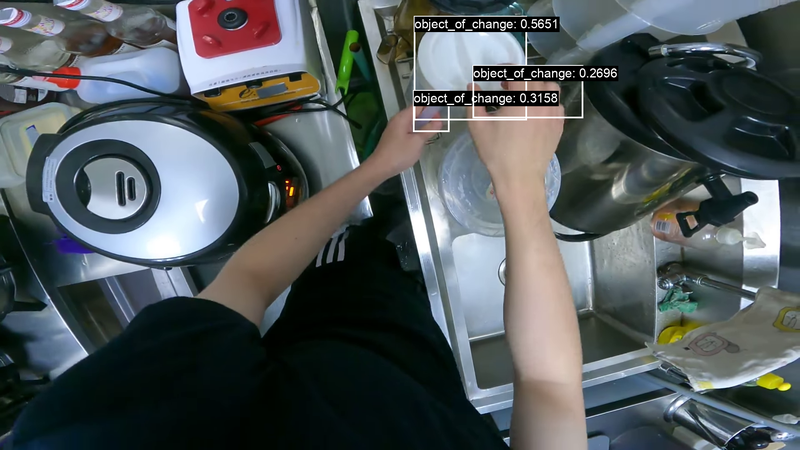

Frame: post_frame
Narrations: ['object_of_change']


In [127]:
narration = closest_narrations[0][-1]      
trimmed_narration = narration.split("#C ")[-1]
trimmed_narration = trimmed_narration.strip()
trimmed_narration = trimmed_narration.replace("C ", "A person ")
# trimmed_narration = trimmed_narration.replace("C ", "")

# Write some narrations.
# narration = ""
narration = trimmed_narration
narration = "object_of_change"

curr_pred_bboxes_file = (
    "../../GLIP/test_ego4d_eval_outputs_tmp/eval/glip_tiny_model_o365_goldg_cc_sbu/inference/test/bbox.json"
)
curr_pred_bboxes_file = (
    "../../GLIP/test_ego4d_eval_outputs_tmp/eval/model_0045000/inference/test/bbox.json"
)

# Current SCOD.
curr_used_scod = output_results["output_results_3"][rand_key]
frames_dict = {}
for fr in ["pre", "pnr", "post"]:
    if "{}_frame".format(fr) in curr_used_scod:
        frames_dict["{}_frame".format(fr)] = curr_used_scod["{}_frame".format(fr)]["frame_cnt"]
video_uid = rand_key.split("_")[0]

# GLIP Inference.
glip_inference_for_bboxes(
    narration,
    video_uid,
    frames_dict,
    glip_images_folder=glip_images_folder,
    glip_config_file_template=glip_config_file_template,
    glip_config_file_output=glip_config_file_output,
    coco_annots_test_json=coco_annots_test_json,
    output_dataset_file=output_dataset_file,
    run_glip_commands=run_glip_commands,
    pred_bboxes_file=curr_pred_bboxes_file,
    top_k_bboxes=top_k_bboxes,
    resize_image_width=800,
    processed_scod_image_folder=processed_scod_image_folder,
)

### Misc.

In [18]:
output_results_json_file_5 = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge"
    "/baselines/DETR"
    "/ego4dv2_pre_pnr_post_objects/inference/coco_instances_results_pnr2prepost_with_gt.json"
)

output_results_json_file_6 = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge"
    "/baselines/DETR"
    "/ego4dv2_pre_pnr_post_objects/inference/coco_instances_results_with_gt.json"
)

output_results_json_file_7 = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge"
    "/baselines/VideoIntern/ego4dv2_pre_pnr_post_objects/inference/coco_instances_results_pnr2prepost_with_gt.json"
)

# Compute overall performance.
_ = compare_glip_results(
    [
        output_results_json_file_5,
        output_results_json_file_6,
        output_results_json_file_7,
    ],
    frame_keys=["pre", "pnr", "post"],
    top_k=1,
    first_k=None,
    best_k=4,
)

Total results: 36885 of /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/DETR/ego4dv2_pre_pnr_post_objects/inference/coco_instances_results_pnr2prepost_with_gt.json


Results...: 100%|███████████████████████████████████████████████████████████████████████████████████████| 36885/36885 [01:12<00:00, 508.43it/s]


Total results: 36885 of /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/DETR/ego4dv2_pre_pnr_post_objects/inference/coco_instances_results_with_gt.json


Results...: 100%|███████████████████████████████████████████████████████████████████████████████████████| 36885/36885 [01:10<00:00, 526.44it/s]


Total results: 36885 of /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/VideoIntern/ego4dv2_pre_pnr_post_objects/inference/coco_instances_results_pnr2prepost_with_gt.json


Results...: 100%|███████████████████████████████████████████████████████████████████████████████████████| 36885/36885 [01:14<00:00, 493.72it/s]


---- /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/DETR/ego4dv2_pre_pnr_post_objects/inference/coco_instances_results_pnr2prepost_with_gt.json ----
        Frame        AP      AP50      AP75  Best-4-AP  Best-4-AP50  Best-4-AP75
0   pre_frame  0.181956  0.349102  0.168895   0.258998     0.502413     0.233921
1   pnr_frame  0.187117  0.363799  0.168447   0.268120     0.525774     0.238088
2  post_frame  0.173698  0.330619  0.157955   0.255345     0.490412     0.228614
---- /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/DETR/ego4dv2_pre_pnr_post_objects/inference/coco_instances_results_with_gt.json ----
        Frame        AP      AP50      AP75  Best-4-AP  Best-4-AP50  Best-4-AP75
0   pre_frame  0.228139  0.383277  0.228858   0.296488     0.510956     0.292145
1   pnr_frame  0.241106  0.408251  0.239180   0.305771     0.528270     0.298058
2  post_frame  0.217415  0.365905  0.218720   0.281692     0.483320     0.277997
---- /local1/tel

In [118]:
output_results_json_file_8 = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines"
    "/GLIP/naive_scod_finetuning_v1/eval_ego4d_scod_val_finetuned_45K"
    "/eval/model_0045000/inference/test/bbox_with_gt.json"
)

output_results_json_file_9 = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines"
    "/GLIP/narrated_scod_finetuning_v1/eval_ego4d_narrated_scod_val_finetuned_45K_full_sent"
    "/eval/model_0045000/inference/narrated_ego4d_test/bbox_with_gt.json"
)

# Compute overall performance.
_ = compare_glip_results(
    [
        output_results_json_file_8,
        output_results_json_file_9,
    ],
    frame_keys=["pnr"],
    top_k=1,
    first_k=None,
    best_k=4,
)

Total results: 12783 of /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/naive_scod_finetuning_v1/eval_ego4d_scod_val_finetuned_45K/eval/model_0045000/inference/test/bbox_with_gt.json


Results...: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12783/12783 [00:24<00:00, 520.07it/s]


Total results: 12783 of /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/narrated_scod_finetuning_v1/eval_ego4d_narrated_scod_val_finetuned_45K_full_sent/eval/model_0045000/inference/narrated_ego4d_test/bbox_with_gt.json


Results...: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 12783/12783 [00:16<00:00, 786.16it/s]


---- /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/naive_scod_finetuning_v1/eval_ego4d_scod_val_finetuned_45K/eval/model_0045000/inference/test/bbox_with_gt.json ----
        Frame        AP      AP50      AP75  Best-4-AP  Best-4-AP50  Best-4-AP75
0   pre_frame       NaN       NaN       NaN        NaN          NaN          NaN
1   pnr_frame  0.329218  0.484237  0.346789   0.487147     0.729641     0.511461
2  post_frame       NaN       NaN       NaN        NaN          NaN          NaN
---- /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/narrated_scod_finetuning_v1/eval_ego4d_narrated_scod_val_finetuned_45K_full_sent/eval/model_0045000/inference/narrated_ego4d_test/bbox_with_gt.json ----
        Frame        AP      AP50      AP75  Best-4-AP  Best-4-AP50  Best-4-AP75
0   pre_frame       NaN       NaN       NaN        NaN          NaN          NaN
1   pnr_frame  0.341438  0.495111  0.356333   0.406939     0.597512     0.422905


In [122]:
output_results_json_file_v2_narr_full_sent = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines"
    "/GLIP/narrated_scod_finetuning_v2/eval_ego4d_narrated_scod_val_finetuned_45K_full_sent"
    "/eval/model_0045000/inference/narrated_ego4d_test/bbox_with_gt.json"
)

output_results_json_file_v2_narr_arg1_only = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines"
    "/GLIP/narrated_scod_finetuning_v2/eval_ego4d_narrated_scod_val_finetuned_45K_arg1_only"
    "/eval/model_0045000/inference/narrated_ego4d_test/bbox_with_gt.json"
)

output_results_json_file_v2_narr_gt_arg1 = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines"
    "/GLIP/narrated_scod_finetuning_v2/eval_ego4d_narrated_scod_val_finetuned_45K_gt_arg1"
    "/eval/model_0045000/inference/narrated_ego4d_test/bbox_with_gt.json"
)

# Compute overall performance.
_ = compare_glip_results(
    [
        output_results_json_file_v2_narr_full_sent,
        output_results_json_file_v2_narr_arg1_only,
        output_results_json_file_v2_narr_gt_arg1,
    ],
    frame_keys=["pre", "pnr", "post"],
    top_k=1,
    first_k=None,
    best_k=4,
)

Total results: 37592 of /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/narrated_scod_finetuning_v2/eval_ego4d_narrated_scod_val_finetuned_45K_full_sent/eval/model_0045000/inference/narrated_ego4d_test/bbox_with_gt.json


Results...: 100%|███████████████████████████████████████████████████████████████████████████████████| 37592/37592 [00:52<00:00, 717.42it/s]


Total results: 37592 of /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/narrated_scod_finetuning_v2/eval_ego4d_narrated_scod_val_finetuned_45K_arg1_only/eval/model_0045000/inference/narrated_ego4d_test/bbox_with_gt.json


Results...: 100%|███████████████████████████████████████████████████████████████████████████████████| 37592/37592 [01:08<00:00, 552.00it/s]


Total results: 37592 of /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/narrated_scod_finetuning_v2/eval_ego4d_narrated_scod_val_finetuned_45K_gt_arg1/eval/model_0045000/inference/narrated_ego4d_test/bbox_with_gt.json


Results...: 100%|███████████████████████████████████████████████████████████████████████████████████| 37592/37592 [01:10<00:00, 536.97it/s]


---- /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/narrated_scod_finetuning_v2/eval_ego4d_narrated_scod_val_finetuned_45K_full_sent/eval/model_0045000/inference/narrated_ego4d_test/bbox_with_gt.json ----
        Frame        AP      AP50      AP75  Best-4-AP  Best-4-AP50  Best-4-AP75
0   pre_frame  0.367465  0.504574  0.385882   0.454658     0.634472     0.477664
1   pnr_frame  0.380012  0.527099  0.398256   0.464474     0.655792     0.487108
2  post_frame  0.355963  0.487326  0.376321   0.442567     0.615892     0.466667
---- /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines/GLIP/narrated_scod_finetuning_v2/eval_ego4d_narrated_scod_val_finetuned_45K_arg1_only/eval/model_0045000/inference/narrated_ego4d_test/bbox_with_gt.json ----
        Frame        AP      AP50      AP75  Best-4-AP  Best-4-AP50  Best-4-AP75
0   pre_frame  0.373479  0.516847  0.390989   0.513485     0.719165     0.542689
1   pnr_frame  0.382207  0.533789  0.399534 

### New Eval Functions

In [158]:
from coco_eval import get_avg_precision_at_iou
from coco_eval import get_single_image_results
from coco_eval import calc_precision_recall

In [251]:
##################################################################
raw_results_json_file_v2_narr = output_results_json_file_v2_narr_gt_arg1.replace(
    "bbox_with_gt", "bbox"
)
gt_file = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge"
    "/coco_annotations_all_frames/val_narrated_gt_srl_arg1.json"
)

raw_results_json_file_v2_narr = output_results_json_file_v2_narr_full_sent.replace(
    "bbox_with_gt", "bbox"
)
gt_file = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge"
    "/coco_annotations_all_frames/val_narrated_ground_full_sentence.json"
)

raw_results_json_file_v2_narr = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines"
    "/GLIP/narrated_scod_finetuning_v1/eval_ego4d_narrated_scod_val_finetuned_45K_pnr2prepost_arg1_only"
    "/eval/model_0045000/inference/narrated_ego4d_test/bbox.json"
)
gt_file = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge"
    "/coco_annotations_all_frames/val_narrated_srl_arg1_only.json"
)
##################################################################

res = json.load(open(raw_results_json_file_v2_narr))
gts = json.load(open(gt_file))["annotations"]

gt_dict = {}
for gt in gts:
    image_id = gt["image_id"]
    if image_id not in gt_dict:
        gt_dict[image_id] = []
    gt_bbox = [
        gt["bbox"][0],               gt["bbox"][1],
        gt["bbox"][0]+gt["bbox"][2], gt["bbox"][1]+gt["bbox"][3],
    ]
    gt_dict[image_id].append(gt_bbox)
print(len(gt_dict))

res_dict = {}
for r in res:
    image_id = r["image_id"]
    if image_id not in res_dict:
        res_dict[image_id] = []
    r_bbox = [
        r["bbox"][0],              r["bbox"][1],
        r["bbox"][0]+r["bbox"][2], r["bbox"][1]+r["bbox"][3],
    ]
    res_dict[image_id].append((r["score"], r_bbox))
print(len(res_dict))

for image_id in sorted(gt_dict):
    if image_id not in res_dict:
        res_dict[image_id] = [(1.0, [0, 0, 1, 1])]
        continue
    res_dict[image_id] = sorted(res_dict[image_id], reverse=True)
    # res_dict[image_id] = [v for u,v in res_dict[image_id]]

36885
36665


In [248]:
overall_prec, overall_reca = [], []

img_results = {}
for image_id in sorted(res_dict):
    if image_id not in gt_dict:
        print(image_id)
        continue
    gt_bboxes = gt_dict[image_id]
    # pred_bboxes = [v for u,v in res_dict[image_id]][0:len(gt_bboxes)]
    pred_bboxes = [v for u,v in res_dict[image_id]][0:100]
    # if len(pred_bboxes) == 0:
    #     pred_bboxes = [[0, 0, 1, 1]]
    map_res = get_single_image_results(gt_bboxes, pred_bboxes, iou_thr=0.5)
    img_results[image_id] = map_res

avg_prec, avg_reca = calc_precision_recall(img_results)
print("AP: {:.4f}  AR: {:.4f}".format(avg_prec, avg_reca))

precisions = np.asarray([avg_prec])
recalls = np.asarray([avg_reca])

prec_at_rec = []
for recall_level in np.linspace(0.0, 1.0, 101):
    try:
        args = np.argwhere(recalls >= recall_level).flatten()
        prec = max(precisions[args])
    except ValueError:
        prec = 0.0
    prec_at_rec.append(prec)
avg_prec = np.mean(prec_at_rec)
print(avg_prec)

AP: 0.0696  AR: 0.7635
0.0530479964679433


In [280]:
####
def get_top_K_json_file(results_json_file, top_k=1):
    new_results_json_file = results_json_file.replace("bbox.json", "bbox_top1.json")
    res = json.load(open(results_json_file))
    res_dict = {}
    for r in res:
        image_id = r["image_id"]
        if image_id not in res_dict:
            res_dict[image_id] = []
        res_dict[image_id].append((r["score"], r))
    new_res = []
    for image_id in res_dict:
        res_dict[image_id] = sorted(res_dict[image_id], reverse=True, key=lambda x: x[0])
        res_dict[image_id] = [v for u, v in res_dict[image_id]]
        res_dict[image_id] = res_dict[image_id][0:top_k]
        new_res += res_dict[image_id]
    json.dump(
        new_res,
        open(new_results_json_file, "w"),
        indent=4,
    )
    print("Saving top-{} result file to: {}".format(top_k, new_results_json_file))
    return new_results_json_file
####

In [202]:
raw_results_json_file_v2_narr_full_sent = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines"
    "/GLIP/narrated_scod_finetuning_v2/eval_ego4d_narrated_scod_val_finetuned_45K_full_sent"
    "/eval/model_0045000/inference/narrated_ego4d_test/bbox.json"
)
raw_results_json_file_v2_narr_arg1_only = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines"
    "/GLIP/narrated_scod_finetuning_v2/eval_ego4d_narrated_scod_val_finetuned_45K_arg1_only"
    "/eval/model_0045000/inference/narrated_ego4d_test/bbox.json"
)
raw_results_json_file_v2_narr_gt_arg1 = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/baselines"
    "/GLIP/narrated_scod_finetuning_v2/eval_ego4d_narrated_scod_val_finetuned_45K_gt_arg1"
    "/eval/model_0045000/inference/narrated_ego4d_test/bbox.json"
)

gt_file_full_sent = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge"
    "/coco_annotations_all_frames/val_narrated_ground_full_sentence.json"
)
gt_file_arg1_only = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge"
    "/coco_annotations_all_frames/val_narrated_srl_arg1_only.json"
)
gt_file_gt_arg1 = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge"
    "/coco_annotations_all_frames/val_narrated_gt_srl_arg1.json"
)

# Official SCOD Test Set

In [47]:
scod_videos_root = "/local1/hu528/ego4d_data/v1/full_scale/"
test_file = "/local1/telinwu/research/resources/Ego4D/ego4d_data/v1/annotations/fho_scod_test_unannotated.json"
# test_file = "/local1/telinwu/research/resources/Ego4D/ego4d_data/v1/annotations/fho_scod_val.json"
test_set = json.load(open(test_file))["clips"]
unique_video_ids = {}
for clip in tqdm(test_set, desc="SCOD"):
    video_uid = clip["video_uid"]
    if video_uid not in unique_video_ids:
        unique_video_ids[video_uid] = 0
    unique_video_ids[video_uid] += 1

SCOD: 100%|██████████████████████████████████████████████████████████████████████████████████████████████| 662898/662898 [00:00<00:00, 2081776.52it/s]


In [50]:
video_not_there = 0
for video_uid in sorted(unique_video_ids):
    if not os.path.exists(os.path.join(scod_videos_root, "{}.mp4".format(video_uid))):
        print(video_uid)
        video_not_there += 1
print(len(unique_video_ids))
# pprint.pprint(unique_video_ids)
print(video_not_there)

02d1f024-1470-4ce6-acde-b938f7847eb6
03f46720-8327-4215-ba56-5d739f6795ef
04994ce8-9d47-44d6-a7b0-42b395e69390
054992d4-aa9a-4904-8699-3ecf422e0312
057670b3-f243-416c-b41b-82d309fd2b88
0755c2cb-eb91-4e44-aac6-19b5237befd5
07b357ce-0bce-4d5e-b7ab-c16f1d4c7de6
08d94a5d-7c4b-4b1c-af12-c1ceb53c51c8
0a02a1ed-a327-4753-b270-e95298984b96
0cb95a59-008a-4087-b8dc-2299ded5617d
0d807e15-cf55-4038-83c4-d064a9ec2b46
0ee70fb4-ac6d-4da8-80e6-f5a94834eb10
0fb8012d-430d-4b45-a8eb-5fd8cb43f5b0
11ea0e12-7398-48d0-a674-1c66da3a55eb
14177ca9-924f-4e68-b218-6009dbddc7cc
141e08b9-c464-4b6f-9642-d9268ce419ae
14a05360-fcc4-4bf6-97d3-2d77bc282c84
16c21f86-6bd6-4dd7-a9b6-d98fa9e47808
18e08efb-e95e-49cb-bc89-d7695d3a2ab9
1938c632-f575-49dd-8ae0-e48dbb467920
1aa28dec-e81d-4a76-b808-b804efaae529
1b9c07d3-0656-48ad-bae4-cca25f6664c9
1cccdb19-2eb3-4ab7-ab74-58c9b425a68c
1da50887-dd33-4644-9377-1bf855b86ffd
1da68f69-6fa2-4a1f-b763-14181861a617
1dac32da-dcbe-45cb-8ee5-ca1c5b4df01e
1df0665a-91f7-48ff-b74d-0e4b1c3729e0
1

# GPT Inspections

In [208]:
import copy
from video_processing_utils import parse_ego4d_scod_structured_noun, extract_ooc_spans

# for auto-reloading external modules
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [209]:
split = "val"

raw_scod_file = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_data/v1/annotations/fho_scod_{}.json".format(split)
)
file_from_gt = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data"
    "/all_frames/narrated/gt_srl_arg1/{}_scod_all_frames_narrated_gt_srl_arg1_with_tool.json".format(split)
)
file_from_gpt = (
    "/local1/bryanzhou008/jarvis/GPT/{}_res.json".format(split)
)

raw_data = json.load(open(raw_scod_file))["clips"]
gt_nouns = {}
for clip in raw_data:
    video_uid = clip["video_uid"]
    for fr in ["pre", "pnr", "post"]:
        fr_name = "{}_frame".format(fr)
        fr_info = clip[fr_name]
        frame_num = fr_info["frame_number"]
        bbox_info = fr_info["bbox"]
        _id = "{}_{}_{}".format(video_uid, frame_num, fr)
        if _id not in gt_nouns:
            gt_nouns[_id] = {
                "ooc": [],
                "tool": [],
            }
        for bbox in bbox_info:
            if bbox["object_type"] == "tool":
                gt_nouns[_id]["tool"].append(bbox["structured_noun"])
            elif bbox["object_type"] == "object_of_change":
                gt_nouns[_id]["ooc"].append(bbox["structured_noun"])
    pass
print(len(gt_nouns))

data_from_gt = json.load(open(file_from_gt))["images"]
data_from_gpt = json.load(open(file_from_gpt))["images"]
assert len(data_from_gt) == len(data_from_gpt)
print(len(data_from_gt))

38221
38403


In [235]:
indices = np.arange(0, len(data_from_gt))

# indices = [idx for idx in indices if len(data_from_gt[idx]["tokens_positive_eval"]) > 1]

indices = [
    idx for idx in indices
    if data_from_gt[idx]["tokens_positive_eval"][0] != data_from_gpt[idx]["tokens_positive_eval"][0]
]
print(len(indices))

17319


In [286]:
rand_idx = np.random.choice(indices)
_id_gt = data_from_gt[rand_idx]["ego4d_scod_id"]
_id_gpt = data_from_gpt[rand_idx]["ego4d_scod_id"]
assert _id_gt == _id_gpt
_id = "_".join(_id_gt.split("_")[:-1])
curr_gt_noun = gt_nouns[_id]
caption_gt = data_from_gt[rand_idx]["caption"]
caption_gpt = data_from_gt[rand_idx]["caption"]
assert caption_gt == caption_gpt
caption = caption_gpt

print("{}: {}".format(bold_text("Data Index"), rand_idx))
print(blue_text(caption))

for obj_type in ["ooc", "tool"]:
    class_id = 1 if obj_type == "ooc" else 2
    curr_gts = list(set(gt_nouns[_id][obj_type]))
    print("---------- {} ----------".format(obj_type))
    print("GT structured noun for {}: {}".format(obj_type, curr_gts))
    for str_noun in list(set(gt_nouns[_id][obj_type])):
        obj_spans = []
        if str_noun is None:
            pass
        else:
            possible_gt_nouns = parse_ego4d_scod_structured_noun(str_noun)
            obj_spans, _ = extract_ooc_spans(
                caption,
                possible_gt_nouns,
                tokens_positive_method="gt",
                force_gt=True,
            )
        
        if len(obj_spans) > 0:
            print("GT span of {}: {}, phrase: {}".format(
                obj_type, obj_spans[0], caption[obj_spans[0][0]:obj_spans[0][1]]))
        else:
            print("GT not found in caption.")
            if len(data_from_gt[rand_idx]["tokens_positive_eval"]) >= class_id:
                srl_spans = data_from_gt[rand_idx]["tokens_positive_eval"][class_id-1][0]
                print("GT using span of {}: {}, phrase: {}".format(
                    obj_type, srl_spans, caption[srl_spans[0]:srl_spans[1]]))
    if len(curr_gts) == 0:
        if len(data_from_gt[rand_idx]["tokens_positive_eval"]) >= class_id:
            srl_spans = data_from_gt[rand_idx]["tokens_positive_eval"][class_id-1][0]
            print("GT using span of {}: {}, phrase: {}".format(
                obj_type, srl_spans, caption[srl_spans[0]:srl_spans[1]]))
    if "symbolic" in data_from_gpt[rand_idx]:
        print("GPT {}: {}".format(obj_type, data_from_gpt[rand_idx]["symbolic"][obj_type]))
        if len(data_from_gpt[rand_idx]["tokens_positive_eval"]) >= class_id:
            gpt_spans = data_from_gpt[rand_idx]["tokens_positive_eval"][class_id-1][0]
            print("GPT span of {}: {}, phrase: {}".format(
                obj_type, gpt_spans, caption[gpt_spans[0]:gpt_spans[1]]))
        else:
            print("GPT spans not found in caption.")
    else:
        print("GPT did not do this one!")
    pass

Data Index: 15437
Someone turns the white round neck off the pressing board with both hands 
---------- ooc ----------
GT structured noun for ooc: ['cloth_(cloth,_fabric,_garment,_kanga,_rag)']
Weird narration: Someone turns the white round neck off the pressing board with both hands  with token ``.
GT not found in caption.
GT using span of ooc: [14, 34], phrase: the white round neck
GPT ooc: white round neck
GPT span of ooc: [18, 34], phrase: white round neck
---------- tool ----------
GT structured noun for tool: []
GPT tool: pressing board
GPT span of tool: [43, 57], phrase: pressing board


### Remove Tool

In [394]:
split = "train"
input_file = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data"
    "/all_frames/narrated/gpt_v2_with_tool/{}_scod_all_frames_narrated_gpt_v2_with_tool.json".format(split)
)

data = json.load(open(input_file))
data_images = data["images"]
new_images = []
for d_image in data_images:
    d_image["tokens_positive_eval"] = [d_image["tokens_positive_eval"][0]]
    new_images.append(d_image)
data_annots = data["annotations"]
new_annots = []
for d_annot in data_annots:
    if d_annot["category_id"] == 1:
        new_annots.append(d_annot)
for _id in range(len(new_annots)):
    new_annots[_id]["id"] = _id
data["images"] = new_images
data["annotations"] = new_annots
data["categories"] = [x for x in data["categories"] if x["name"] == "object_of_change"]

json.dump(
    data,
    open(
        input_file.replace("with_tool", "wo_tool"),
        "w"
    ),
    indent=4,
)
print("Saving file to: {}".format(input_file.replace("with_tool", "wo_tool")))

Saving file to: /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames/narrated/gpt_v2_wo_tool/train_scod_all_frames_narrated_gpt_v2_wo_tool.json


### Make the GPT data to utilize some GT stuff (e.g., `SRL-ARG1`)

In [476]:
split = "train"
# gpt_name = "gpt_v1_wo_tool"
# gpt_name = "gpt_v1_with_tool"
# gpt_name = "gpt_v2_wo_tool"
# gpt_name = "gpt_v2_with_tool"
gpt_name = "gpt_v3_with_tool"

# gpt_new_name = "gpt_v1_srl_arg1_wo_tool"
# gpt_new_name = "gpt_v1_srl_arg1_with_tool"
# gpt_new_name = "gpt_v2_srl_arg1_wo_tool"
# gpt_new_name = "gpt_v2_srl_arg1_with_tool"
gpt_new_name = "gpt_v3_srl_arg1_with_tool"

gpt_data_file = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge"
    "/paper_data/all_frames/narrated/{}/raw_{}_scod_all_frames_narrated_{}.json".format(
        gpt_name, split, gpt_name)
)
org_data_file = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge"
    # "/paper_data/all_frames/narrated/gt_srl_arg1/{}_scod_all_frames_narrated_gt_srl_arg1.json".format(split)
    "/paper_data/all_frames/narrated/gt_srl_arg1/{}_scod_all_frames_narrated_gt_srl_arg1_with_tool.json".format(split)
)

gpt_data = json.load(open(gpt_data_file))
org_data = json.load(open(org_data_file))

gpt_images = gpt_data["images"]
org_images = org_data["images"]
assert len(gpt_images) == len(org_images), (len(gpt_images), len(org_images))

# data_method = "fully_aligned_subset"
# data_method = "insert_srl_to_full_sent"
# data_method = "strip_stop_words"
# data_method = "drop_null_ooc"  # Only for train set.
data_method = "drop_null_ooc_tool"  # Only for train set.


# WARNING: FOR BOTH TRAIN AND TEST SETS (for tool).
if data_method == "drop_null_ooc_tool":
    gpt_data_file = (
        "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames"
        # "/narrated/gpt_v2_srl_arg1_with_tool/val_scod_all_frames_narrated_gpt_v2_srl_arg1_with_tool.json"
        "/narrated/gpt_v3_srl_arg1_with_tool/val_scod_all_frames_narrated_gpt_v3_srl_arg1_with_tool.json"
    )
    gpt_data = json.load(open(gpt_data_file))
    gpt_images = gpt_data["images"]
    annot_dict = {}
    for annot in gpt_data["annotations"]:
        image_id = annot["image_id"]
        if image_id not in annot_dict: annot_dict[image_id] = []
        annot_dict[image_id].append(annot["category_id"])
    # OOC.
    if "train_scod_all_frames" in gpt_data_file:
        gpt_images = [x for x in gpt_images if (x["caption"] == "object_of_change" or x["symbolic"]["ooc"] != None)]
    # Tool.
    gpt_images = [x for x in gpt_images
                  if (x["caption"] == "object_of_change"
                  or not (x["symbolic"]["tool"] == None and len(x["tokens_positive_eval"])>1))]
    gpt_images = [x for x in gpt_images
                  if (x["caption"] == "object_of_change"
                  or not (x["symbolic"]["tool"] == None and x["id"] in annot_dict and 2 in annot_dict[x["id"]]))]
    image_ids = [x["id"] for x in gpt_images]
    gpt_annots = gpt_data["annotations"]
    gpt_annots = [x for x in gpt_annots if x["image_id"] in image_ids]
    gpt_data["images"] = gpt_images
    gpt_data["annotations"] = gpt_annots
    
    annot_dict = {}
    for aidx in range(len(gpt_data["annotations"])):
        image_id = gpt_data["annotations"][aidx]["image_id"]
        if image_id not in annot_dict: annot_dict[image_id] = []
        annot_dict[image_id].append(aidx)
        
    cnt = 0
    new_annots = []
    print(len(gpt_data["annotations"]))
    for gpt_image in gpt_images:
        image_id = gpt_image["id"]
        if image_id not in annot_dict: continue
        if gpt_image["caption"] == "object_of_change":
            new_annots += [gpt_data["annotations"][aidx] for aidx in annot_dict[image_id]]
        elif (
            gpt_image["symbolic"]["ooc"] is not None
            and gpt_image["symbolic"]["tool"] is None
            and len(annot_dict[image_id]) > 1
        ):
            new_annots += [gpt_data["annotations"][aidx] for aidx in annot_dict[image_id][0:1]]
            cnt += 1
        elif (
            len(gpt_image["tokens_positive_eval"]) < 2
            and len(annot_dict[image_id]) > 1
        ):
            new_annots += [gpt_data["annotations"][aidx] for aidx in annot_dict[image_id][0:1]]
            cnt += 1
        else:
            new_annots += [gpt_data["annotations"][aidx] for aidx in annot_dict[image_id]]
    gpt_data["annotations"] = new_annots
    print(len(gpt_data["annotations"]))
    print("cnt", cnt)
    
    json.dump(
        gpt_data,
        open((
            "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames"
            # "/narrated/gpt_v2_srl_arg1_with_tool/val_scod_all_frames_narrated_gpt_v2_srl_arg1_with_tool_drop_null_ooc_tool.json"
            "/narrated/gpt_v3_srl_arg1_with_tool/val_scod_all_frames_narrated_gpt_v3_srl_arg1_with_tool_drop_null_ooc_tool.json"
        ), "w"),
        indent=4,
    )
    print("Done!")

elif data_method == "drop_null_ooc":
    gpt_data_file = (
        "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames"
        "/narrated/gpt_v2_srl_arg1_wo_tool/train_scod_all_frames_narrated_gpt_v2_srl_arg1_wo_tool.json"
    )
    gpt_data = json.load(open(gpt_data_file))
    gpt_images = gpt_data["images"]
    gpt_images = [x for x in gpt_images if (x["caption"] == "object_of_change" or x["symbolic"]["ooc"] != None)]
    image_ids = [x["id"] for x in gpt_images]
    gpt_annots = gpt_data["annotations"]
    gpt_annots = [x for x in gpt_annots if x["image_id"] in image_ids]
    gpt_data["images"] = gpt_images
    gpt_data["annotations"] = gpt_annots
    json.dump(
        gpt_data,
        open((
            "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames"
            "/narrated/gpt_v2_srl_arg1_wo_tool/train_scod_all_frames_narrated_gpt_v2_srl_arg1_wo_tool_drop_null_ooc.json"
        ), "w"),
        indent=4,
    )
    print("Done!")

elif data_method == "strip_stop_words": 
    gpt_data_file = (
        "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames"
        "/narrated/gpt_v2_srl_arg1_wo_tool/train_scod_all_frames_narrated_gpt_v2_srl_arg1_wo_tool.json"
    )
    gpt_data = json.load(open(gpt_data_file))
    gpt_images = gpt_data["images"]
    
    scenario_happened_cnt = 0
    stop_words = [
        "a ", "the ",
    ]
    gpt_annots = gpt_data["annotations"]
    gpt_annots_dict = {}
    for i in range(len(gpt_annots)):
        curr_annot = gpt_annots[i]
        image_id = curr_annot["image_id"]
        if image_id not in gpt_annots_dict:
            gpt_annots_dict[image_id] = []
        gpt_annots_dict[image_id].append(i)
    for i in range(len(gpt_images)):
        gpt_image = gpt_images[i]
        image_id = gpt_image["id"]
        caption = gpt_image["caption"]
        gpt_tokens_positive_eval = gpt_image["tokens_positive_eval"]
        gpt_annots = gpt_annots_dict[image_id] if image_id in gpt_annots_dict else []
        for eval_id in range(len(gpt_tokens_positive_eval)):
            if gpt_tokens_positive_eval[eval_id] is None: continue
            curr_gpt_eval = gpt_tokens_positive_eval[eval_id][0]
            class_id = eval_id + 1
            obj = caption[curr_gpt_eval[0]:curr_gpt_eval[1]]
            for stop_word in stop_words:
                if obj.startswith(stop_word):
                    # print(caption)
                    # print(curr_gpt_eval)
                    # print(obj)
                    new_gpt_eval = curr_gpt_eval
                    new_gpt_eval[0] += len(stop_word)
                    scenario_happened_cnt += 1
                    gpt_data["images"][i]["tokens_positive_eval"][eval_id] = [new_gpt_eval]
                    # print(gpt_image["ego4d_scod_id"])
                    # pprint.pprint(gpt_data["images"][i])
                    # raise
                    for annot_id in gpt_annots:
                        if gpt_data["annotations"][annot_id]["category_id"] == class_id:
                            gpt_data["annotations"][annot_id]["tokens_positive"] = [new_gpt_eval]
                    break
                pass
            pass
        pass
    print("The situation happens {} times".format(scenario_happened_cnt))
    output_file = gpt_data_file.replace(gpt_name, gpt_new_name)
    json.dump(
        gpt_data,
        open((
            "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames"
            "/narrated/gpt_v2_srl_arg1_wo_tool/train_scod_all_frames_narrated_gpt_v2_srl_arg1_wo_tool_no_stopwords.json"
        ), "w"),
        indent=4,
    )

elif data_method == "insert_srl_to_full_sent":
    scenario_happened_cnt = 0
    gpt_annots = gpt_data["annotations"]
    gpt_annots_dict = {}
    for i in range(len(gpt_annots)):
        curr_annot = gpt_annots[i]
        image_id = curr_annot["image_id"]
        if image_id not in gpt_annots_dict:
            gpt_annots_dict[image_id] = []
        gpt_annots_dict[image_id].append(i)
    print(len(gpt_annots_dict))
    for i in range(len(gpt_images)):
        gpt_image = gpt_images[i]
        image_id = gpt_image["id"]
        org_image = org_images[i]
        gpt_caption = gpt_image["caption"]
        org_caption = org_image["caption"]
        if org_caption is None: org_caption = "object_of_change"
        if gpt_caption == "object of change":
            gpt_data["images"][i]["caption"] = "object_of_change"
            gpt_caption = "object_of_change"
        assert gpt_caption == org_caption, (
            "\nego4d_id: {}"
            "\nGPT caption: {}"
            "\nORG caption: {}".format(gpt_image["ego4d_scod_id"],gpt_caption,org_caption)
        )
        caption = gpt_caption = org_caption
        gpt_tokens_positive_eval = gpt_image["tokens_positive_eval"]
        org_tokens_positive_eval = org_image["tokens_positive_eval"]
        gpt_annots = gpt_annots_dict[image_id] if image_id in gpt_annots_dict else []
        
        new_gpt_tokens_positive_eval = []
        for eval_id in range(len(gpt_tokens_positive_eval)):
            curr_gpt_eval = gpt_tokens_positive_eval[eval_id]
            class_id = eval_id + 1
            if class_id > len(org_tokens_positive_eval):
                assert len([xx for xx in gpt_annots if gpt_data["annotations"][xx]["category_id"]==class_id]) == 0, (
                    "{}\n"
                    "{}\n"
                    "{}\n"
                    "{}".format(org_tokens_positive_eval, class_id,
                                gpt_image, [gpt_data["annotations"][xx] for xx in gpt_annots])
                )
                continue
            curr_org_eval = org_tokens_positive_eval[eval_id]
            if (
                len(caption) == curr_gpt_eval[0][-1]
                and 0 == curr_gpt_eval[0][0]
                and curr_gpt_eval != curr_org_eval
            ):
                # pprint.pprint(gpt_image)
                # pprint.pprint(org_image)
                # print(gpt_image["ego4d_scod_id"])
                scenario_happened_cnt += 1
                new_gpt_tokens_positive_eval.append(curr_org_eval)
                for annot_id in gpt_annots:
                    if gpt_data["annotations"][annot_id]["category_id"] == class_id:
                        gpt_data["annotations"][annot_id]["tokens_positive"] = curr_org_eval
                # pprint.pprint(gpt_data["annotations"][annot_id])
                # raise
            else:
                new_gpt_tokens_positive_eval.append(curr_gpt_eval)
        gpt_data["images"][i]["tokens_positive_eval"] = new_gpt_tokens_positive_eval
        pass
    print("The situation happens {} times".format(scenario_happened_cnt))
    output_file = gpt_data_file.replace(gpt_name, gpt_new_name)
    json.dump(
        gpt_data,
        open(output_file, "w"),
        indent=4,
    )

elif data_method == "fully_aligned_subset":
    aligned_image_ids = []
    for i in range(len(gpt_images)):
        gpt_image = gpt_images[i]
        org_image = org_images[i]
        assert gpt_image["id"] == org_image["id"]
        if gpt_image["tokens_positive_eval"] == org_image["tokens_positive_eval"]:
            aligned_image_ids.append(gpt_image["id"])
    print(len(aligned_image_ids))
    raise

    new_data = copy.deepcopy(org_data)
    new_data["images"] = [x for x in org_data["images"] if x["id"] in aligned_image_ids]
    new_data["annotations"] = [x for x in org_data["annotations"] if x["image_id"] in aligned_image_ids]
    json.dump(
        new_data,
        open((
            "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge"
            "/paper_data/all_frames/narrated/gpt_v1_wo_tool/val_scod_all_frames_narrated_gpt_v1_wo_tool_gt_aligned.json"
            ), "w"),
        indent=4,
    )

39945
39588
cnt 329
Done!


### Insert Null `Symbolic Dict` to Un-narrated Data

In [445]:
import copy

input_files = [
    (
        "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames/narrated"
        # "/gpt_v1_srl_arg1_wo_tool/train_scod_all_frames_narrated_gpt_v1_srl_arg1_wo_tool_no_stopwords.json"
        # "/gpt_v1_srl_arg1_with_tool/train_scod_all_frames_narrated_gpt_v1_srl_arg1_with_tool_drop_null_ooc_tool.json"
        # "/gpt_v1_srl_arg1_with_tool/train_scod_all_frames_narrated_gpt_v1_srl_arg1_with_tool_no_stopwords.json"
        "/gpt_v1_srl_arg1_with_tool/train_scod_all_frames_narrated_gpt_v1_srl_arg1_with_tool.json"
        # "/gpt_v2_srl_arg1_wo_tool/train_scod_all_frames_narrated_gpt_v2_srl_arg1_wo_tool_no_stopwords.json"
        # "/gpt_v2_srl_arg1_with_tool/train_scod_all_frames_narrated_gpt_v2_srl_arg1_with_tool_no_stopwords.json"
        # "/gpt_v2_srl_arg1_wo_tool/train_scod_all_frames_narrated_gpt_v2_srl_arg1_wo_tool_drop_null_ooc.json"
        # "/gpt_v2_srl_arg1_with_tool/train_scod_all_frames_narrated_gpt_v2_srl_arg1_with_tool_drop_null_ooc_tool.json"
    ),
    (
        "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames/narrated"
        # "/gpt_v1_srl_arg1_wo_tool/val_scod_all_frames_narrated_gpt_v1_srl_arg1_wo_tool_no_stopwords.json"
        # "/gpt_v1_srl_arg1_with_tool/val_scod_all_frames_narrated_gpt_v1_srl_arg1_with_tool_drop_null_ooc_tool.json"
        # "/gpt_v1_srl_arg1_with_tool/val_scod_all_frames_narrated_gpt_v1_srl_arg1_with_tool_no_stopwords.json"
        "/gpt_v1_srl_arg1_with_tool/val_scod_all_frames_narrated_gpt_v1_srl_arg1_with_tool.json"
        # "/gpt_v2_srl_arg1_wo_tool/val_scod_all_frames_narrated_gpt_v2_srl_arg1_wo_tool_no_stopwords.json"
        # "/gpt_v2_srl_arg1_with_tool/val_scod_all_frames_narrated_gpt_v2_srl_arg1_with_tool_no_stopwords.json"
        # "/gpt_v2_srl_arg1_wo_tool/val_scod_all_frames_narrated_gpt_v2_srl_arg1_wo_tool_drop_null_ooc.json"
        # "/gpt_v2_srl_arg1_with_tool/val_scod_all_frames_narrated_gpt_v2_srl_arg1_with_tool_drop_null_ooc_tool.json"
    ),
]
# raise

NULL_SYMBOLIC_DICT = {
    "conditions": {
        "ooc": {"pre": [], "pnr": [], "post": []},
        "tool": {"pre": [], "pnr": [], "post": []},
    },
    "current_frame_type": None,
    "size": None,
    "spatial": None,
    "ooc": None,
    "tool": None,
    "definitions": {
        "ooc": None,
        "tool": None,
    }
}

scenraio_cnt = 0
ooc_null_cnt = 0

for input_file in tqdm(input_files, desc="Files"):
    if not os.path.exists(input_file):
        continue
    inp_data = json.load(open(input_file))
    inp_images = inp_data["images"]
    for i in range(len(inp_images)):
        ego4d_scod_id = inp_images[i]["ego4d_scod_id"]
        current_frame_type = ego4d_scod_id.split("_")[-2]
        if "symbolic" not in inp_images[i]:
            # print(ego4d_scod_id)
            # raise
            symbolic = copy.deepcopy(NULL_SYMBOLIC_DICT)
            symbolic["current_frame_type"] = current_frame_type
            inp_images[i]["symbolic"] = symbolic
            scenraio_cnt += 1
            if inp_images[i]["caption"] == "object_of_change":
                ooc_null_cnt += 1
        pass
    # """
    json.dump(
        inp_data,
        open(input_file, "w"),
        indent=4,
    )
    # """
pass
print("Scenario:    {}".format(scenraio_cnt))
print("OOC caption: {}".format(scenraio_cnt))

Files: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:10<00:00,  5.45s/it]

Scenario:    11418
OOC caption: 11418


### Create Subset Testing for Spatials

In [478]:
split = "val"

input_file = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames/narrated"
    "/gpt_v3_srl_arg1_with_tool/{}_scod_all_frames_narrated_gpt_v3_srl_arg1_with_tool_drop_null_ooc_tool.json".format(
        split
    )
)
assert "with_tool" in input_file
raw_data = json.load(open(input_file))
raw_images = raw_data["images"]
raw_annots = raw_data["annotations"]

annots_classes_dict = {}
for a in raw_annots:
    image_id = a["image_id"]
    if image_id not in annots_classes_dict:
        annots_classes_dict[image_id] = []
    class_id = a["category_id"]
    if class_id not in annots_classes_dict[image_id]:
        annots_classes_dict[image_id].append(class_id)
tool_annots_cnt = 0
for image_id in annots_classes_dict:
    if len(annots_classes_dict[image_id]) > 1:
        tool_annots_cnt += 1
pass

allowed_image_ids = []
for idx in range(len(raw_images)):
    image = raw_images[idx]
    image_id = image["id"]
    tokens_positive_eval = image["tokens_positive_eval"]
    if image_id not in annots_classes_dict:
        continue
    if len(tokens_positive_eval) == len(annots_classes_dict[image_id]) == 2:
        allowed_image_ids.append(image_id)
        
new_images = [x for x in raw_images if x["id"] in allowed_image_ids]
new_annots = [x for x in raw_annots if x["image_id"] in allowed_image_ids]
for _id in range(len(new_annots)):
    new_annots[_id]["id"] = _id
raw_data["images"] = new_images
raw_data["annotations"] = new_annots

print("Original    image id count: {}".format(len(raw_images)))
print("Tool-strict image id count: {}".format(len(allowed_image_ids)))
print("Original    annots count:   {}".format(len(raw_annots)))
print("Tool-strict annots count:   {}".format(len(new_annots)))
print("Tool annotations count:     {}".format(tool_annots_cnt))

in_name = input_file.split("/")[-1]
out_name = in_name.replace("with_tool", "strictly_with_tool")
output_file = input_file.replace(in_name, out_name)
json.dump(
    raw_data,
    open(output_file, "w"),
    indent=4,
)
print("Saving file to: {}".format(output_file))

Original    image id count: 38152
Tool-strict image id count: 2820
Original    annots count:   39588
Tool-strict annots count:   5664
Tool annotations count:     2820
Saving file to: /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames/narrated/gpt_v3_srl_arg1_with_tool/val_scod_all_frames_narrated_gpt_v3_srl_arg1_strictly_with_tool_drop_null_ooc_tool.json


### Create Subset For Certain Frames Only (Train Sets Only)

In [479]:
split = "train"

input_file = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames/narrated"
    # "/gpt_v1_srl_arg1_with_tool/{}_scod_all_frames_narrated_gpt_v1_srl_arg1_with_tool_drop_null_ooc_tool.json"\
    "/gpt_v3_srl_arg1_with_tool/{}_scod_all_frames_narrated_gpt_v3_srl_arg1_with_tool_drop_null_ooc_tool.json"\
    .format(split)
)

frames_to_use = [
    "pre",
    "post",
]

raw_data = json.load(open(input_file))
raw_images = raw_data["images"]
raw_annots = raw_data["annotations"]

allowed_image_ids = []
for idx in range(len(raw_images)):
    image = raw_images[idx]
    image_id = image["id"]
    ego4d_scod_id = image["ego4d_scod_id"]
    allowed = False
    for frame_to_use in frames_to_use:
        if frame_to_use in ego4d_scod_id:
            allowed = True
            break
    if allowed:
        allowed_image_ids.append(image_id)

new_images = [x for x in raw_images if x["id"] in allowed_image_ids]
new_annots = [x for x in raw_annots if x["image_id"] in allowed_image_ids]
for _id in range(len(new_annots)):
    new_annots[_id]["id"] = _id
raw_data["images"] = new_images
raw_data["annotations"] = new_annots

print("Original       image id count: {}".format(len(raw_images)))
print("Censored Frame image id count: {}".format(len(allowed_image_ids)))
print("Original       annots count:   {}".format(len(raw_annots)))
print("Censored Frame annots count:   {}".format(len(new_annots)))

in_name = input_file.split("/")[-1]
frame_str = "_".join(frames_to_use)
out_name = in_name.replace("all_frames", frame_str)
output_file = input_file.replace(in_name, out_name)
json.dump(
    raw_data,
    open(output_file, "w"),
    indent=4,
)
print("Saving file to: {}".format(output_file))

Original       image id count: 56183
Censored Frame image id count: 37456
Original       annots count:   57619
Censored Frame annots count:   37631
Saving file to: /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames/narrated/gpt_v3_srl_arg1_with_tool/train_scod_pre_post_narrated_gpt_v3_srl_arg1_with_tool_drop_null_ooc_tool.json


### Insert Tool to some data.

In [452]:
from collections import OrderedDict

In [468]:
split = "val"

tool_ref_file = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames"
    "/narrated/gt_srl_arg1/{}_scod_all_frames_narrated_gt_srl_arg1_with_tool.json".format(split)
)

# input_file = (
#     "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames"
#     "/od/{}_scod_all_frames_od.json".format(split)
# )
input_file = (
    "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames"
    "/narrated/full_sentence/{}_scod_all_frames_narrated_full_sentence.json".format(split)
)

ref_data = json.load(open(tool_ref_file))
input_data = json.load(open(input_file))

ref_images = ref_data["images"]
input_images = input_data["images"]
ref_annots = ref_data["annotations"]
input_annots = input_data["annotations"]

ref_annots_dict = {}
input_annots_dict = {}
for ref_annot_idx in range(len(ref_annots)):
    ref_annot = ref_annots[ref_annot_idx]
    image_id = ref_annot["image_id"]
    if image_id not in ref_annots_dict: ref_annots_dict[image_id] = []
    ref_annots_dict[image_id].append(ref_annot_idx)
for input_annot_idx in range(len(input_annots)):
    input_annot = input_annots[input_annot_idx]
    image_id = input_annot["image_id"]
    if image_id not in input_annots_dict: input_annots_dict[image_id] = []
    input_annots_dict[image_id].append(input_annot_idx)
print(len(ref_annots_dict), len(input_annots_dict))

"""
ref_image_id_mapping = OrderedDict()
inp_image_id_mapping = OrderedDict()
for ref_image_idx in range(len(ref_images)):
    file_name = ref_images[ref_image_idx]["file_name"]
    if file_name not in ref_image_id_mapping:
        ref_image_id_mapping[file_name] = []
    ref_image_id_mapping[file_name].append(ref_image_idx)
for inp_image_idx in range(len(input_images)):
    file_name = input_images[inp_image_idx]["file_name"]
    if file_name not in inp_image_id_mapping:
        inp_image_id_mapping[file_name] = []
    inp_image_id_mapping[file_name].append(inp_image_idx)
print(len(ref_image_id_mapping), len(inp_image_id_mapping))
"""

if "/od" in input_file:
    for ref_image_idx in range(len(ref_images)):
        caption = "object_of_change tool"
        ooc_spans = [[0, 16]]
        tool_spans = [[17, 21]]
        tokens_positive_eval = [ooc_spans, tool_spans]
        ref_images[ref_image_idx]["caption"] = caption
        ref_images[ref_image_idx]["tokens_positive_eval"] = tokens_positive_eval
        image_id = ref_images[ref_image_idx]["id"]
        if image_id not in ref_annots_dict:
            continue
        for ref_annot_idx in ref_annots_dict[image_id]:
            if ref_annots[ref_annot_idx]["category_id"] == 1:
                ref_annots[ref_annot_idx]["tokens_positive"] = ooc_spans
            elif ref_annots[ref_annot_idx]["category_id"] == 2:
                ref_annots[ref_annot_idx]["tokens_positive"] = tool_spans
    input_data = ref_data
elif "/full_sentence" in input_file:
    for ref_image_idx in range(len(ref_images)):
        caption = ref_images[ref_image_idx]["caption"]
        if caption is None:
            caption = "object_of_change tool"
        ooc_spans = [[0, len(caption)]]
        tool_spans = [[0, len(caption)]]
        ref_tokens_positive_eval = ref_images[ref_image_idx]["tokens_positive_eval"]
        ref_images[ref_image_idx]["tokens_positive_eval"][0] = ooc_spans
        if len(ref_tokens_positive_eval) > 1:
            ref_images[ref_image_idx]["tokens_positive_eval"][1] = tool_spans
        image_id = ref_images[ref_image_idx]["id"]
        if image_id not in ref_annots_dict:
            continue
        for ref_annot_idx in ref_annots_dict[image_id]:
            if ref_annots[ref_annot_idx]["category_id"] == 1:
                ref_annots[ref_annot_idx]["tokens_positive"] = ooc_spans
            elif ref_annots[ref_annot_idx]["category_id"] == 2:
                ref_annots[ref_annot_idx]["tokens_positive"] = tool_spans
    input_data = ref_data
else:
    raise NotImplementedError("Cannot deal with this type of file (`{}`) yet!".format(input_file))
    
output_file = input_file.replace(".json", "_with_tool.json")
input_data["categories"] = ref_data["categories"]
json.dump(
    input_data,
    open(output_file, "w"),
    indent=4,
)
print("Savig to: {}".format(output_file))

36969 36885
Savig to: /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames/narrated/full_sentence/val_scod_all_frames_narrated_full_sentence_with_tool.json


### Insert `Verb` to some data.

**Only Add to `OOC` for NOW!**

In [491]:
from allennlp_models import pretrained
from allennlp.predictors.predictor import Predictor
from run_language_augmenting_bbox_preds import extract_SRL_args

srl_model = pretrained.load_predictor(
    "structured-prediction-srl-bert",
)

In [526]:
# """
input_files = [
    (
        "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames"
        "/narrated/gpt_v1_srl_arg1_with_tool"
        "/train_scod_all_frames_narrated_gpt_v1_srl_arg1_with_tool.json"
    ),
    (
        "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames"
        "/narrated/gpt_v1_srl_arg1_with_tool"
        "/train_scod_all_frames_narrated_gpt_v1_srl_arg1_with_tool_drop_null_ooc_tool.json"
    ),
    (
        "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames"
        "/narrated/gpt_v1_srl_arg1_with_tool"
        "/val_scod_all_frames_narrated_gpt_v1_srl_arg1_with_tool.json"
    ),
    (
        "/local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames"
        "/narrated/gpt_v1_srl_arg1_with_tool"
        "/val_scod_all_frames_narrated_gpt_v1_srl_arg1_with_tool_drop_null_ooc_tool.json"
    ),
]
# """
"""
input_files = [
    # (
    #     "/local1/telinwu/research/resources/TREK-150/paper_data/"
    #     "/narrated/gpt_v2_25percent_prepost"
    #    "/gpt_trek150_1st_frame_only_narrated_gt.json"
    # ),
    (
        "/local1/telinwu/research/resources/TREK-150/paper_data/"
        "/narrated/gpt_v2_25percent_prepost"
        "/gpt_trek150_stepwise_10_frames_narrated_gt.json"
    ),
    (
        "/local1/telinwu/research/resources/TREK-150/paper_data/"
        "/narrated/gpt_v2_25percent_prepost"
        "/gpt_trek150_all_frames_with_first_mdnet_fail_narrated_gt.json"
    ),
]
"""

all_captions_verbs_dict = {}

print("-"*50)
for input_file in input_files:
    print("Processing: {}".format(input_file))
    output_file_name = input_file.replace("srl_arg1", "v_srl_arg1")
    # output_file_name = input_file.replace("gpt_v2", "gpt_v2_v_srl_arg1")
    
    input_data = json.load(open(input_file))
    input_images = input_data["images"]
    input_annots = input_data["annotations"]

    input_annots_dict = {}
    for input_annot_idx in range(len(input_annots)):
        input_annot = input_annots[input_annot_idx]
        image_id = input_annot["image_id"]
        if image_id not in input_annots_dict: input_annots_dict[image_id] = []
        input_annots_dict[image_id].append(input_annot_idx)

    for input_image_idx in tqdm(range(len(input_images)), desc="Verb"):
        input_image = input_images[input_image_idx]
        image_id = input_image["id"]
        caption = input_image["caption"]
        
        if caption == "object_of_change":
            continue

        # Currently we only consider ARG1 for verbs.
        v_span = []
        if caption not in all_captions_verbs_dict:
            srl_res = srl_model.predict(sentence=caption)
            parsed_args_list = extract_SRL_args(srl_res)
            parsed_args_to_use = None
            for parsed_args, srl in parsed_args_list:
                found_parsed_args = True
                for _arg in ["ARG1"]:
                    if _arg not in parsed_args:
                        found_parsed_args = False
                    pass
                if found_parsed_args:
                    parsed_args_to_use = parsed_args
                    break
                pass
            if parsed_args_to_use is not None:
                span_beg, span_end = None, None
                curr_beg, curr_end = 0, 0
                for _arg in parsed_args_to_use:
                    seg = parsed_args_to_use[_arg]
                    curr_end = curr_beg + len(seg)
                    # For `V` tag.
                    if _arg == "V":
                        span_beg, span_end = curr_beg, curr_end
                        break
                    curr_beg += len(seg) + 1
                pass
                v_span = [span_beg, span_end]
            all_captions_verbs_dict[caption] = v_span
        else:
            v_span = all_captions_verbs_dict[caption]

        if len(v_span) > 0:
            original_tokens_positive_eval_ooc = input_image["tokens_positive_eval"][0]
            original_tokens_positive_eval_ooc.append(v_span)
            original_tokens_positive_eval_ooc = sorted(original_tokens_positive_eval_ooc)
            input_image["tokens_positive_eval"][0] = original_tokens_positive_eval_ooc
            input_data["images"][input_image_idx] = input_image
            if image_id in input_annots_dict:
                for annot_idx in input_annots_dict[image_id]:
                    category_id = input_annots[annot_idx]["category_id"]
                    # Only deal with OOC!
                    if category_id > 1:
                        continue
                    original_tokens_positive = input_annots[annot_idx]["tokens_positive"]
                    original_tokens_positive.append(v_span)
                    original_tokens_positive = sorted(original_tokens_positive)
                    input_annots[annot_idx]["tokens_positive"] = original_tokens_positive
                    input_data["annotations"][annot_idx] = input_annots[annot_idx]
            else:
                pass # Do nothing.
        else:
            pass
        # pprint.pprint(input_data["images"][input_image_idx])
        # for annot_idx in input_annots_dict[image_id]:
        #     pprint.pprint(input_data["annotations"][annot_idx])
    pass
    
    # Saving files.
    json.dump(
        input_data,
        open(output_file_name, "w"),
        indent=4,
    )
    print("Savig to: {}".format(output_file_name))
    print("-"*50)
    pass
pass

--------------------------------------------------
Processing: /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames/narrated/gpt_v1_srl_arg1_with_tool/train_scod_all_frames_narrated_gpt_v1_srl_arg1_with_tool.json


Verb: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57213/57213 [12:06<00:00, 78.77it/s]


Savig to: /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames/narrated/gpt_v1_v_srl_arg1_with_tool/train_scod_all_frames_narrated_gpt_v1_v_srl_arg1_with_tool.json
--------------------------------------------------
Processing: /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames/narrated/gpt_v1_srl_arg1_with_tool/train_scod_all_frames_narrated_gpt_v1_srl_arg1_with_tool_drop_null_ooc_tool.json


Verb: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████| 54783/54783 [00:00<00:00, 395268.26it/s]


Savig to: /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames/narrated/gpt_v1_v_srl_arg1_with_tool/train_scod_all_frames_narrated_gpt_v1_v_srl_arg1_with_tool_drop_null_ooc_tool.json
--------------------------------------------------
Processing: /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames/narrated/gpt_v1_srl_arg1_with_tool/val_scod_all_frames_narrated_gpt_v1_srl_arg1_with_tool.json


Verb: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 38403/38403 [08:20<00:00, 76.80it/s]


Savig to: /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames/narrated/gpt_v1_v_srl_arg1_with_tool/val_scod_all_frames_narrated_gpt_v1_v_srl_arg1_with_tool.json
--------------------------------------------------
Processing: /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames/narrated/gpt_v1_srl_arg1_with_tool/val_scod_all_frames_narrated_gpt_v1_srl_arg1_with_tool_drop_null_ooc_tool.json


Verb: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████| 37866/37866 [00:00<00:00, 389457.42it/s]


Savig to: /local1/telinwu/research/resources/Ego4D/ego4d_scod_challenge/paper_data/all_frames/narrated/gpt_v1_v_srl_arg1_with_tool/val_scod_all_frames_narrated_gpt_v1_v_srl_arg1_with_tool_drop_null_ooc_tool.json
--------------------------------------------------


# END